# MultiOmics RNA + ATAC for Chao dataset emphasis on OL population (MORNAATACCOL) technical documentation
## Multiomics RNAseq & ATACseq on EAE model

<hr>

**This notebook is the following of MORNAATACCOL 8 notebook**

<hr>

In [ ]:
#Memory needed for a full run : 256Gb

In [ ]:
#Early1               = P21208_1003_EAE_ARC
#PeakCtrl2            = P21208_1004_EAE_ARC
#Peak2                = P21208_1005_EAE_ARC
#LateCtrl1            = MORNAATACC_1002 (P21520_1002)
#Late1                = MORNAATACC_1003 (P21520_1003)
#Early2               = P23605_1001
#EarlyCtrl2           = P23605_1002
#Peak3                = P23605_1003
#PeakCtrl3            = P23605_1004
#EarlyCtrl3           = P24115_1001
#EarlyFemale3         = P24115_1002
#EarlyMale3           = P24115_1003
#Late2                = P25316_1001
#LateCtrl2            = P25316_1002
#Late3                = P25316_1003
#LateCtrl3            = P25316_1004
#PeakMale4            = P27208_1001
#PeakFemale4          = P27208_1002
#LateMale4            = P27208_1003
#LateFemale4          = P27208_1004
#Naive1               = P26203_1003
#Naive2               = P26203_1004
#Peak5                = P29557_1001
#Late5                = P29557_1002
#Naive3               = P29557_1004
#EarlyCtrl4           = P29557_1005
#EarlyCtrlMale5       = P29557_1006
#EarlyCtrlFemale5     = P29557_1007
#Early4               = P29557_1008
#EarlyMale5           = P29557_1009
#EarlyFemale5         = P29557_1010

## 0. Environment status

In [5]:
%use

Subkernel,Kernel Name,Language,Language Module,Interpreter
Bash,bash,bash,sos_bash,/usr/bin/python3
Bash,calysto_bash,bash,sos_bash,python
Python3,python3,python,sos_python,python
R,ir,R,sos_r,/usr/lib/R/bin/R
SoS,sos,sos,,/usr/bin/python3


In [3]:
lsb_release -a

No LSB modules are available.
Distributor ID:	Ubuntu
Description:	Ubuntu 20.04 LTS
Release:	20.04
Codename:	focal


In [4]:
lscpu

Architecture:        x86_64
CPU op-mode(s):      32-bit, 64-bit
Byte Order:          Little Endian
Address sizes:       46 bits physical, 48 bits virtual
CPU(s):              20
On-line CPU(s) list: 0-19
Thread(s) per core:  1
Core(s) per socket:  10
Socket(s):           2
NUMA node(s):        2
Vendor ID:           GenuineIntel
CPU family:          6
Model:               79
Model name:          Intel(R) Xeon(R) CPU E5-2630 v4 @ 2.20GHz
Stepping:            1
CPU MHz:             2735.498
CPU max MHz:         3100.0000
CPU min MHz:         1200.0000
BogoMIPS:            4390.12
Virtualization:      VT-x
L1d cache:           640 KiB
L1i cache:           640 KiB
L2 cache:            5 MiB
L3 cache:            50 MiB
NUMA node0 CPU(s):   0-9
NUMA node1 CPU(s):   10-19
Flags:               fpu vme de pse tsc msr pae mce cx8 apic sep mtrr pge mca cm
                     ov pat pse36 clflush dts acpi mmx fxsr sse sse2 ss ht tm pb
                     e syscall nx pdpe1gb rdtscp lm constant_t

In [5]:
grep MemTotal /proc/meminfo | awk '{print $2 / 1024}'

128374


In [ ]:
apt list --installed

In [ ]:
pip list

In [9]:
jupyter --version

Selected Jupyter core packages...
IPython          : 7.30.1
ipykernel        : 6.6.0
ipywidgets       : 7.6.5
jupyter_client   : 7.1.0
jupyter_core     : 4.9.1
jupyter_server   : 1.13.1
jupyterlab       : 3.1.17
nbclient         : 0.5.9
nbconvert        : 6.2.0
nbformat         : 5.1.3
notebook         : 6.4.6
qtconsole        : 5.2.2
traitlets        : 5.1.0


In [1]:
#conda env export -n jupyter

## 1. Loading environments

### 1.1 R Packages

In [1]:
library(Seurat)
library(Signac)
library(EnsDb.Mmusculus.v79)
library(BSgenome.Mmusculus.UCSC.mm10)
library(dplyr)
library(stringr)
library(harmony)
library(clustree)
library(data.table)
library(biomaRt)
library(cowplot)
library(randomForest)
library(ggplot2)
library(caret)
library(tidyverse)
library(pheatmap)
library(grid)
library(gridExtra)
library(biovizBase)
library(ggrepel)
library(viridis)
library(reshape2)
library(hues)
library(clusterProfiler)
library(org.Mm.eg.db)
library(ggnewscale)
library(scales)

#conda dependencies trouble
library(enrichplot)
library(ReactomePA)

library(textclean)
library(mclust)

library(muscat)
library(SingleCellExperiment)
library(magrittr)
library(plyr)
library(scater)
library(cowplot)
library(UpSetR)
library(limma)
library(Matrix.utils)
library(purrr)
library(DESeq2)
library(EnhancedVolcano)

#ATAC analysis Signac
library(JASPAR2020)
library(TFBSTools)

library(cicero)
library(SeuratWrappers)

Loading required package: SeuratObject

Loading required package: sp


Attaching package: ‘SeuratObject’


The following object is masked from ‘package:base’:

    intersect


Loading required package: ensembldb

Loading required package: BiocGenerics


Attaching package: ‘BiocGenerics’


The following object is masked from ‘package:SeuratObject’:

    intersect


The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


The following objects are masked from ‘package:base’:

    Filter, Find, Map, Position, Reduce, anyDuplicated, aperm, append,
    as.data.frame, basename, cbind, colnames, dirname, do.call,
    duplicated, eval, evalq, get, grep, grepl, intersect, is.unsorted,
    lapply, mapply, match, mget, order, paste, pmax, pmax.int, pmin,
    pmin.int, rank, rbind, rownames, sapply, setdiff, sort, table,
    tapply, union, unique, unsplit, which.max, which.min


Loading required package: GenomicRanges

Loading required package: stats4

Loading require

In [2]:
sessionInfo()

R version 4.3.2 (2023-10-31)
Platform: x86_64-pc-linux-gnu (64-bit)
Running under: Ubuntu 22.04 LTS

Matrix products: default
BLAS:   /usr/lib/x86_64-linux-gnu/blas/libblas.so.3.10.0 
LAPACK: /usr/lib/x86_64-linux-gnu/lapack/liblapack.so.3.10.0

locale:
 [1] LC_CTYPE=C.UTF-8    LC_NUMERIC=C        LC_TIME=C          
 [4] LC_COLLATE=C        LC_MONETARY=C       LC_MESSAGES=C      
 [7] LC_PAPER=C          LC_NAME=C           LC_ADDRESS=C       
[10] LC_TELEPHONE=C      LC_MEASUREMENT=C    LC_IDENTIFICATION=C

time zone: Etc/UTC
tzcode source: system (glibc)

attached base packages:
[1] grid      stats4    stats     graphics  grDevices utils     datasets 
[8] methods   base     

other attached packages:
 [1] SeuratWrappers_0.3.5               cicero_1.3.9                      
 [3] Gviz_1.44.2                        monocle3_1.3.7                    
 [5] TFBSTools_1.40.0                   JASPAR2020_0.99.10                
 [7] EnhancedVolcano_1.20.0             DESeq2_1.42.1         

### 1.2 Functions

In [3]:
PrctCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        prct = unlist(lapply(genes,calc_helper, object=object))
        result = data.frame(Markers = genes, Cell_proportion = prct)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, PrctCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper <- function(object,genes){
    counts = object[['RNA']]@counts
    ncells = ncol(counts)
    if(genes %in% row.names(counts)){
    sum(counts[genes,]>0)/ncells
    }else{return(NA)}
}

NbCellExpringGene <- function(object, genes, group.by = "all"){
    if(group.by == "all"){
        nb = unlist(lapply(genes,calc_helper_nb, object=object))
        result = data.frame(Markers = genes, Cell_nb = nb)
        return(result)
    }

    else{        
        list = SplitObject(object, group.by)
        factors = names(list)

        results = lapply(list, NbCellExpringGene, genes=genes)
        for(i in 1:length(factors)){
        results[[i]]$Feature = factors[i]
        }
        combined = do.call("rbind", results)
        return(combined)
    }
}

calc_helper_nb <- function(object,genes){
    counts = object[['RNA']]@counts
    if(genes %in% row.names(counts)){
    length(counts[genes,][counts[genes,] > 0])
    }else{return(NA)}
}

DoMultiBarHeatmap <- function (object, features = NULL, cells = NULL, group.by = "ident", additional.group.by = NULL, additional.group.sort.by = NULL,  cols.use = NULL, group.bar = TRUE, disp.min = -2.5, disp.max = NULL, layer = "scale.data", assay = NULL, label = TRUE, size = 5.5, hjust = 0, angle = 45, raster = TRUE, draw.lines = TRUE, lines.width = NULL, group.bar.height = 0.02, combine = TRUE){

  cells <- cells %||% colnames(x = object)
  if (is.numeric(x = cells)) {
    cells <- colnames(x = object)[cells]
  }
  assay <- assay %||% DefaultAssay(object = object)
  DefaultAssay(object = object) <- assay
  features <- features %||% VariableFeatures(object = object)
  ## Why reverse???
  features <- rev(x = unique(x = features))
  disp.max <- disp.max %||% ifelse(test = layer == "scale.data", yes = 2.5, no = 6)
  possible.features <- rownames(x = LayerData(object = object, assay = assay, layer = layer))
  if (any(!features %in% possible.features)) {
    bad.features <- features[!features %in% possible.features]
    features <- features[features %in% possible.features]
    if (length(x = features) == 0) {
      stop("No requested features found in the ", layer,
      " slot for the ", assay, " assay.")
    }
    warning("The following features were omitted as they were not found in the ", layer, " slot for the ", assay, " assay: ", paste(bad.features, collapse = ", "))
  }

  if (!is.null(additional.group.sort.by)) {
    if (any(!additional.group.sort.by %in% additional.group.by)) {
      bad.sorts <- additional.group.sort.by[!additional.group.sort.by %in% additional.group.by]
      additional.group.sort.by <- additional.group.sort.by[additional.group.sort.by %in% additional.group.by]
      if (length(x = bad.sorts) > 0) {
        warning("The following additional sorts were omitted as they were not a subset of additional.group.by : ",
        paste(bad.sorts, collapse = ", "))
      }
    }
  }

  data <- as.data.frame(x = as.matrix(x = t(x = LayerData(object = object, assay = assay, layer = layer)[features, cells, drop = FALSE])))

  object <- suppressMessages(expr = StashIdent(object = object, save.name = "ident"))
  group.by <- group.by %||% "ident"
  groups.use <- object[[c(group.by, additional.group.by[!additional.group.by %in% group.by])]][cells, , drop = FALSE]
  plots <- list()
  for (i in group.by) {
    data.group <- data
    if (!is.null(additional.group.by)) {
      additional.group.use <- additional.group.by[additional.group.by!=i]
      if (!is.null(additional.group.sort.by)){
        additional.sort.use = additional.group.sort.by[additional.group.sort.by != i]
      } else {
        additional.sort.use = NULL
      }
    } else {
      additional.group.use = NULL
      additional.sort.use = NULL
    }

    group.use <- groups.use[, c(i, additional.group.use), drop = FALSE]

    for(colname in colnames(group.use)){
      if (!is.factor(x = group.use[[colname]])) {
        group.use[[colname]] <- factor(x = group.use[[colname]])
      }
    }

    if (draw.lines) {
      lines.width <- lines.width %||% ceiling(x = nrow(x = data.group) * 0.0025)
      placeholder.cells <- sapply(X = 1:(length(x = levels(x = group.use[[i]])) * lines.width), FUN = function(x) {
        return(Seurat:::RandomName(length = 20))
      })
      placeholder.groups <- data.frame(rep(x = levels(x = group.use[[i]]), times = lines.width))
      group.levels <- list()
      group.levels[[i]] = levels(x = group.use[[i]])
      for (j in additional.group.use) {
        group.levels[[j]] <- levels(x = group.use[[j]])
        placeholder.groups[[j]] = NA
      }

      colnames(placeholder.groups) <- colnames(group.use)
      rownames(placeholder.groups) <- placeholder.cells

      group.use <- sapply(group.use, as.vector)
      rownames(x = group.use) <- cells

      group.use <- rbind(group.use, placeholder.groups)

      for (j in names(group.levels)) {
        group.use[[j]] <- factor(x = group.use[[j]], levels = group.levels[[j]])
      }

      na.data.group <- matrix(data = NA, nrow = length(x = placeholder.cells), ncol = ncol(x = data.group), dimnames = list(placeholder.cells, colnames(x = data.group)))
      data.group <- rbind(data.group, na.data.group)
    }

    order_expr <- paste0('order(', paste(c(i, additional.sort.use), collapse=','), ')')
    group.use = with(group.use, group.use[eval(parse(text=order_expr)), , drop=F])

    plot <- Seurat:::SingleRasterMap(data = data.group, raster = raster, disp.min = disp.min, disp.max = disp.max, feature.order = features, cell.order = rownames(x = group.use), group.by = group.use[[i]])

    if (group.bar) {
      pbuild <- ggplot_build(plot = plot)
      group.use2 <- group.use
      cols <- list()
      na.group <- Seurat:::RandomName(length = 20)
      for (colname in rev(x = colnames(group.use2))) {
        if (colname == i) {
          colid = paste0('Identity (', colname, ')')
        } else {
          colid = colname
        }

        # Default
        cols[[colname]] <- c(scales::hue_pal()(length(x = levels(x = group.use[[colname]]))))

        #Overwrite if better value is provided
        if (!is.null(cols.use[[colname]])) {
          req_length = length(x = levels(group.use))
          if (length(cols.use[[colname]]) < req_length){
            warning("Cannot use provided colors for ", colname, " since there aren't enough colors.")
          } else {
            if (!is.null(names(cols.use[[colname]]))) {
              if (all(levels(group.use[[colname]]) %in% names(cols.use[[colname]]))) {
                cols[[colname]] <- as.vector(cols.use[[colname]][levels(group.use[[colname]])])
              } else {
                warning("Cannot use provided colors for ", colname, " since all levels (", paste(levels(group.use[[colname]]), collapse=","), ") are not represented.")
              }
            } else {
              cols[[colname]] <- as.vector(cols.use[[colname]])[c(1:length(x = levels(x = group.use[[colname]])))]
            }
          }
        }

        # Add white if there's lines
        if (draw.lines) {
          levels(x = group.use2[[colname]]) <- c(levels(x = group.use2[[colname]]), na.group)
          group.use2[placeholder.cells, colname] <- na.group
          cols[[colname]] <- c(cols[[colname]], "#FFFFFF")
        }
        names(x = cols[[colname]]) <- levels(x = group.use2[[colname]])

        y.range <- diff(x = pbuild$layout$panel_params[[1]]$y.range)
        y.pos <- max(pbuild$layout$panel_params[[1]]$y.range) + y.range * 0.015
        y.max <- y.pos + group.bar.height * y.range
        pbuild$layout$panel_params[[1]]$y.range <- c(pbuild$layout$panel_params[[1]]$y.range[1], y.max)

        plot <- suppressMessages(plot +
          annotation_raster(raster = t(x = cols[[colname]][group.use2[[colname]]]),  xmin = -Inf, xmax = Inf, ymin = y.pos, ymax = y.max) +
          annotation_custom(grob = grid::textGrob(label = colid, hjust = 0, gp = gpar(cex = 0.75)), ymin = mean(c(y.pos, y.max)), ymax = mean(c(y.pos, y.max)), xmin = Inf, xmax = Inf) +
          coord_cartesian(ylim = c(0, y.max), clip = "off")
        )


        if ((colname == i) && label) {
          x.max <- max(pbuild$layout$panel_params[[1]]$x.range)
          x.divs <- pbuild$layout$panel_params[[1]]$x.major %||% pbuild$layout$panel_params[[1]]$x$break_positions()
          group.use$x <- x.divs

          label.x.pos <- tapply(X = group.use$x, INDEX = group.use[[colname]], FUN = median) * x.max
          label.x.pos <- data.frame(group = names(x = label.x.pos), label.x.pos)
          plot <- plot + geom_text(stat = "identity", data = label.x.pos, aes_string(label = "group", x = "label.x.pos"), y = y.max + y.max *  0.03 * 0.5, angle = angle, hjust = hjust, size = size)
          plot <- suppressMessages(plot + coord_cartesian(ylim = c(0, y.max + y.max * 0.002 * max(nchar(x = levels(x = group.use[[colname]]))) * size), clip = "off"))
        }
      }
    }
    plot <- plot + theme(line = element_blank())
    plots[[i]] <- plot
  }
  if (combine) {
    plots <- CombinePlots(plots = plots)
  }
  return(plots)
}


#####################################################
# Function for getting the marker peaks from the Seurat
# object, based on the current ident
#####################################################
getMarkerPeaks <- function(obj, doublets, n_peaks = 100, min_cells = 200){

  n_clusters = length(unique(as.vector(Idents(obj))))
  
  cells <- Cells(obj)
  
  # remove the doublet cells for better marker peaks
  obj <- subset(obj, cells = cells[!cells %in% doublets])
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  # default preporcessing o Signac applied
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the marker peaks between all clusters
  da_peaks <- FindAllMarkers(
    object = obj,
    slot = "data",
    min.pct = 0.1,
    only.pos = TRUE,
    test.use = 'LR',
    min.cells.group = min_cells,
    verbose = F
  )
  
  # only keep the significant peaks
  metadata = lapply(unique(da_peaks$cluster), function(x){
    return(data.frame(da_peaks[da_peaks$p_val_adj < 0.05 & da_peaks$cluster == x,]))
  })
  
  names(metadata) <- paste0("Cluster_", unique(da_peaks$cluster))
  
  rm(da_peaks)
  
  meta_peaks = data.frame()
  
  for (i in names(metadata)) {
    
    cur_meta = data.frame(metadata[[i]])
    cur_meta$peaks = row.names(metadata[[i]])
    cur_meta$cluster = i
    row.names(cur_meta) = c()
    
    meta_peaks = rbind(meta_peaks, cur_meta)
    
    rm(cur_meta)
    
  }
  
  # sort the peaks based on the fold changes and signifigance, choose ones with high FC first
  meta_peaks = meta_peaks[order(meta_peaks$avg_logFC, -meta_peaks$p_val_adj, decreasing = T),]
  
  marker_peaks_set = data.frame(matrix(ncol=2,nrow=0, dimnames=list(NULL, c("gene", "cluster"))))
  
  # extract 100 marker peaks for each cluster
  while(nrow(marker_peaks_set) < n_peaks*n_clusters) {
    
    temp = meta_peaks[1, c("gene", "cluster")]
    
    marker_peaks_set = rbind(marker_peaks_set, temp)
    
    meta_peaks = meta_peaks[which(meta_peaks$gene != temp$gene),]
    
    if(length(which(marker_peaks_set$cluster == temp$cluster)) == n_peaks){
      meta_peaks = meta_peaks[which(meta_peaks$cluster != temp$cluster),]
    }
    
    rm(temp)
  }
  
  marker_peaks_set = marker_peaks_set[!is.na(marker_peaks_set$gene),]
  
  marker_peaks_set$cluster= factor(marker_peaks_set$cluster, levels = str_sort(unique(marker_peaks_set$cluster), numeric = T))
  marker_peaks_set = marker_peaks_set[order(marker_peaks_set$cluster),]
  
  rm(meta_peaks)
  
  colnames(marker_peaks_set)[1]<- "peaks"
  
  return(marker_peaks_set)
}

############################################
# get the readcount distribution profile for
# the singlet cells of every cluster
############################################
annotateDoublets <- function(obj, marker_peaks, doublets, k = 15){

  # get the read count distributions on the cluster specific marker peaks for all of the cells
  cell.values <- getCellValues(obj, cells = Cells(obj), marker_peaks_set = marker_peaks, doublets = doublets, k = k)
  
  #get the profile for the singlet cells of each cluster
  singlet.profile <- getProfiles(cell.values)
 
  # just annotate the doublets
  doublets <- cell.values %>% 
    subset(doublet == "doublet")
  
  clusters <- doublets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # look at every cluster in the data
  a.class <- lapply(clusters, function(clus){
    
    # just select the doublets that have the current cluster
    # as its most dominant cluster
    t.doublets <- doublets %>%
      subset(a.homotypic == clus, select = clusters)
    
    # get the profile of the current cluster
    t.profile <- singlet.profile[,clus]
    
    # calculate the distance of doublet cell distributions to
    # the profile of the current cluster
    t.dist <- apply(t.doublets, 1, function(cell){
      return(dist(rbind(cell, t.profile)))
    })
    
    # fit a GMM using the mclust package with no class limitations
    fit <- Mclust(t.dist, verbose = F)
    t.class <- fit$classification
    
    t.doublets$dist <- t.dist[rownames(t.doublets)]
    t.doublets$class <- t.class[rownames(t.doublets)]
    t.doublets$max.class <- names(which.max(fit[["parameters"]][["mean"]]))
    t.doublets$num.class <- length(unique(fit$classification))
    return(t.doublets[,c("dist", "class", "max.class", "num.class")])
  }) %>% bind_rows()
  
  doublets$class <- a.class[rownames(doublets),"class"]
  doublets$max.class <- a.class[rownames(doublets),"max.class"]
  doublets$num.class <- a.class[rownames(doublets),"num.class"]
  
  doublets <- lapply(rownames(doublets), function(cell){
    probs <- doublets[cell, clusters]
    
    # only classify the doublets that belong to the final class 
    # doublets[cell,"type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"], "heterotypic", "homotypic")
    doublets[cell,"d.type"] <- ifelse(doublets[cell,"class"]== doublets[cell,"max.class"] & doublets[cell,"num.class"] > 1,
                                    "heterotypic", "homotypic")
    
    # report the top clusters based on type of the doublet; if homotypic just one, if heterotypic top 2 clusters
    doublets[cell, "d.annotation"] <- ifelse(doublets[cell,"d.type"] == "homotypic",
                                             names(probs)[order(probs, decreasing = T)[1]],
                                             paste(sort(names(probs)[order(probs, decreasing = T)[1:2]]), collapse = ".")) 
    
    return(doublets[cell,!(colnames(doublets) %in% c("a.heterotypic", "a.homotypic", "ident", "class", "max.class","num.class")), drop = FALSE])
  }) %>% bind_rows()

  return(doublets)
}

#####################################################
# Function to get the ditsribution of read counts on
# the marker peaks of clusters
#####################################################
getReadCountDistributions <- function(marker_peaks, read_counts){
  
  t_read_counts = data.frame(merge(marker_peaks, 100*read_counts, by.x = "peaks", by.y = 0, sort = F))
  names(t_read_counts) <- sub("^X", "", names(t_read_counts))
  t_read_counts$ids = unclass(t_read_counts$cluster)
  
  probs = matrix(nrow = ncol(read_counts), ncol = length(unique(t_read_counts$cluster)))
  
  row.names(probs) <- colnames(read_counts)
  colnames(probs) <- unique(t_read_counts$cluster)
  
  for (i in 1:nrow(probs)) {
    density_data = vector()
    
    for(j in 1:nrow(t_read_counts))
      density_data = c(density_data, rep(t_read_counts$ids[j], t_read_counts[j,row.names(probs)[i]]))
    
    for(j in 1:ncol(probs)){
      if(j==1)
        probs[i,j] = ecdf(density_data)(j)
      else
        probs[i,j] = (ecdf(density_data)(j) - ecdf(density_data)((j-1)))
    }
    
  }
  
  return(data.frame(probs))
}

#####################################################
# Function to plot the read count distributions of
# the given cells
#####################################################
plotReadCountDistributions <- function(probs, folder_path){
  
  if(!dir.exists(folder_path))
    dir.create(folder_path)
  
  sapply(rownames(probs), function(x){long_probs = gather(as.data.frame(bind_rows(probs[x,])), cell_type, probability, factor_key = TRUE)
  ggplot(data=long_probs, aes(x=cell_type, y=probability)) +
    geom_col() +
    theme(axis.text.x = element_text(angle = 90)) +
    ggtitle(x) + xlab("Cluster") + ylab("Score") + ylim(0,1) +
    ggsave(filename = paste0(folder_path, "/Probs_", x, ".pdf"))})
  
}

#####################################################
# Function to add read count distributions for the 
# cells in the provided in te Seurat object with the
# provided marker peaks
#####################################################
getCellValues <- function(obj, cells, marker_peaks_set, doublets, k = 15){
  
  obj@assays$ATAC@data@x <- obj@assays$ATAC@counts@x
  
  obj <- RunTFIDF(obj, verbose = F)
  obj <- FindTopFeatures(obj, min.cutoff = NULL, verbose = F)
  obj <- RunSVD(
    object = obj,
    reduction.key = 'SVD_',
    reduction.name = 'svd',
    seed.use = 1,
    verbose = F
  )
  
  # get the neighbor graph of the cells for aggregation
  obj <- FindNeighbors(obj, reduction = "svd", dims = 1:50, k.param = k+1, verbose = F)
  
  cell_annotations <- lapply(cells, function(cell){
    
    # extract the k neighbors of the current cell
    neighbors <- names(obj@graphs$ATAC_nn[cell, obj@graphs$ATAC_nn[cell,] > 0])
    
    # extract the reads for the cell and its k-nearest neighbors
    reads <- Matrix::as.matrix(subset(obj, cells = neighbors, features = marker_peaks_set$peaks)@assays[["ATAC"]]@counts)
    
    no_clusters <- length(unique(marker_peaks_set$cluster))
    
    results = data.frame(matrix(nrow = 0, ncol = no_clusters+1)) %>%
      `colnames<-`(value = c("cell_id", as.character(unique(marker_peaks_set$cluster))))
    
    results[cell,"cell_id"] = cell
    
    # aggregate the reads for the cell by taking the mean with k-nn
    reads <- data.frame(apply(reads, 1, mean)) %>%
      `colnames<-`(value = cell)
    
    if(colSums(reads) == 0){
      results[,-1] <- 0
      
      results[cell, "a.heterotypic"] <- NA
      results[cell, "a.homotypic"] <- NA
        
      return(results)
    }
    
    # calculate the read count distribution of the cell on the marker peaks
    doublet_probs <- reads %>%
      getReadCountDistributions(marker_peaks_set,.) %>% data.frame()
    
    results[cell, colnames(doublet_probs)] <- doublet_probs
    
    # report the 2 clusters that have the highest score
    results[cell, "a.heterotypic"] <- paste(names(doublet_probs)[order(doublet_probs, decreasing = T)[1:2]], collapse = ".")
    
    #report the cluster with highest score
    results[cell, "a.homotypic"] <- names(which.max(doublet_probs))
    
    return(results)
  }) %>% do.call(rbind, .)
  
  # append the type of the cells
  cell_annotations <- mutate(cell_annotations, doublet = ifelse(cell_id %in% doublets, "doublet", "singlet"))
  row.names(cell_annotations) <- cell_annotations$cell_id
  
  cell_annotations[, "ident"] <- Idents(obj)[rownames(cell_annotations)]
  
  return(cell_annotations)
}

#####################################################
# get the read count distribution profile for the
# singlet cells of every cluster
#####################################################
getProfiles <- function(cell.values){

  # get the singlet cells
  singlets <- cell.values %>%
    subset(doublet == "singlet")
  
  clusters <- singlets %>% dplyr::select(starts_with("Cluster_")) %>% colnames()
  
  # for each cluster in the data find the average profile from singlets
  t.profile <- sapply(clusters, function(clus){
    t.singlets <- singlets %>%
      subset(a.homotypic == clus & paste0("Cluster_", ident) == clus, select = clusters)
    
    t.profile <- apply(t.singlets,2,mean)
    return(t.profile)
  })
  
  return(t.profile)
  
}

save_pheatmap_pdf <- function(x, filename, width=7, height=7) {
    stopifnot(!missing(x))
    stopifnot(!missing(filename))
    pdf(filename, width=width, height=height)
    grid::grid.newpage()
    grid::grid.draw(x$gtable)
    dev.off()
}

order_heatmap_genes <- function(x){
  if(ncol(x) == 1 | nrow(x) == 1) { return(rownames(x)) 
  } else {
    xs <- split(x, apply(x, 1, function(i) colnames(x)[which.max(i)]))
    if(ncol(x) == length(orig.ident_merge_colors)-1) {
      for(tp in names(xs)){
        xs[[tp]] <- xs[[tp]][order(xs[[tp]][,tp], decreasing=TRUE),]
      }
    }
    sapply(names(xs), function(i){
        order_heatmap_genes(xs[[i]][, colnames(x) != i, drop = FALSE ])
    }, simplify = FALSE)
  }
}

### 1.3 Set up R parameters

In [4]:
#Set up global parameters
OS_path <- "/sing_data/"
macs2_path = "/usr/local/bin/macs2"
amulet_path = "/AMULET"
#Conda Monod
#OS_path <- "/datb/gcb/gcb_bh/"
#macs2_path = "/home/bastien/miniconda3/envs/jupyter_MORNAATACC/bin/macs2"
#amulet_path = "/home/bastien/AMULET"

OS_path_datasets <- paste0(OS_path, "Data/MORNAATACC/Alignment/")
OS_path_outputs <- paste0(OS_path, "Data/MORNAATACC/Outputs/")
OS_path_inputs <- paste0(OS_path, "Data/MORNAATACC/Inputs/")
datasets_path <- paste0(OS_path,"Data/Others/Datasets/")

seed <- 424242
options(repr.plot.width=16, repr.plot.height=12)
options(future.globals.maxSize = 8000 * 1024^2)

options(repr.matrix.max.rows=100, repr.matrix.max.cols=100)

In [5]:
#Blue
#DDEAF8
#BBD4F1
#88B4E7
#5695DC
#2A75CB
#1F5898
#153B66

#Green
#E9EDE9
#D2DAD2
#BCC8BC
#A5B6A5
#8FA38F
#789178
#657B65
#536553
#404F40
#2E382E

#Gold
#FFF3D6
#FFE7AD
#FFD470
#FFC233
#F5AB00
#B88100
#7A5600

#Orange
#FDDDD8
#FBBAB1
#F88877
#F5563D
#E92A0C
#AE1F09
#741506

#Brown
#EFE7E6
#E0CECD
#C8A9A7
#B08482
#97615E
#714947
#4B312F

#Purple
#F6EEFC
#ECDCF9
#E2CBF6
#D8B9F3
#CEA8F0
#C596ED
#BB85EA
#B173E7
#A862E4
#9E51E1
#943FDE
#8A2EDC
#8023D1
#7621C0
#6B1EAE
#601B9D
#55188C
#4B157A
#401269
#350F57
#2A0C45
#1F0934
#150623
#0B0312

#Honey
#FFF9EB
#FFF3D6
#FFEDC2
#FFE7AD
#FFE099
#FFDA85
#FFD470
#FFCE5C
#FFC847
#FFC233
#FFBC1F
#FFB60A
#F5AB00
#E09D00
#CC8F00
#B88100
#A37200
#8F6400
#7A5600
#664700
#523900
#3D2B00
#291D00
#140E00

In [6]:
names_Ctrl <- c("EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3")
names_Early <- c("Early1", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5")
names_Peak <- c("Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5")
names_Late <- c("Late1", "Late2","Late3", "LateMale4", "LateFemale4", "Late5")

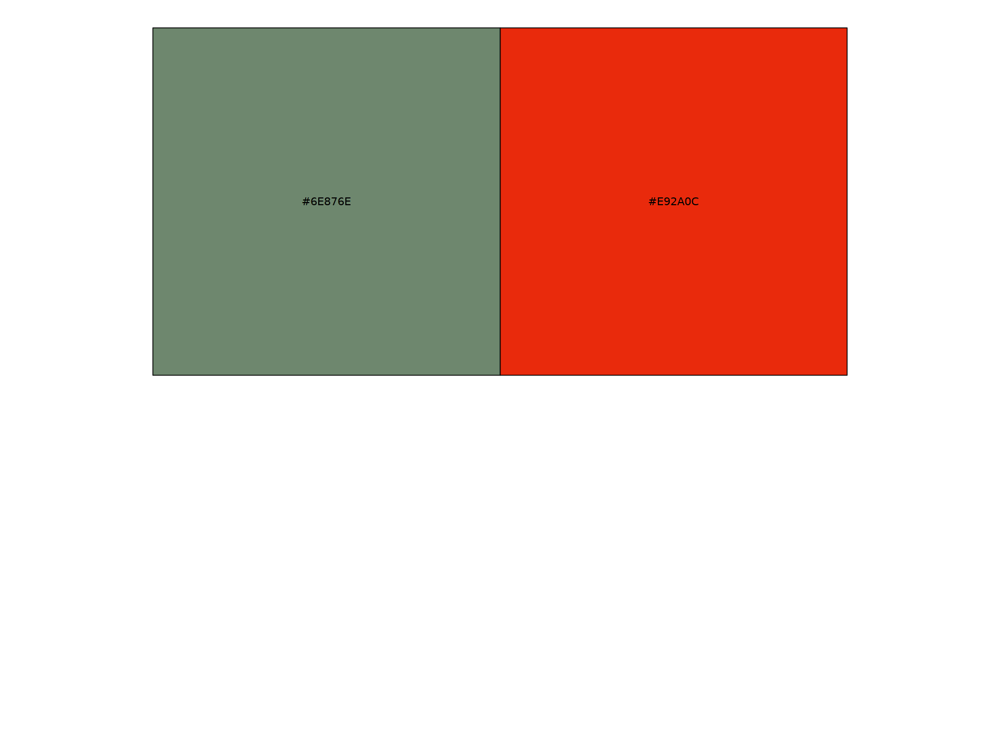

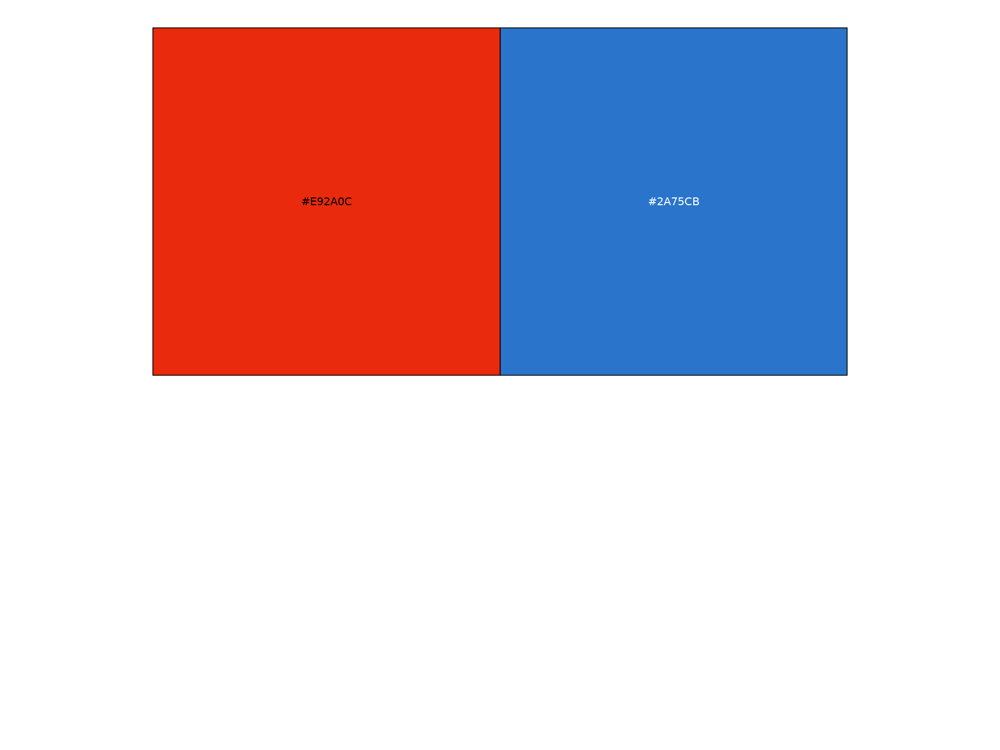

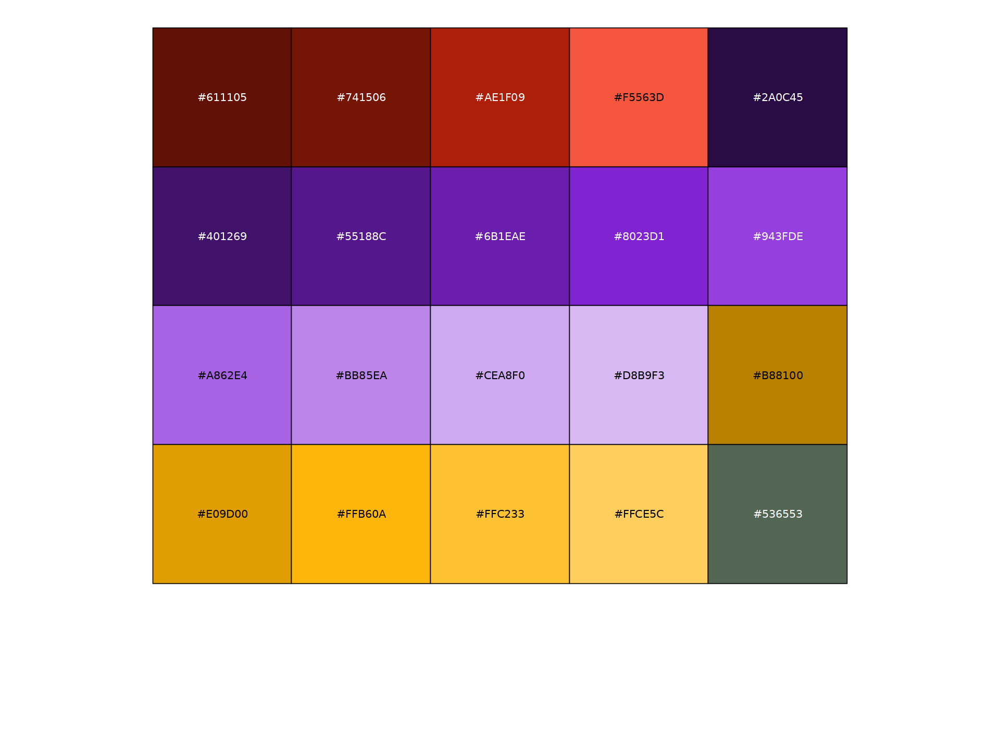

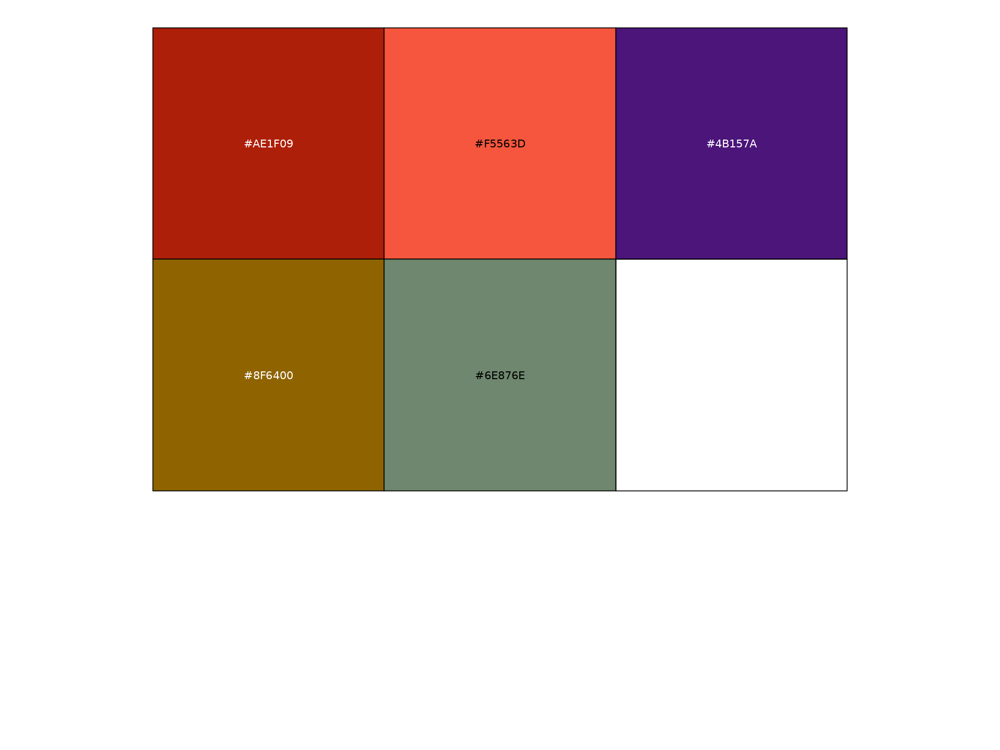

In [7]:
orig.ident_colors <- c("#2E382E", "#404F40", "#536553", "#657B65", "#789178", "#8FA38F", "#A5B6A5", "#D2DAD2", "#E9EDE9", 
                       "#7A5600", "#F5AB00", "#FFC233", "#FFD470", "#FFE7AD", "#FFF3D6",
                       "#AE1F09", "#E92A0C", "#F5563D", "#F88877", "#FDDDD8",
                       "#714947", "#97615E", "#B08482", "#C8A9A7", "#E0CECD", "#EFE7E6")
names(orig.ident_colors) <- c("EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3",
                              "Early1", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")

orig.ident_colors_contrast <- c("#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB", "#5B1865", "#E54F6D",
                                "#97615E", "#F5AB00", "#6E876E", "#26C485", "#C16200", "#2A75CB",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485",
                                "#97615E", "#E92A0C", "#F5AB00", "#6E876E", "#26C485", "#C16200")
names(orig.ident_colors_contrast) <- c("EarlyCtrl2", "EarlyCtrl3", "EarlyCtrl4", "EarlyCtrlMale5", "EarlyCtrlFemale5", "PeakCtrl2", "PeakCtrl3", "LateCtrl2", "LateCtrl3",
                              "Early1", "EarlyFemale3", "EarlyMale3", "Early4", "EarlyMale5", "EarlyFemale5",
                              "Peak2", "Peak3", "PeakMale4", "PeakFemale4", "Peak5",
                              "Late1", "Late2", "Late3", "LateMale4", "LateFemale4", "Late5")

orig.ident_merge_colors <- c("#6E876E", "#F5AB00", "#E92A0C", "#97615E")
names(orig.ident_merge_colors) <- c("Ctrl", "Early", "Peak", "Late")

batch_colors <- c("#2A75CB", "#6E876E", "#F5AB00", "#E92A0C", "#97615E", "#98CE00", "#E54F6D")
names(batch_colors) <- c("B1", "B2", "B3", "B4", "B5", "B6", "B8")

model_colors <- c("#6E876E", "#E92A0C")
names(model_colors) <- c("Ctrl", "EAE")
show_col(model_colors)

duo_colors <- c("#E92A0C", "#2A75CB")
show_col(duo_colors)

sex_colors <- duo_colors
names(sex_colors) <- c("F", "M")

immune_colors <- c("#A9DFBF", "#FF000080")
names(immune_colors) <- c("NonImmune", "Immune")
#show_col(immune_colors)

immuneAll_colors <- c("lightgrey", "blue", "orange", "red")
names(immuneAll_colors) <- c("None", "RNA", "GenePromAcc", "Both")
#show_col(immuneAll_colors)

doublets_colors <- c("#A9DFBF", "#FF000080")
names(doublets_colors) <- c("Singlet", "Doublet")
#show_col(doublets_colors)

debris_colors <- duo_colors
names(debris_colors) <- c("Percoll", "Debris")

date_tissue_coll_colors <- scales::viridis_pal()(17)
names(date_tissue_coll_colors) <- c('2021_04_30','2021_05_03','2021_05_31','2021_09_30','2021_10_06','2021_11_26','2022_03_09','2022_03_10','2022_08_03','2022_08_24','2023_01_23','2023_02_15','2023_03_22','2023_06_15','2023_06_14','2022_05_12','2022_05_16')
#show_col(date_tissue_coll_colors)

date_exp_colors <- scales::viridis_pal()(7)
names(date_exp_colors) <- c('2021_04_20','2021_09_22','2021_11_17','2022_01_31','2022_07_18','2023_01_09','2023_06_05')
#show_col(date_exp_colors)

EAE_score_mean_colors <- scales::viridis_pal()(7)
names(EAE_score_mean_colors) <- c(0,0.5,2,2.25,2.33,2.5,3)
#show_col(EAE_score_mean_colors)

cellType_OL_colors <- c("#611105", "#741506", "#AE1F09", "#F5563D", "#2A0C45","#401269","#55188C","#6B1EAE","#8023D1","#943FDE","#A862E4","#BB85EA","#CEA8F0","#D8B9F3","#B88100","#E09D00","#FFB60A","#FFC233","#FFCE5C","#536553")
names(cellType_OL_colors) <- c("OPC-α", "OPC-β", "OPC-γ", "COP", "MOL56-α","MOL56-β","MOL56-γ","MOL56-δ","MOL56-ε","MOL56-ζ","MOL56-η","MOL56-θ","MOL56-ι","MOL56-κ","MOL2-α","MOL2-β","MOL2-γ","MOL2-δ","MOL2-ε","MOL1")
show_col(cellType_OL_colors)

cellType_OL_merge_colors <- c("#AE1F09","#F5563D","#4B157A","#8F6400", "#6E876E")
names(cellType_OL_merge_colors) <- c("OPC", "COP", "MOL56", "MOL2", "MOL1")
show_col(cellType_OL_merge_colors)

In [8]:
#Set up ATAC annotation
annotations <- GetGRangesFromEnsDb(ensdb = EnsDb.Mmusculus.v79, verbose =FALSE)
ucsc.levels <- str_replace(string=paste("chr",seqlevels(annotations),sep=""), pattern="chrMT", replacement="chrM")
seqlevels(annotations) <- ucsc.levels
genome(annotations) <- "mm10"

Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warning message in .merge_two_Seqinfo_objects(x, y):
"The 2 combined objects have no sequence levels in common. (Use
  suppressWarnings() to suppress this warning.)"
Warn

## 2. Loading datasets

In [8]:
MORNAATACCOL <- readRDS(paste0(OS_path_outputs, "MORNAATACCOL_DORCs.rds"))

## 3. OL dynamics

### 3.1 Gene ontology (DGE)

In [13]:
DefaultAssay(MORNAATACCOL) <- "RNA"

In [14]:
ensembl = useMart("ensembl",dataset="mmusculus_gene_ensembl")
attributes = listAttributes(ensembl)
Biomart_gencode_ensembl84_biotypes <- getBM(attributes=c("mgi_symbol","ensembl_gene_id","entrezgene_id","gene_biotype"), filters = "", values = "", ensembl)
Biomart_gencode_ensembl84_biotypes[, 'gene_biotype'] <- as.factor(Biomart_gencode_ensembl84_biotypes[,'gene_biotype'])

In [15]:
#Filter for only our genes
Biotype_All_dataset <- subset(Biomart_gencode_ensembl84_biotypes, mgi_symbol %in% rownames(MORNAATACCOL))
entrezID <- subset(Biotype_All_dataset, Biotype_All_dataset$mgi_symbol %in% rownames(MORNAATACCOL))

In [16]:
threshold_nb_genes <- 50

#### 3.1.1 MOL56

In [17]:
df_dynamics <- readRDS(paste0(OS_path_outputs, "Dynamics_DGE_RNA_MOL56.rds"))

In [18]:
df_dynamics_scaled <- df_dynamics/do.call(pmax, df_dynamics)

##### Category 1

In [19]:
highest_cat <- "Ctrl"

In [20]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [21]:
length(gene_list)

[1] 235

In [22]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [23]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [24]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [25]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [26]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [27]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [28]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [29]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:35] "18109" "14451" "68483" "14013" "320352" "12767" "12300" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [30]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [31]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:35] "18109" "14451" "68483" "14013" "320352" "12767" "12300" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...59 enriched terms found
'data.frame':	59 obs. of  9 variables:
 $ ID         : chr  "R-MMU-2129379" "R-MMU-1566948" "R-MMU-76002" "R-MMU-114608" ...
 $ Description: chr  "Molecules associated with elastic fibres" "Elastic fibre formation" "Platelet activation, signaling and aggregation" "Platelet degranulation" ...
 $ GeneRatio  : chr  "2/15" "2/15" "3/15" "2/15" ...
 $ BgRatio    : chr  "32/8582" "39/8582" "246/8582" "117/8582" ...
 $ pvalue     : num  0.00137 0.00204 0.0082 0.01723 0.01735 ...
 $ p.adjust   : num  0.06 0.06 0.139 0.139 0.139 ...
 $ qvalue     : num  0.0429 0.0429 0.099 0.099 0.099 ...
 $ geneID     : chr  "Ltbp4/Fbn2" "Ltbp4/Fbn2" "Dgkg/Vegfa/Maged2" "Vegfa/Maged2" ...
 $ Count      : int  2 2 3 2 1 2 1 1 1 2 ...
#...Citation
  Guan

In [169]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,".csv"), row.names=FALSE)

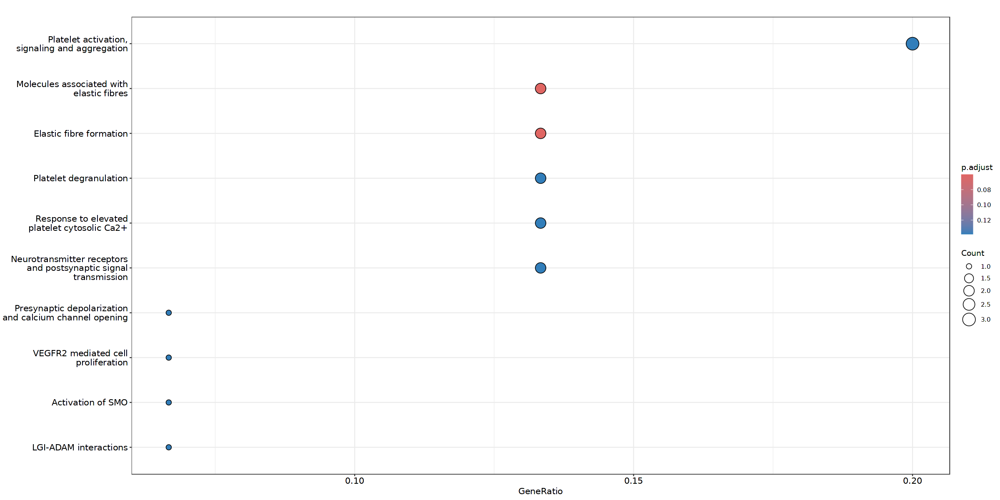

In [60]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [33]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

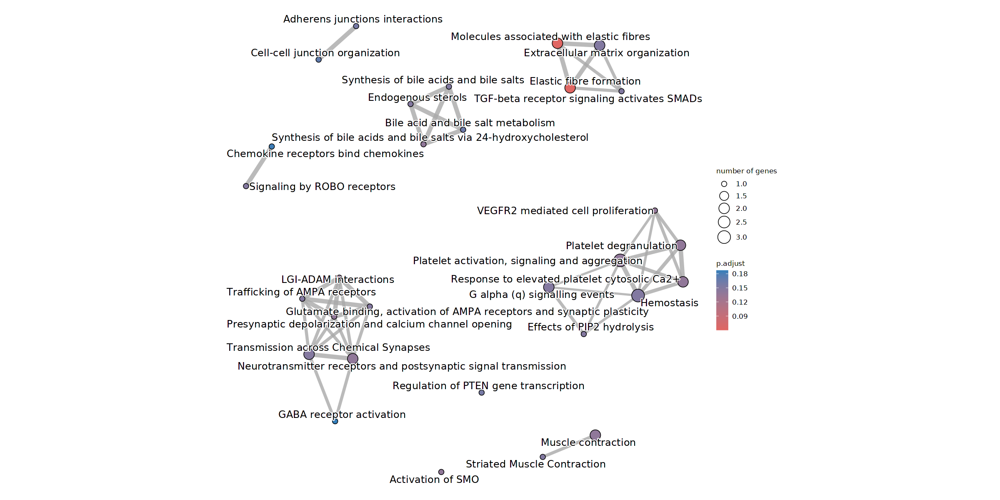

In [34]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Category 2

In [173]:
highest_cat <- "Early"

In [174]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [175]:
length(gene_list)

[1] 601

In [176]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [177]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [178]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [179]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [180]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [181]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [182]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [183]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:49] "20306" "102639906" "114332" "231655" "238393" "14469" "14161" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...12 enriched terms found
'data.frame':	12 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1280215" "R-MMU-913531" "R-MMU-8957275" "R-MMU-381426" ...
 $ Description: chr  "Cytokine Signaling in Immune system" "Interferon Signaling" "Post-translational protein phosphorylation" "Regulation of Insulin-like Growth Factor (IGF) transport and uptake by Insulin-like Growth Factor Binding Proteins (IGFBPs)" ...
 $ GeneRatio  : chr  "9/28" "5/28" "4/28" "4/28" ...
 $ BgRatio    : chr  "447/8582" "131/8582" "114/8582" "120/8582" ...
 $ pvalue     : num  7.40e-06 5.69e-05 4.73e-04 5.74e-04 6.64e-04 ...
 $ p.adjust   : num  0.000859 0.003301 0.015405 0.015405 0.015405 ...
 $ qvalue     : num  0.000647 0.002486 0.011602 0.011602 0.011602 ...
 $ geneID    

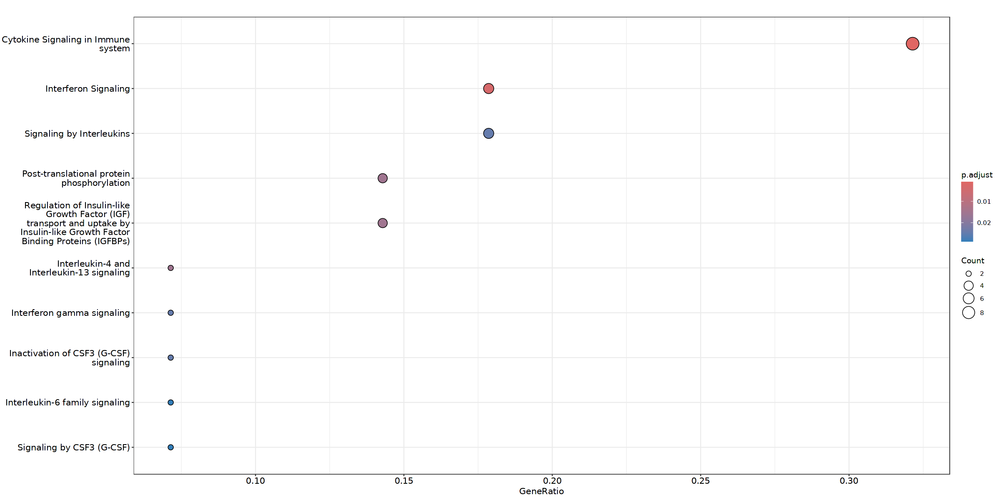

In [184]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [185]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

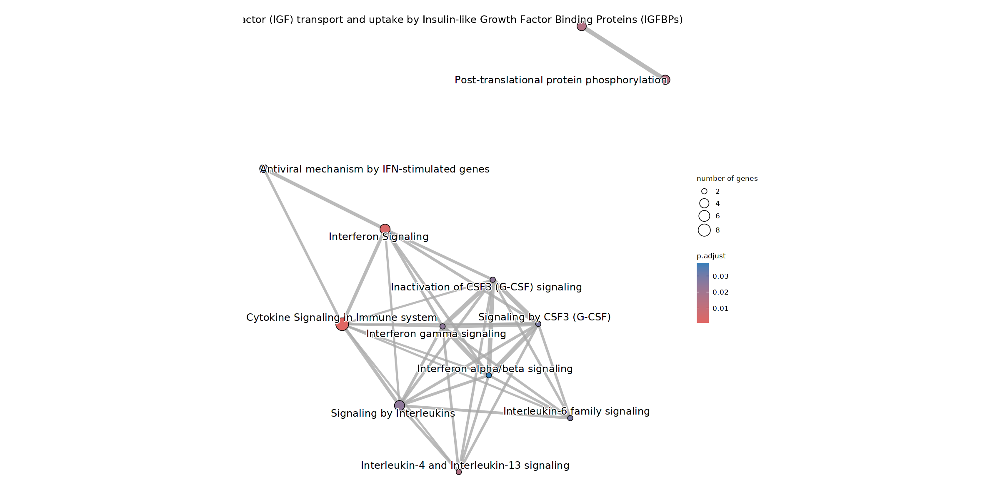

In [186]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [187]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [188]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:49] "20306" "102639906" "114332" "231655" "238393" "14469" "14161" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...116 enriched terms found
'data.frame':	116 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1280215" "R-MMU-913531" "R-MMU-8957275" "R-MMU-381426" ...
 $ Description: chr  "Cytokine Signaling in Immune system" "Interferon Signaling" "Post-translational protein phosphorylation" "Regulation of Insulin-like Growth Factor (IGF) transport and uptake by Insulin-like Growth Factor Binding Proteins (IGFBPs)" ...
 $ GeneRatio  : chr  "9/28" "5/28" "4/28" "4/28" ...
 $ BgRatio    : chr  "447/8582" "131/8582" "114/8582" "120/8582" ...
 $ pvalue     : num  7.40e-06 5.69e-05 4.73e-04 5.74e-04 6.64e-04 ...
 $ p.adjust   : num  0.000859 0.003301 0.015405 0.015405 0.015405 ...
 $ qvalue     : num  0.000647 0.002486 0.011602 0.011602 0.011602 ...
 $ geneID     

In [189]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,".csv"), row.names=FALSE)

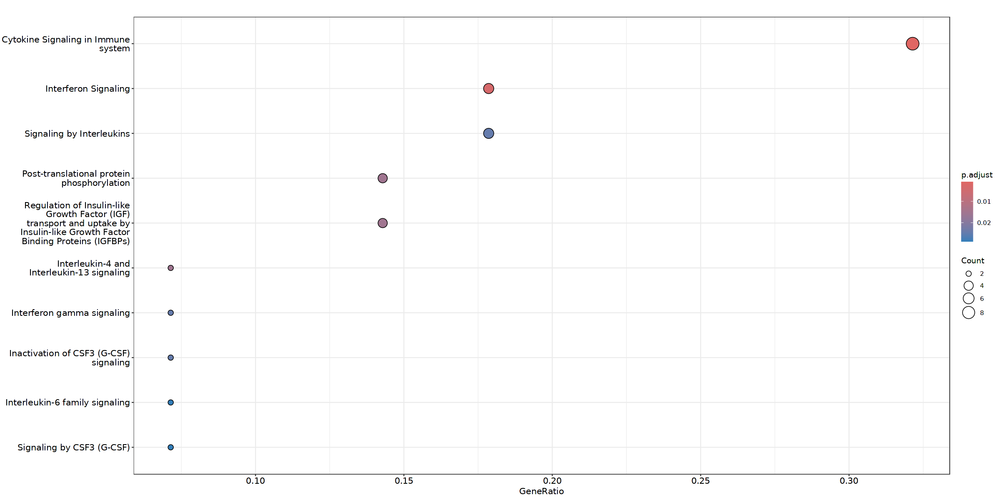

In [190]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [191]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

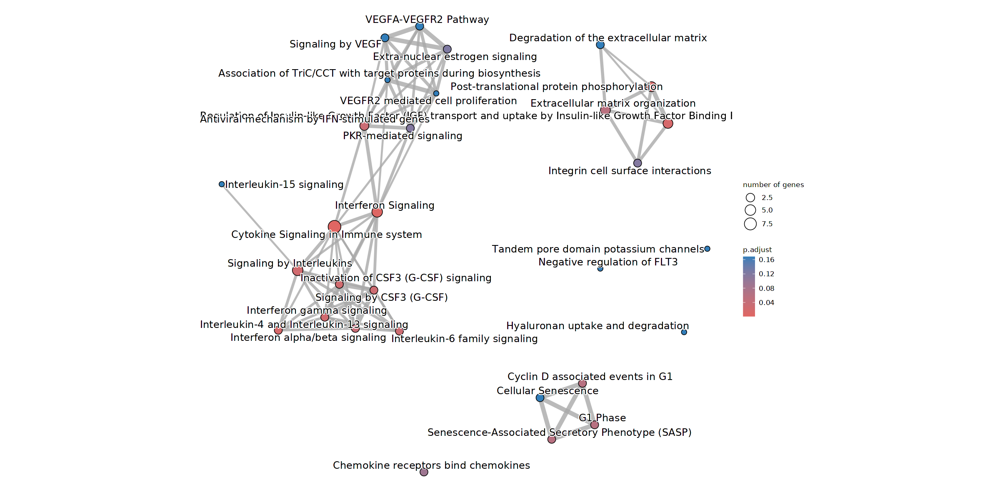

In [192]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Category 3

In [193]:
highest_cat <- "Peak"

In [194]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [195]:
length(gene_list)

[1] 900

In [196]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [197]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [198]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [199]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [200]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [201]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [202]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [203]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:44] "223672" "71898" "56708" "626578" "15953" "23960" "330890" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...108 enriched terms found
'data.frame':	108 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-983169" "R-MMU-1236974" "R-MMU-983170" ...
 $ Description: chr  "Antigen processing-Cross presentation" "Class I MHC mediated antigen processing & presentation" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "5/15" "6/15" "3/15" "3/15" ...
 $ BgRatio    : chr  "91/8582" "342/8582" "33/8582" "40/8582" ...
 $ pvalue     : num  3.31e-07 1.41e-05 2.28e-05 4.11e-05 4.29e-04 ...
 $ p.adjust   : num  4.67e-05 9.97e-04 1.07e-03 1.45e-03 1.21e-02 ...
 $ qvalue     : num  1.01e-05 2.16e-04 2.32e-04 3.13e-04 2.62e-03 ...
 $ geneID     : chr  "Psmb9/Psmb8/Tap1/H2-Q7/H2-Q4" "

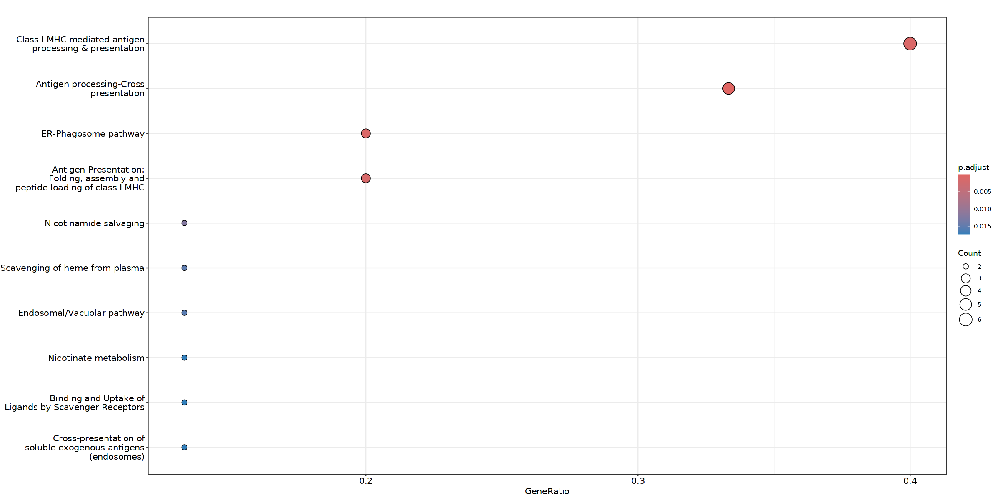

In [204]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [205]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 17 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


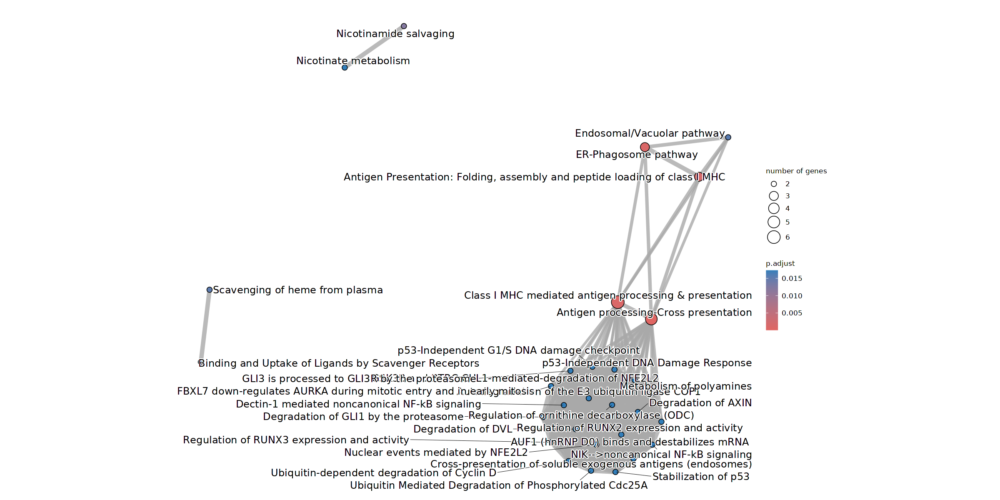

In [206]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [207]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [208]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:44] "223672" "71898" "56708" "626578" "15953" "23960" "330890" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...141 enriched terms found
'data.frame':	141 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-983169" "R-MMU-1236974" "R-MMU-983170" ...
 $ Description: chr  "Antigen processing-Cross presentation" "Class I MHC mediated antigen processing & presentation" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "5/15" "6/15" "3/15" "3/15" ...
 $ BgRatio    : chr  "91/8582" "342/8582" "33/8582" "40/8582" ...
 $ pvalue     : num  3.31e-07 1.41e-05 2.28e-05 4.11e-05 4.29e-04 ...
 $ p.adjust   : num  4.67e-05 9.97e-04 1.07e-03 1.45e-03 1.21e-02 ...
 $ qvalue     : num  1.01e-05 2.16e-04 2.32e-04 3.13e-04 2.62e-03 ...
 $ geneID     : chr  "Psmb9/Psmb8/Tap1/H2-Q7/H2-Q4" "Psm

In [209]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,".csv"), row.names=FALSE)

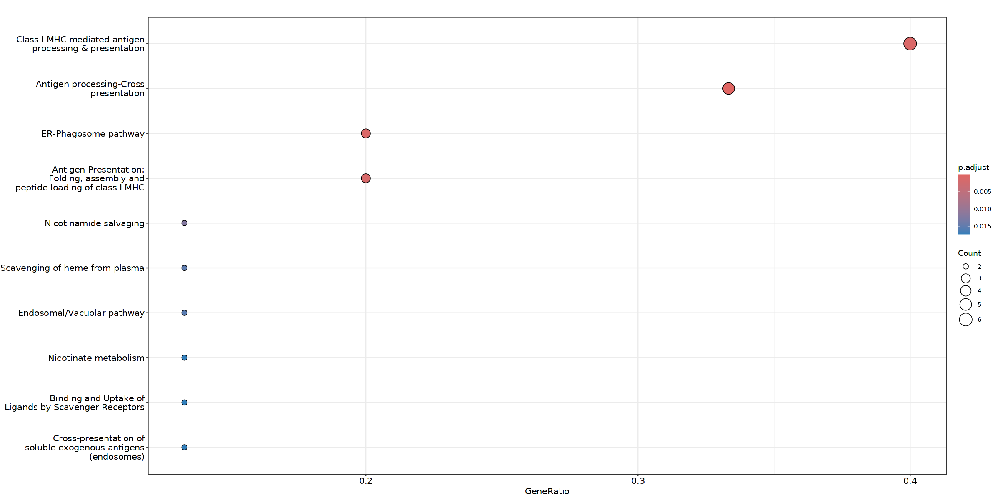

In [210]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [211]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 18 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


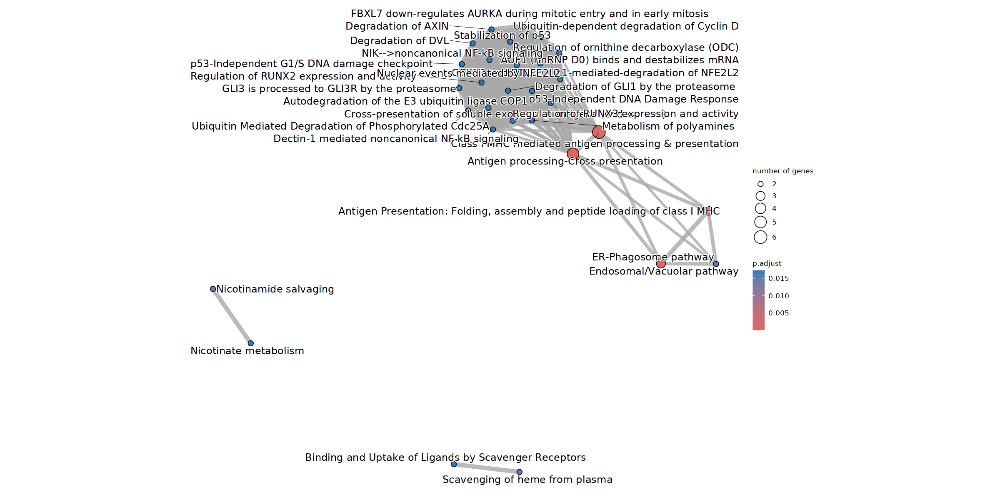

In [212]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Category 4

In [213]:
highest_cat <- "Late"

In [214]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [215]:
length(gene_list)

[1] 990

In [216]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [217]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [218]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [219]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [220]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [221]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [222]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [223]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:45] "12833" "668303" "19683" "240332" "17313" "259277" "21943" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...16 enriched terms found
'data.frame':	16 obs. of  9 variables:
 $ ID         : chr  "R-MMU-5669034" "R-MMU-8948216" "R-MMU-1474228" "R-MMU-1442490" ...
 $ Description: chr  "TNFs bind their physiological receptors" "Collagen chain trimerization" "Degradation of the extracellular matrix" "Collagen degradation" ...
 $ GeneRatio  : chr  "3/19" "3/19" "4/19" "3/19" ...
 $ BgRatio    : chr  "25/8582" "35/8582" "106/8582" "55/8582" ...
 $ pvalue     : num  2.05e-05 5.76e-05 7.39e-05 2.24e-04 2.91e-04 ...
 $ p.adjust   : num  0.00213 0.00256 0.00256 0.00584 0.00605 ...
 $ qvalue     : num  0.00153 0.00184 0.00184 0.00419 0.00435 ...
 $ geneID     : chr  "Tnfsf11/Tnfrsf1b/Tnfrsf1a" "Col6a1/Col13a1/Col6a2" "Col6a1/Col13a1/Col6a2/Scube3" "Col6a1/Col13a1/Co

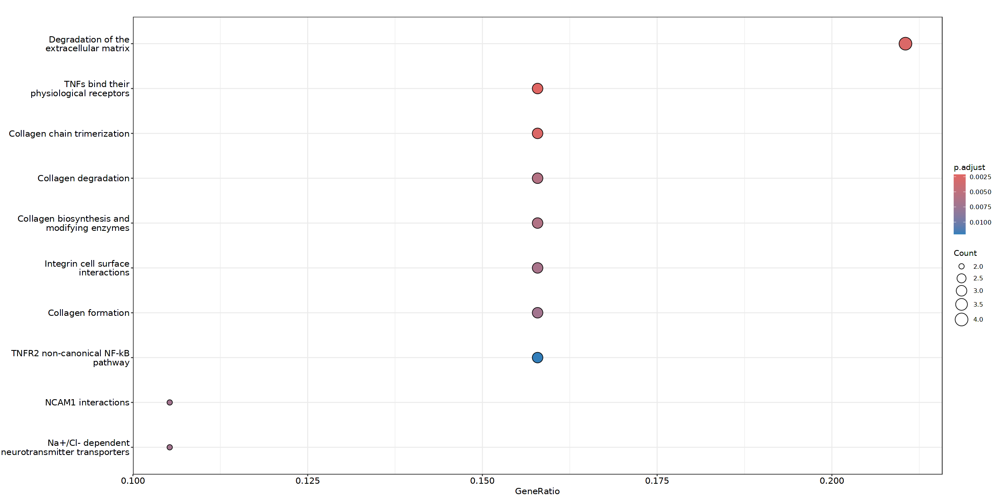

In [224]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [225]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

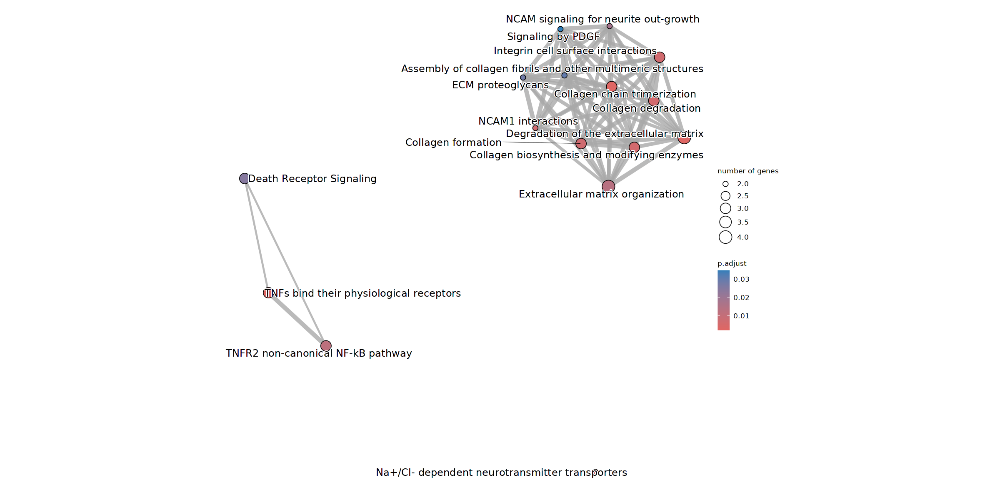

In [226]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [227]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [228]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:45] "12833" "668303" "19683" "240332" "17313" "259277" "21943" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...104 enriched terms found
'data.frame':	104 obs. of  9 variables:
 $ ID         : chr  "R-MMU-5669034" "R-MMU-8948216" "R-MMU-1474228" "R-MMU-1442490" ...
 $ Description: chr  "TNFs bind their physiological receptors" "Collagen chain trimerization" "Degradation of the extracellular matrix" "Collagen degradation" ...
 $ GeneRatio  : chr  "3/19" "3/19" "4/19" "3/19" ...
 $ BgRatio    : chr  "25/8582" "35/8582" "106/8582" "55/8582" ...
 $ pvalue     : num  2.05e-05 5.76e-05 7.39e-05 2.24e-04 2.91e-04 ...
 $ p.adjust   : num  0.00213 0.00256 0.00256 0.00584 0.00605 ...
 $ qvalue     : num  0.00153 0.00184 0.00184 0.00419 0.00435 ...
 $ geneID     : chr  "Tnfsf11/Tnfrsf1b/Tnfrsf1a" "Col6a1/Col13a1/Col6a2" "Col6a1/Col13a1/Col6a2/Scube3" "Col6a1/Col13a1/Col

In [229]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,".csv"), row.names=FALSE)

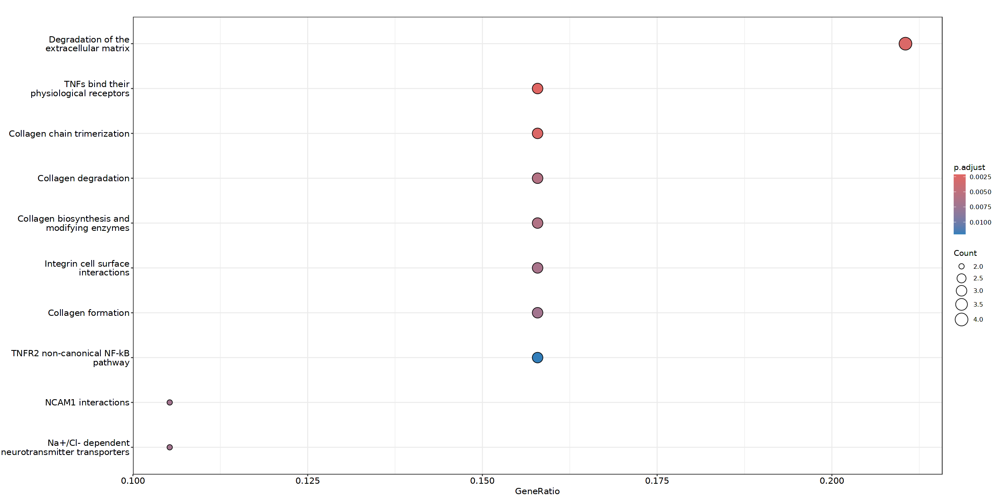

In [230]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [231]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 5 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


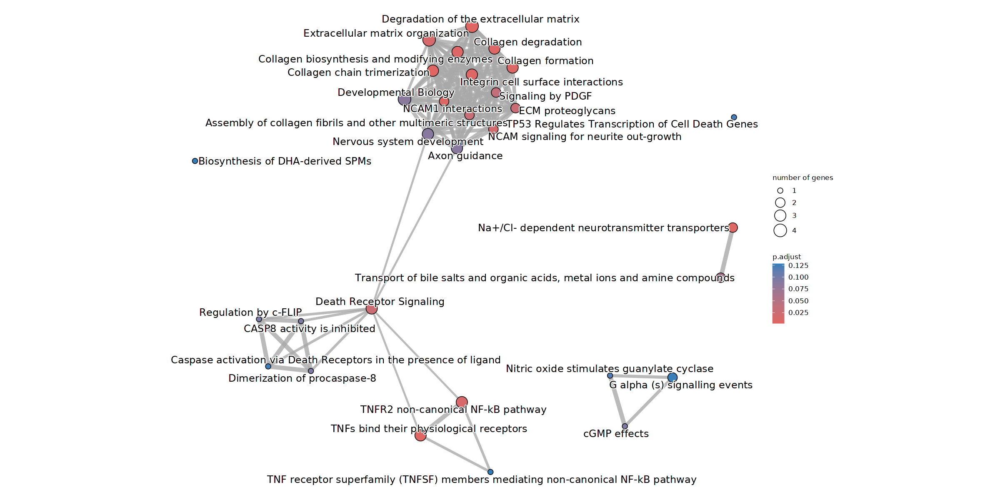

In [232]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 1

In [233]:
highest_cat <- "Ctrl"
second_highest_cat <- "Early"

In [234]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [235]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [236]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [237]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [238]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [239]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [240]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [241]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [242]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [243]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [244]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [245]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:28] "14451" "12300" "22141" "14038" "110197" "241134" "55987" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...1 enriched terms found
'data.frame':	1 obs. of  9 variables:
 $ ID         : chr "R-MMU-499943"
 $ Description: chr "Interconversion of nucleotide di- and triphosphates"
 $ GeneRatio  : chr "2/10"
 $ BgRatio    : chr "27/8582"
 $ pvalue     : num 0.000422
 $ p.adjust   : num 0.0253
 $ qvalue     : num 0.0164
 $ geneID     : chr "Dut/Ak4"
 $ Count      : int 2
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


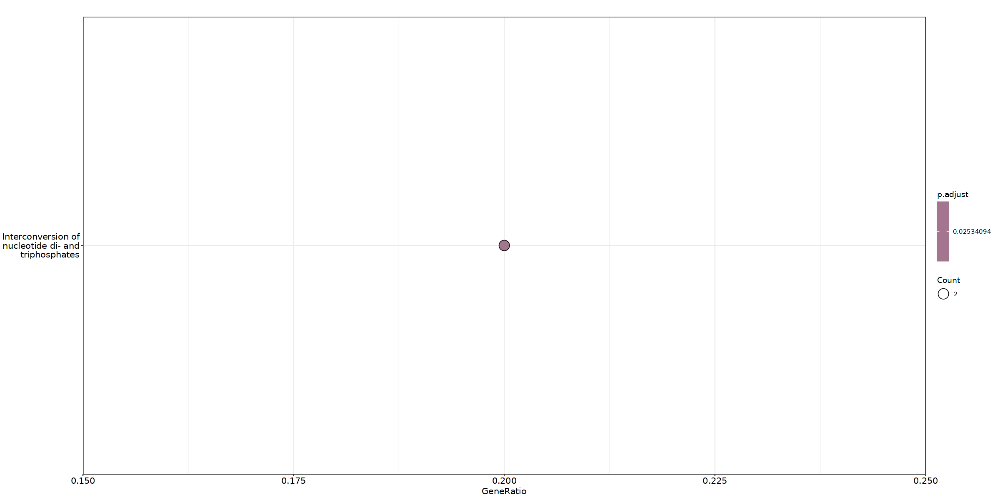

In [246]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [247]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

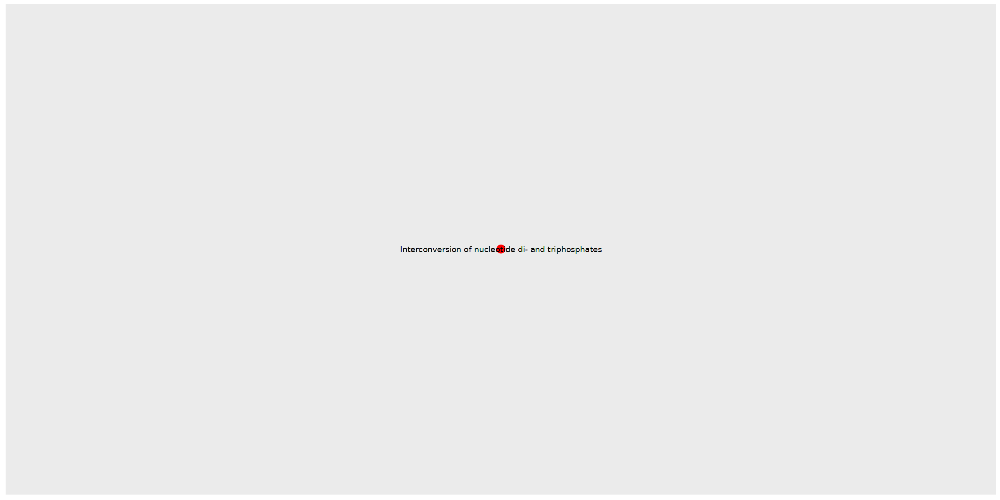

In [248]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [249]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [250]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:28] "14451" "12300" "22141" "14038" "110197" "241134" "55987" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...60 enriched terms found
'data.frame':	60 obs. of  9 variables:
 $ ID         : chr  "R-MMU-499943" "R-MMU-15869" "R-MMU-112308" "R-MMU-1250347" ...
 $ Description: chr  "Interconversion of nucleotide di- and triphosphates" "Metabolism of nucleotides" "Presynaptic depolarization and calcium channel opening" "SHC1 events in ERBB4 signaling" ...
 $ GeneRatio  : chr  "2/10" "2/10" "1/10" "1/10" ...
 $ BgRatio    : chr  "27/8582" "94/8582" "10/8582" "11/8582" ...
 $ pvalue     : num  0.000422 0.005045 0.011597 0.01275 0.01275 ...
 $ p.adjust   : num  0.0253 0.0744 0.0744 0.0744 0.0744 ...
 $ qvalue     : num  0.0164 0.0483 0.0483 0.0483 0.0483 ...
 $ geneID     : chr  "Dut/Ak4" "Dut/Ak4" "Cacng2" "Btc" ...
 $ Count      : int  2 2 1 1 1 1 1 1 1 1 ...
#...

In [251]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

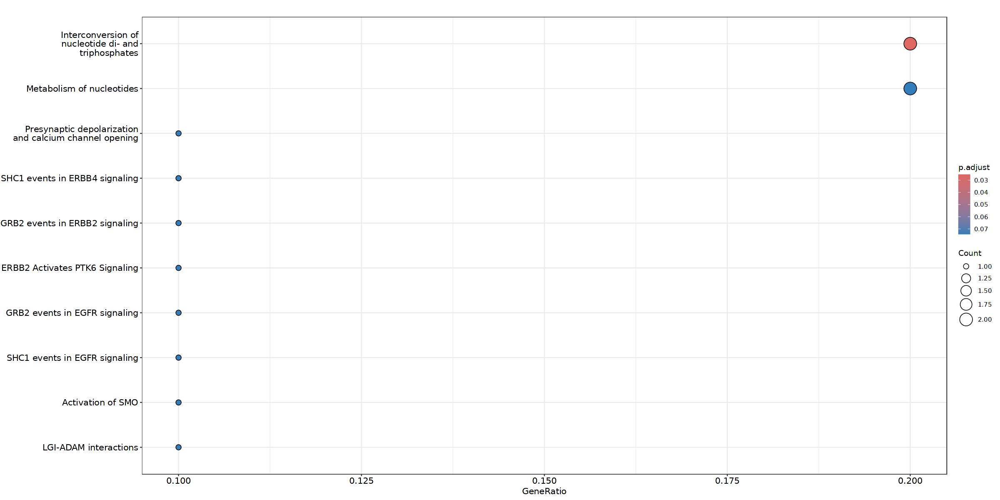

In [252]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [253]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 16 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


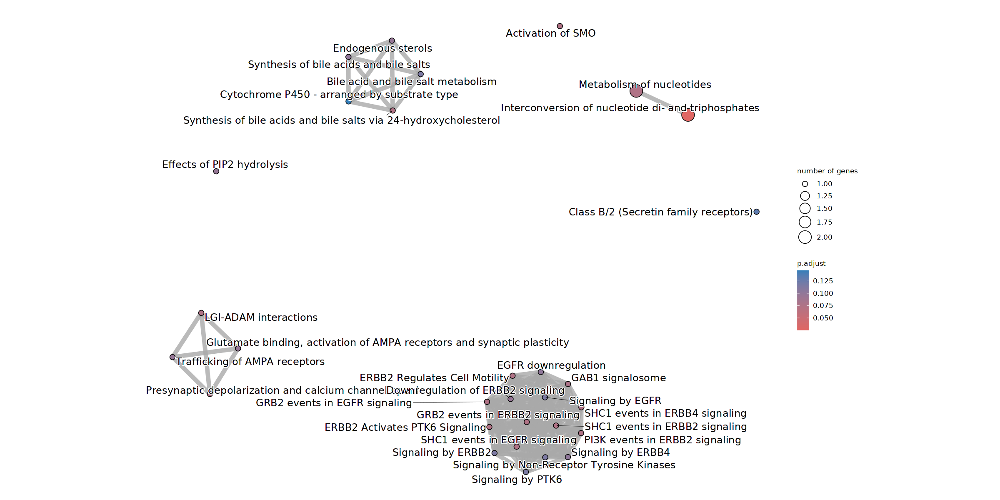

In [254]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 2

In [255]:
highest_cat <- "Ctrl"
second_highest_cat <- "Peak"

In [256]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [257]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [258]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [259]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [260]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [261]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [262]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [263]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [264]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [265]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [266]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [267]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:7] "16416" "22151" "245038" "68753" "100043571" "98402" "74466"
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...40 enriched terms found
'data.frame':	40 obs. of  9 variables:
 $ ID         : chr  "R-MMU-373760" "R-MMU-422475" "R-MMU-9675108" "R-MMU-210990" ...
 $ Description: chr  "L1CAM interactions" "Axon guidance" "Nervous system development" "PECAM1 interactions" ...
 $ GeneRatio  : chr  "2/3" "2/3" "2/3" "1/3" ...
 $ BgRatio    : chr  "63/8582" "249/8582" "250/8582" "12/8582" ...
 $ pvalue     : num  0.000158 0.002467 0.002487 0.004189 0.005235 ...
 $ p.adjust   : num  0.0135 0.0424 0.0424 0.0424 0.0424 ...
 $ qvalue     : num  0.0035 0.011 0.011 0.011 0.011 ...
 $ geneID     : chr  "Itgb3/Tubb2a" "Itgb3/Tubb2a" "Itgb3/Tubb2a" "Itgb3" ...
 $ Count      : int  2 2 2 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor

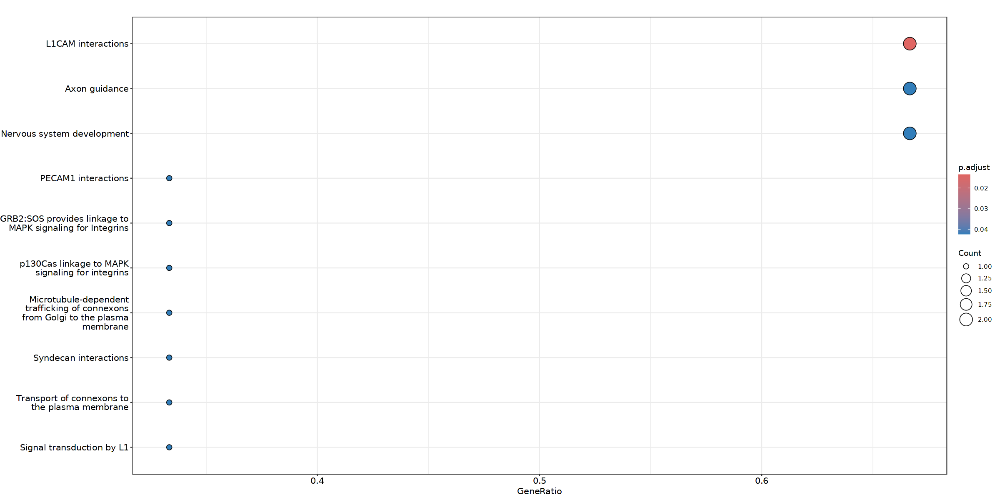

In [268]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [269]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

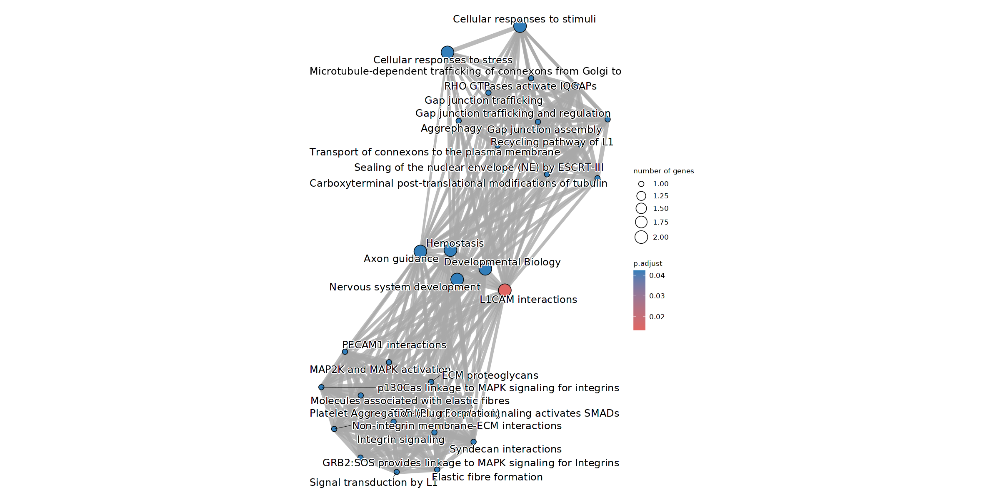

In [270]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [271]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [272]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:7] "16416" "22151" "245038" "68753" "100043571" "98402" "74466"
#...pvalues adjusted by 'fdr' with cutoff <1 
#...85 enriched terms found
'data.frame':	85 obs. of  9 variables:
 $ ID         : chr  "R-MMU-373760" "R-MMU-422475" "R-MMU-9675108" "R-MMU-210990" ...
 $ Description: chr  "L1CAM interactions" "Axon guidance" "Nervous system development" "PECAM1 interactions" ...
 $ GeneRatio  : chr  "2/3" "2/3" "2/3" "1/3" ...
 $ BgRatio    : chr  "63/8582" "249/8582" "250/8582" "12/8582" ...
 $ pvalue     : num  0.000158 0.002467 0.002487 0.004189 0.005235 ...
 $ p.adjust   : num  0.0135 0.0424 0.0424 0.0424 0.0424 ...
 $ qvalue     : num  0.0035 0.011 0.011 0.011 0.011 ...
 $ geneID     : chr  "Itgb3/Tubb2a" "Itgb3/Tubb2a" "Itgb3/Tubb2a" "Itgb3" ...
 $ Count      : int  2 2 2 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor pa

In [273]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

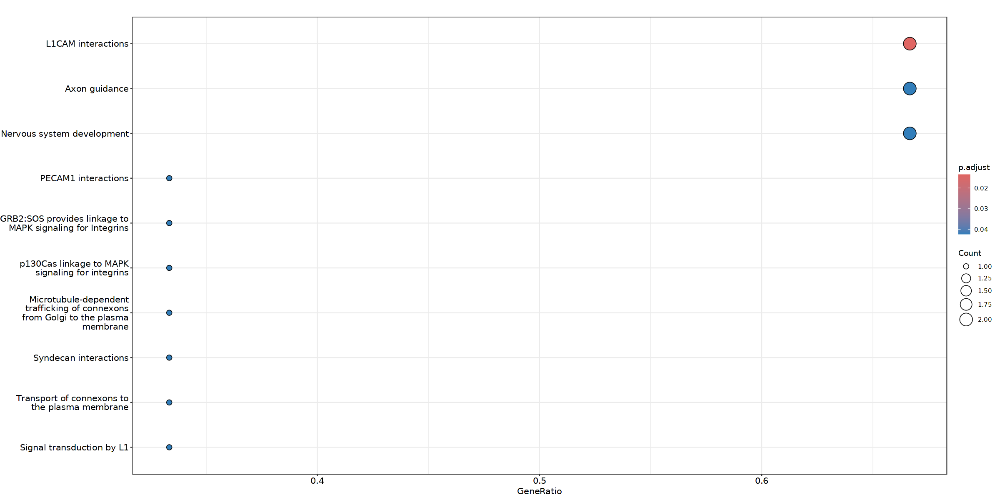

In [274]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [275]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

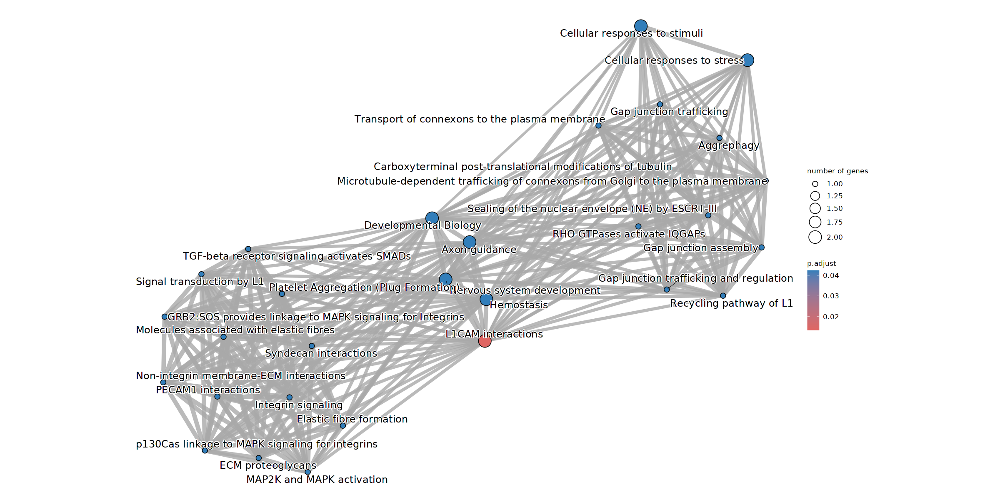

In [276]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 3

In [277]:
highest_cat <- "Ctrl"
second_highest_cat <- "Late"

In [278]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [279]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [280]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [281]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [282]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [283]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [284]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [285]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [286]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [287]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [288]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [289]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:43] "18109" "68483" "14013" "320352" "12767" "229357" "17883" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [290]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [291]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:43] "18109" "68483" "14013" "320352" "12767" "229357" "17883" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...63 enriched terms found
'data.frame':	63 obs. of  9 variables:
 $ ID         : chr  "R-MMU-2129379" "R-MMU-1566948" "R-MMU-5173105" "R-MMU-193692" ...
 $ Description: chr  "Molecules associated with elastic fibres" "Elastic fibre formation" "O-linked glycosylation" "Regulated proteolysis of p75NTR" ...
 $ GeneRatio  : chr  "2/16" "2/16" "2/16" "1/16" ...
 $ BgRatio    : chr  "32/8582" "39/8582" "97/8582" "10/8582" ...
 $ pvalue     : num  0.00156 0.00232 0.01369 0.0185 0.01952 ...
 $ p.adjust   : num  0.0731 0.0731 0.1626 0.1626 0.1626 ...
 $ qvalue     : num  0.0598 0.0598 0.1331 0.1331 0.1331 ...
 $ geneID     : chr  "Ltbp4/Fbn2" "Ltbp4/Fbn2" "Thbs2/Chst4" "Ngfr" ...
 $ Count      : int  2 2 2 1 2 2 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Y

In [292]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

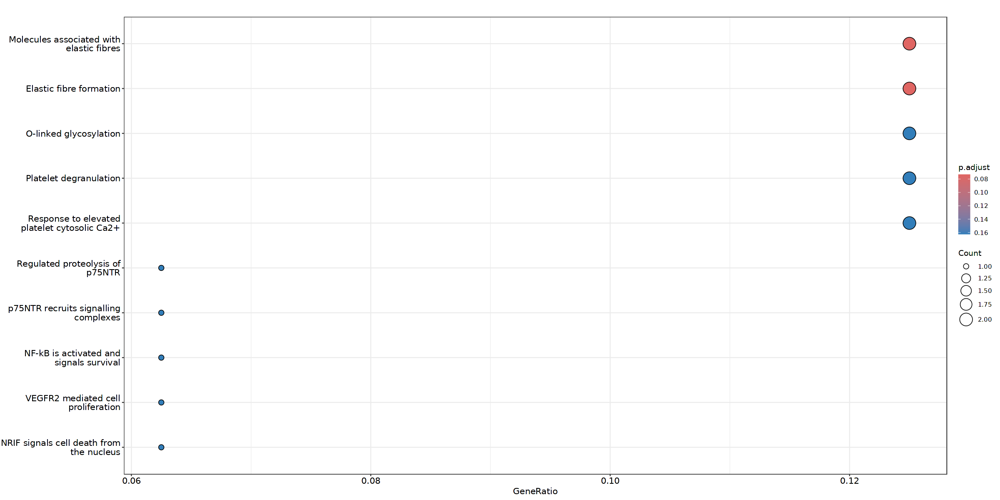

In [293]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [294]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

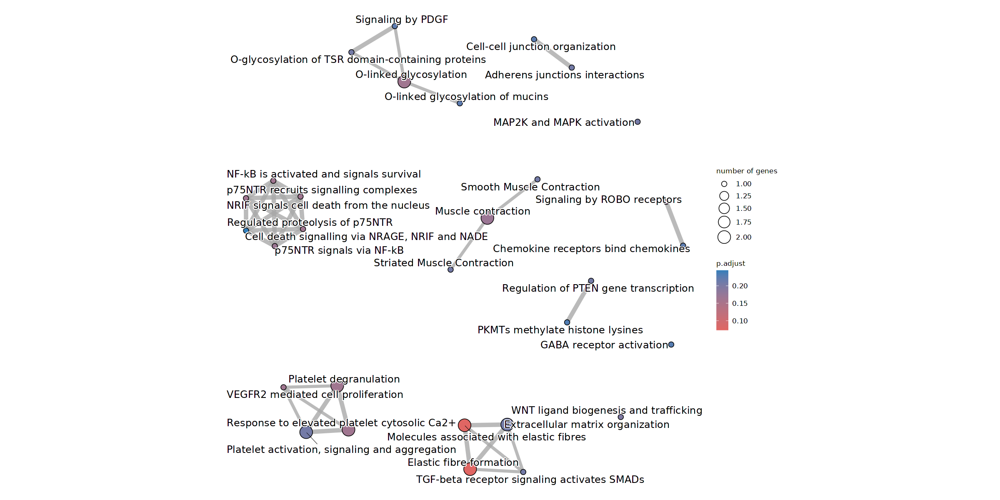

In [295]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 4

In [296]:
highest_cat <- "Early"
second_highest_cat <- "Ctrl"

In [297]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [298]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [299]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [300]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [301]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [302]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [303]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [304]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [305]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [306]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [307]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [308]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:42] "100042277" "16542" "384061" "18612" "24066" "64339" "53896" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...2 enriched terms found
'data.frame':	2 obs. of  9 variables:
 $ ID         : chr  "R-MMU-191273" "R-MMU-8957322"
 $ Description: chr  "Cholesterol biosynthesis" "Metabolism of steroids"
 $ GeneRatio  : chr  "4/23" "4/23"
 $ BgRatio    : chr  "27/8582" "126/8582"
 $ pvalue     : num  6.61e-07 3.16e-04
 $ p.adjust   : num  7.53e-05 1.80e-02
 $ qvalue     : num  5.91e-05 1.41e-02
 $ geneID     : chr  "Idi1/Sqle/Fdps/Msmo1" "Idi1/Sqle/Fdps/Msmo1"
 $ Count      : int  4 4
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


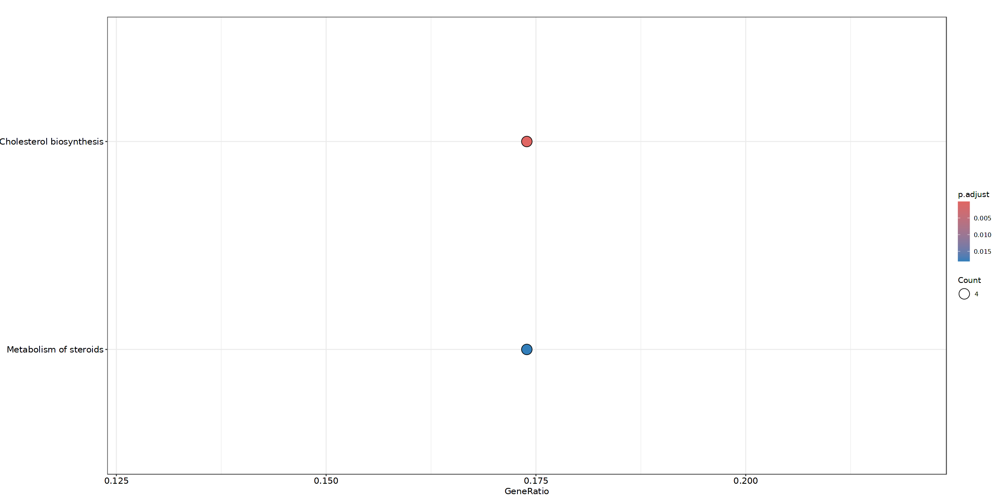

In [309]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [310]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

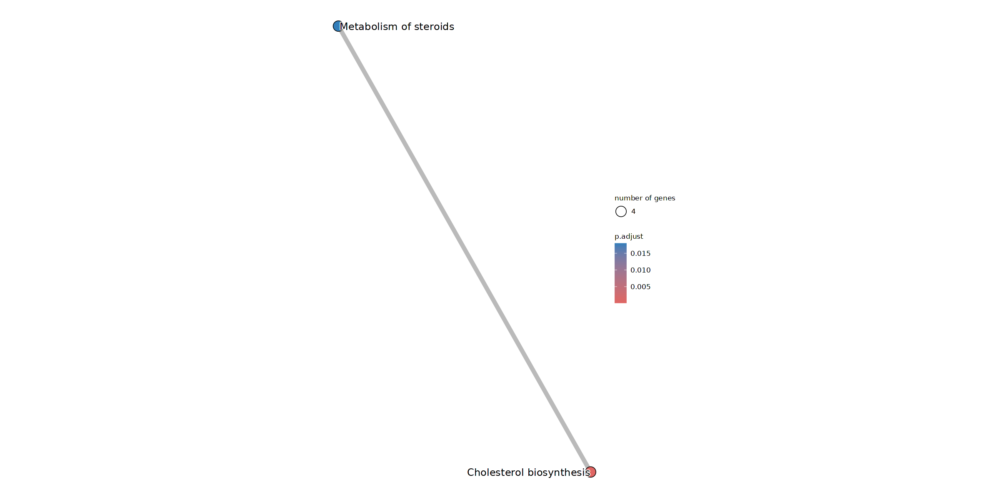

In [311]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [312]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [313]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:42] "100042277" "16542" "384061" "18612" "24066" "64339" "53896" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...114 enriched terms found
'data.frame':	114 obs. of  9 variables:
 $ ID         : chr  "R-MMU-191273" "R-MMU-8957322" "R-MMU-352230" "R-MMU-69231" ...
 $ Description: chr  "Cholesterol biosynthesis" "Metabolism of steroids" "Amino acid transport across the plasma membrane" "Cyclin D associated events in G1" ...
 $ GeneRatio  : chr  "4/23" "4/23" "2/23" "2/23" ...
 $ BgRatio    : chr  "27/8582" "126/8582" "30/8582" "42/8582" ...
 $ pvalue     : num  6.61e-07 3.16e-04 2.86e-03 5.54e-03 5.54e-03 ...
 $ p.adjust   : num  7.53e-05 1.80e-02 1.09e-01 1.26e-01 1.26e-01 ...
 $ qvalue     : num  5.91e-05 1.41e-02 8.52e-02 9.92e-02 9.92e-02 ...
 $ geneID     : chr  "Idi1/Sqle/Fdps/Msmo1" "Idi1/Sqle/Fdps/Msmo1" "Slc7a10/Slc38a1" "Lyn/Ccnd1" ...
 $ Count      :

In [314]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

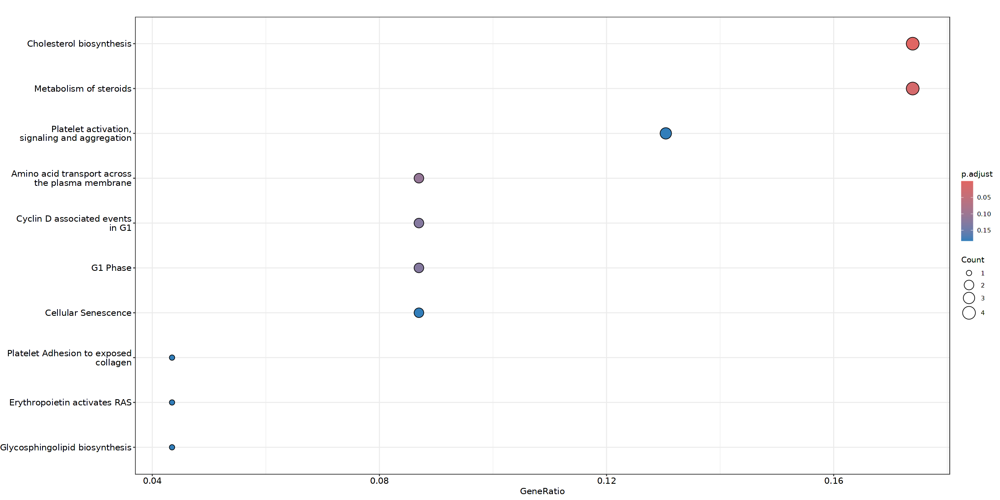

In [315]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [316]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 5 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


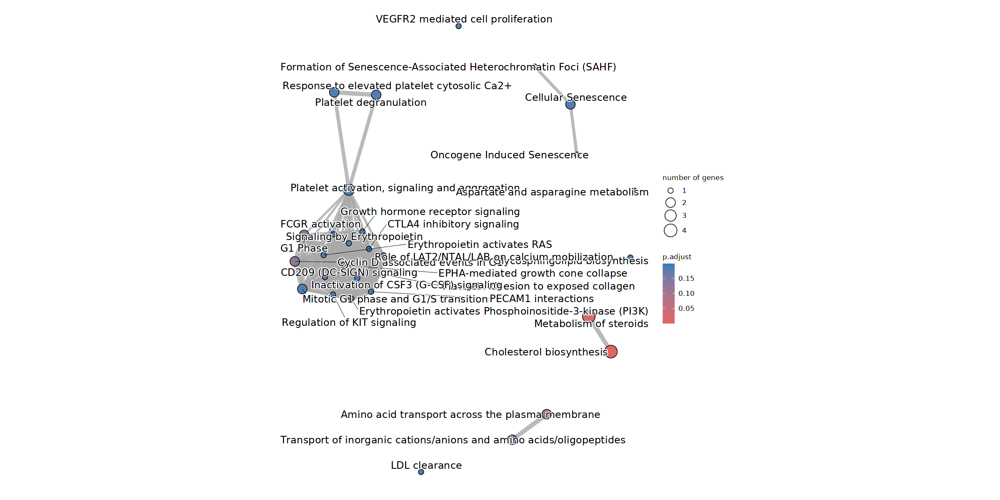

In [317]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 5

In [318]:
highest_cat <- "Early"
second_highest_cat <- "Peak"

In [319]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [320]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [321]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [322]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [323]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [324]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [325]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [326]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [327]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [328]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [329]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [330]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:48] "20306" "238393" "14469" "100038882" "75750" "237886" "22169" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [331]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [332]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:48] "20306" "238393" "14469" "100038882" "75750" "237886" "22169" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...171 enriched terms found
'data.frame':	171 obs. of  9 variables:
 $ ID         : chr  "R-MMU-2559582" "R-MMU-913531" "R-MMU-69231" "R-MMU-69236" ...
 $ Description: chr  "Senescence-Associated Secretory Phenotype (SASP)" "Interferon Signaling" "Cyclin D associated events in G1" "G1 Phase" ...
 $ GeneRatio  : chr  "2/25" "3/25" "2/25" "2/25" ...
 $ BgRatio    : chr  "39/8582" "131/8582" "42/8582" "42/8582" ...
 $ pvalue     : num  0.00565 0.00625 0.00653 0.00653 0.00838 ...
 $ p.adjust   : num  0.27 0.27 0.27 0.27 0.27 ...
 $ qvalue     : num  0.236 0.236 0.236 0.236 0.236 ...
 $ geneID     : chr  "Cdkn1a/Cdk6" "Isg15/Socs1/Tubb6" "Cdkn1a/Cdk6" "Cdkn1a/Cdk6" ...
 $ Count      : int  2 3 2 2 5 2 2 2 2 2 ...
#...Citation
  Guangchuang Yu, Qing-Yu He

In [333]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

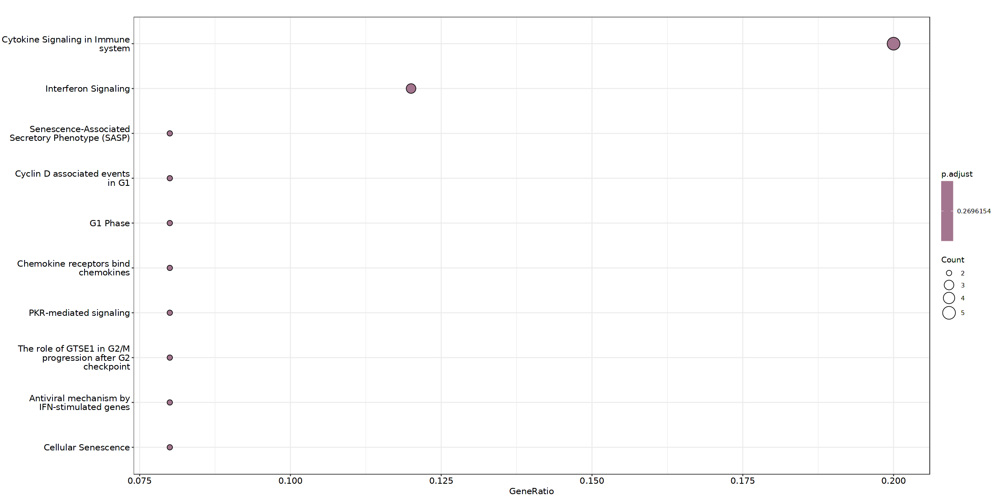

In [334]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [335]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

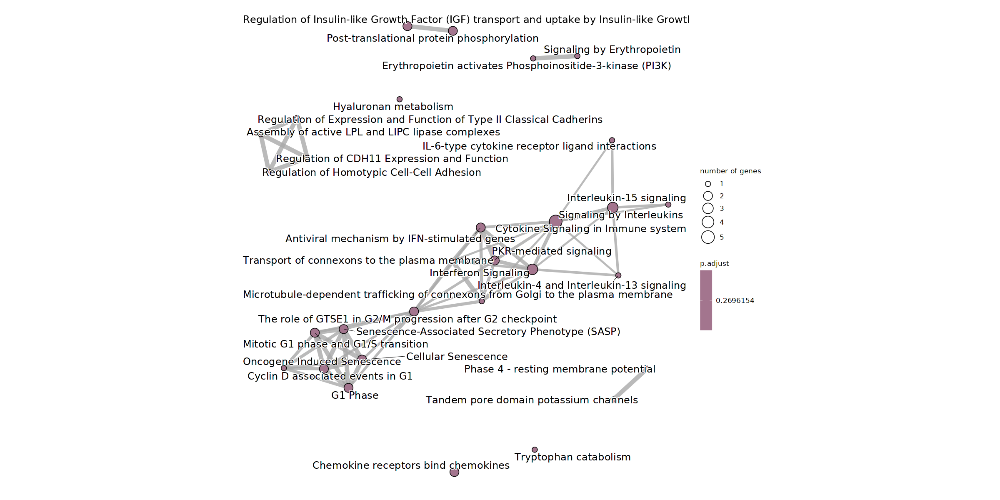

In [336]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 6

In [337]:
highest_cat <- "Early"
second_highest_cat <- "Late"

In [338]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [339]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [340]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [341]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [342]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [343]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [344]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [345]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [346]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [347]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [348]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [349]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:47] "102639906" "114332" "231655" "14161" "240239" "171530" "23993" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...1 enriched terms found
'data.frame':	1 obs. of  9 variables:
 $ ID         : chr "R-MMU-1280215"
 $ Description: chr "Cytokine Signaling in Immune system"
 $ GeneRatio  : chr "7/25"
 $ BgRatio    : chr "447/8582"
 $ pvalue     : num 0.00021
 $ p.adjust   : num 0.0284
 $ qvalue     : num 0.0215
 $ geneID     : chr "Oasl1/Sphk1/Socs3/Il13ra1/Socs2/Lck/Tnfrsf12a"
 $ Count      : int 7
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


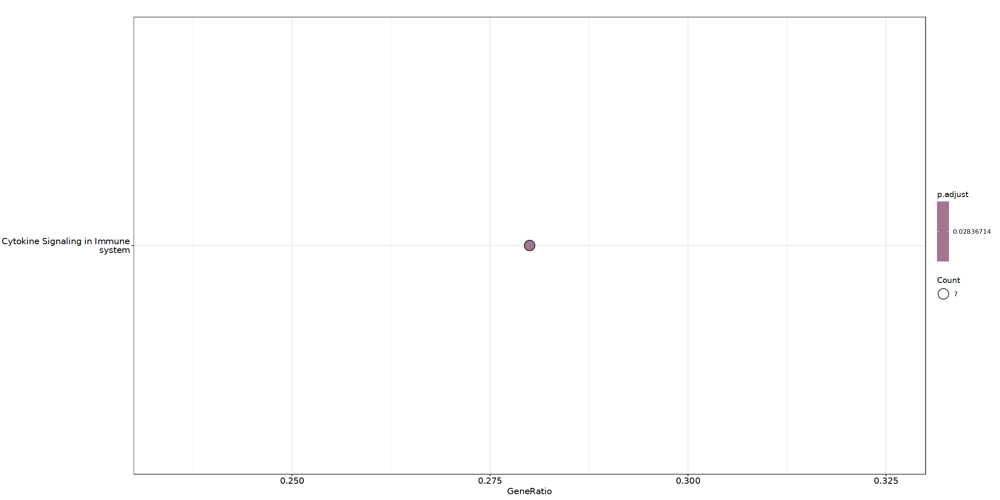

In [350]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [351]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

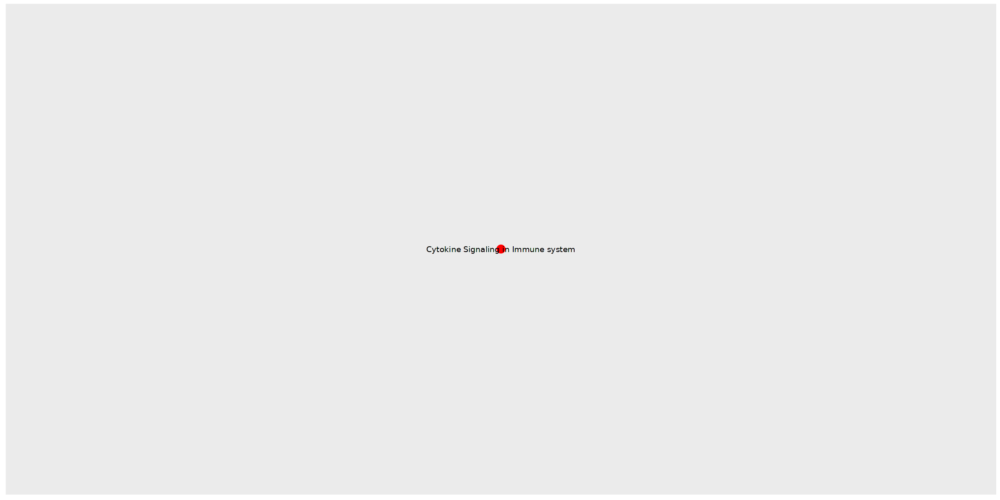

In [352]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [353]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [354]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:47] "102639906" "114332" "231655" "14161" "240239" "171530" "23993" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...135 enriched terms found
'data.frame':	135 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1280215" "R-MMU-216083" "R-MMU-140875" "R-MMU-9607240" ...
 $ Description: chr  "Cytokine Signaling in Immune system" "Integrin cell surface interactions" "Common Pathway of Fibrin Clot Formation" "FLT3 Signaling" ...
 $ GeneRatio  : chr  "7/25" "3/25" "2/25" "2/25" ...
 $ BgRatio    : chr  "447/8582" "66/8582" "21/8582" "29/8582" ...
 $ pvalue     : num  0.00021 0.000885 0.001654 0.003152 0.004082 ...
 $ p.adjust   : num  0.0284 0.0598 0.0744 0.0938 0.0938 ...
 $ qvalue     : num  0.0215 0.0452 0.0563 0.071 0.071 ...
 $ geneID     : chr  "Oasl1/Sphk1/Socs3/Il13ra1/Socs2/Lck/Tnfrsf12a" "Fga/Tnc/Icam1" "Fga/Pros1" "Socs2/Lck" ...
 $ Count      : int  7 3

In [355]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

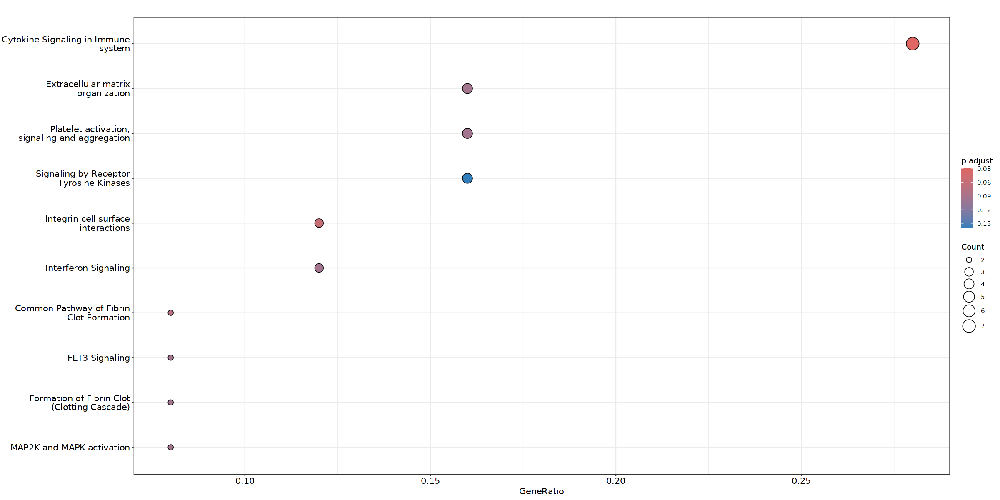

In [356]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [357]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


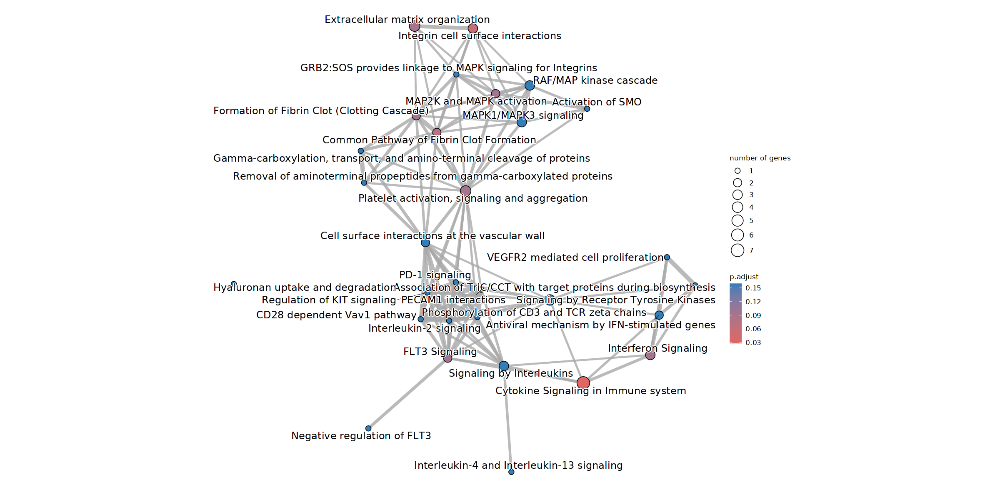

In [358]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 7

In [359]:
highest_cat <- "Peak"
second_highest_cat <- "Ctrl"

In [360]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [361]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [362]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [363]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [364]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [365]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [366]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [367]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [368]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [369]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [370]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [371]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:29] "12524" "11846" "277353" "619310" "102637649" "100322896" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [372]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [373]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:29] "12524" "11846" "277353" "619310" "102637649" "100322896" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...54 enriched terms found
'data.frame':	54 obs. of  9 variables:
 $ ID         : chr  "R-MMU-3000157" "R-MMU-70635" "R-MMU-389359" "R-MMU-435354" ...
 $ Description: chr  "Laminin interactions" "Urea cycle" "CD28 dependent Vav1 pathway" "Zinc transporters" ...
 $ GeneRatio  : chr  "1/10" "1/10" "1/10" "1/10" ...
 $ BgRatio    : chr  "10/8582" "10/8582" "11/8582" "11/8582" ...
 $ pvalue     : num  0.0116 0.0116 0.0128 0.0128 0.0139 ...
 $ p.adjust   : num  0.103 0.103 0.103 0.103 0.103 ...
 $ qvalue     : num  0.0664 0.0664 0.0664 0.0664 0.0664 ...
 $ geneID     : chr  "Megf11" "Arg1" "Cd86" "Slc30a1" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway a

In [374]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

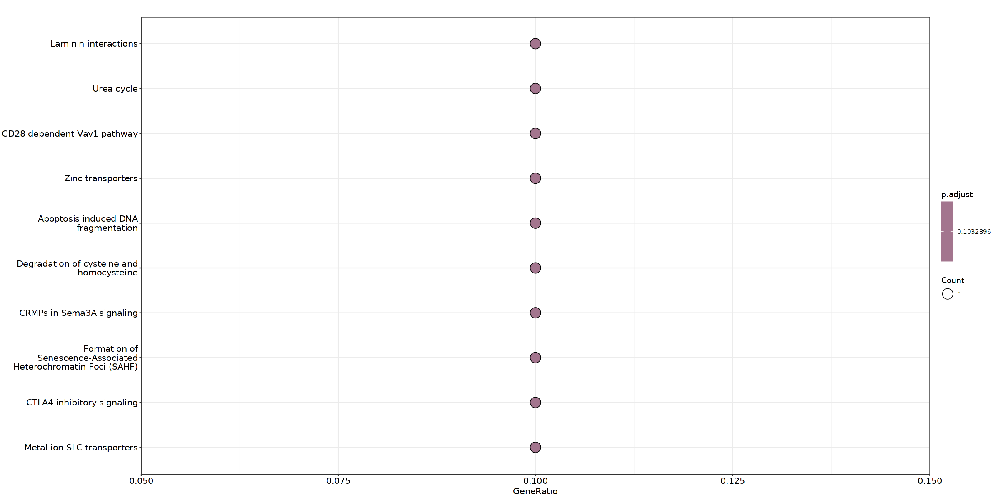

In [375]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [376]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

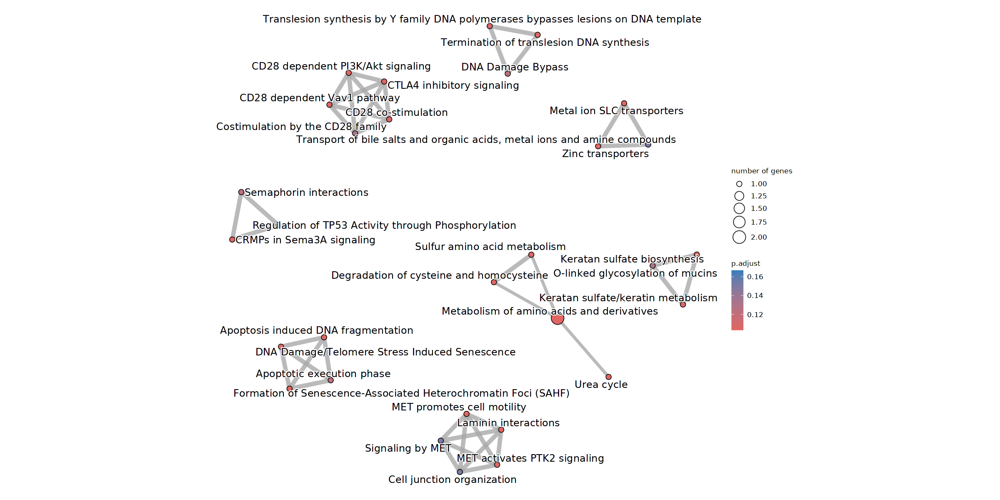

In [377]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 8

In [378]:
highest_cat <- "Peak"
second_highest_cat <- "Early"

In [379]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [380]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [381]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [382]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [383]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [384]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [385]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [386]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [387]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [388]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [389]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [390]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:45] "223672" "71898" "56708" "23960" "330890" "20715" "628900" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...103 enriched terms found
'data.frame':	103 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-1280215" "R-MMU-197264" "R-MMU-983169" ...
 $ Description: chr  "Antigen processing-Cross presentation" "Cytokine Signaling in Immune system" "Nicotinamide salvaging" "Class I MHC mediated antigen processing & presentation" ...
 $ GeneRatio  : chr  "4/19" "6/19" "2/19" "5/19" ...
 $ BgRatio    : chr  "91/8582" "447/8582" "18/8582" "342/8582" ...
 $ pvalue     : num  4.06e-05 2.93e-04 6.96e-04 7.15e-04 1.04e-03 ...
 $ p.adjust   : num  0.00674 0.02432 0.02967 0.02967 0.03096 ...
 $ qvalue     : num  0.00209 0.00756 0.00922 0.00922 0.00962 ...
 $ geneID     : chr  "Psmb9/Psmb8/Tap1/H2-T23" "Clcf1/Psmb9/Psmb8/Uba7/Ifit1bl2/Nlrc5" "Parp10/Parp

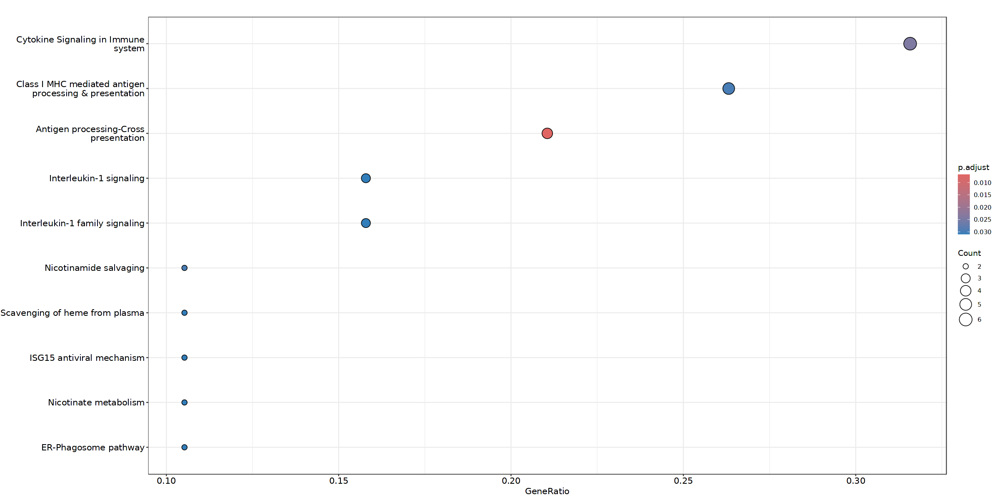

In [391]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [392]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 15 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


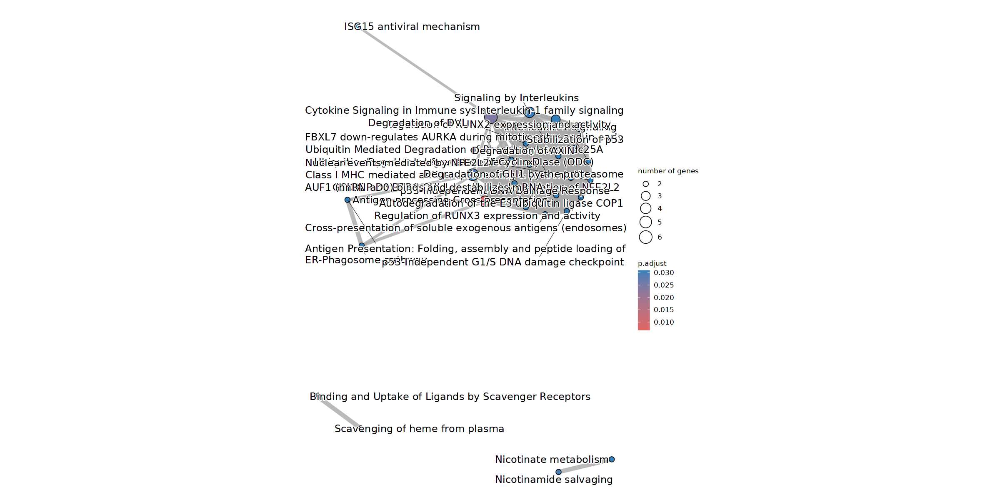

In [393]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [394]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [395]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:45] "223672" "71898" "56708" "23960" "330890" "20715" "628900" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...166 enriched terms found
'data.frame':	166 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-1280215" "R-MMU-197264" "R-MMU-983169" ...
 $ Description: chr  "Antigen processing-Cross presentation" "Cytokine Signaling in Immune system" "Nicotinamide salvaging" "Class I MHC mediated antigen processing & presentation" ...
 $ GeneRatio  : chr  "4/19" "6/19" "2/19" "5/19" ...
 $ BgRatio    : chr  "91/8582" "447/8582" "18/8582" "342/8582" ...
 $ pvalue     : num  4.06e-05 2.93e-04 6.96e-04 7.15e-04 1.04e-03 ...
 $ p.adjust   : num  0.00674 0.02432 0.02967 0.02967 0.03096 ...
 $ qvalue     : num  0.00209 0.00756 0.00922 0.00922 0.00962 ...
 $ geneID     : chr  "Psmb9/Psmb8/Tap1/H2-T23" "Clcf1/Psmb9/Psmb8/Uba7/Ifit1bl2/Nlrc5" "Parp10/Parp14"

In [396]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

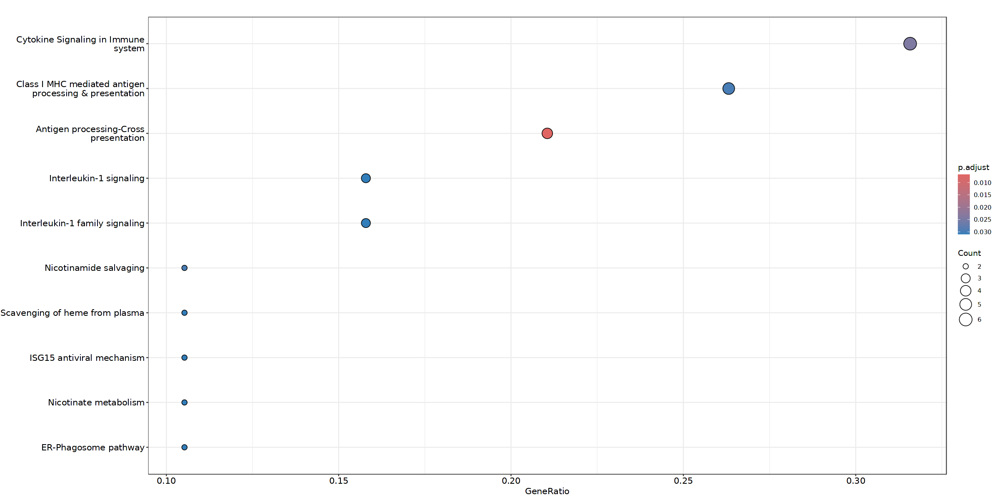

In [397]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [398]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 17 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


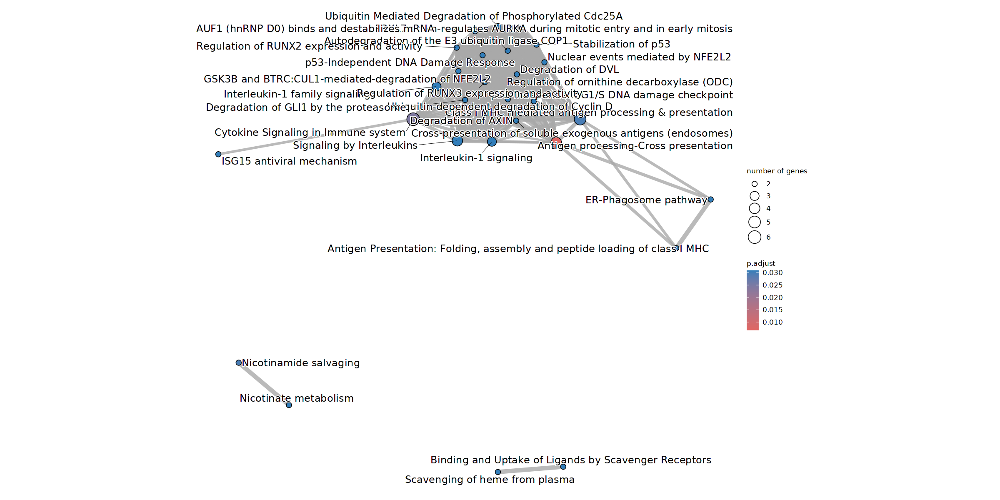

In [399]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 9

In [400]:
highest_cat <- "Peak"
second_highest_cat <- "Late"

In [401]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [402]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [403]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [404]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [405]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [406]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [407]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [408]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [409]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [410]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [411]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [412]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:44] "626578" "15953" "240328" "100039796" "58203" "236573" "21822" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...7 enriched terms found
'data.frame':	7 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236977" "R-MMU-1236974" "R-MMU-983170" "R-MMU-2172127" ...
 $ Description: chr  "Endosomal/Vacuolar pathway" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" "DAP12 interactions" ...
 $ GeneRatio  : chr  "4/17" "4/17" "4/17" "4/17" ...
 $ BgRatio    : chr  "24/8582" "33/8582" "40/8582" "61/8582" ...
 $ pvalue     : num  1.09e-07 4.16e-07 9.22e-07 5.13e-06 2.53e-05 ...
 $ p.adjust   : num  6.23e-06 1.19e-05 1.75e-05 7.31e-05 2.85e-04 ...
 $ qvalue     : num  5.64e-06 1.07e-05 1.58e-05 6.62e-05 2.58e-04 ...
 $ geneID     : chr  "H2-Q7/H2-Q4/H2-Q6/H2-M3" "H2-Q7/H2-Q4/H2-Q6/H2-M3" "H2-Q7/H2-Q4/H2-Q6/H2-M3" "

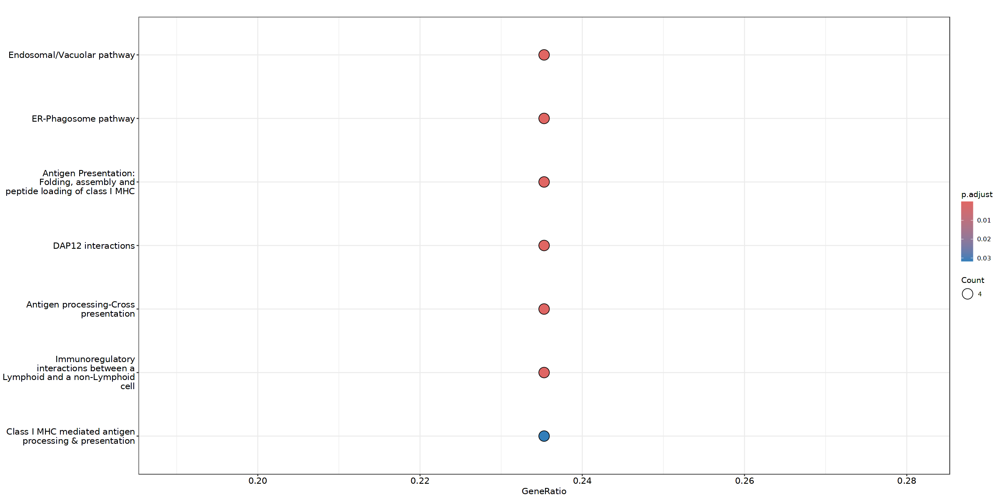

In [413]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [414]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

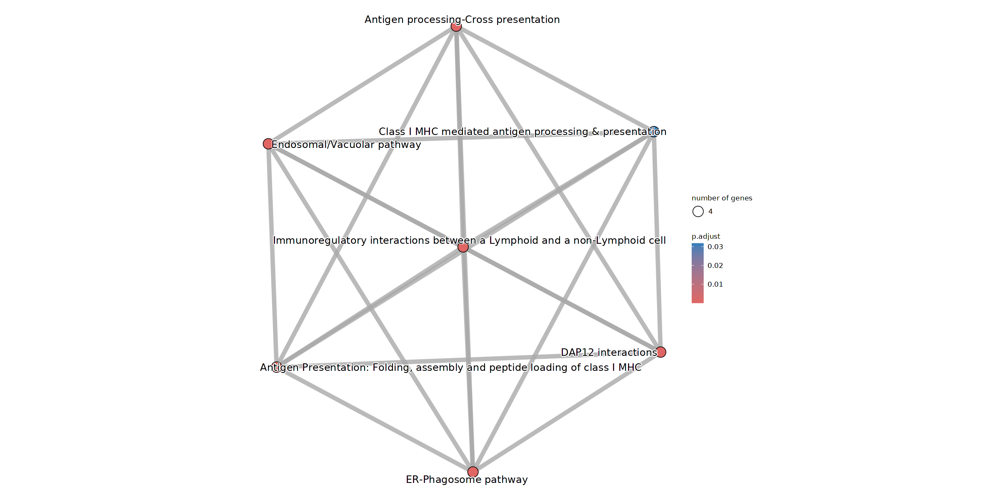

In [415]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [416]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [417]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:44] "626578" "15953" "240328" "100039796" "58203" "236573" "21822" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...57 enriched terms found
'data.frame':	57 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236977" "R-MMU-1236974" "R-MMU-983170" "R-MMU-2172127" ...
 $ Description: chr  "Endosomal/Vacuolar pathway" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" "DAP12 interactions" ...
 $ GeneRatio  : chr  "4/17" "4/17" "4/17" "4/17" ...
 $ BgRatio    : chr  "24/8582" "33/8582" "40/8582" "61/8582" ...
 $ pvalue     : num  1.09e-07 4.16e-07 9.22e-07 5.13e-06 2.53e-05 ...
 $ p.adjust   : num  6.23e-06 1.19e-05 1.75e-05 7.31e-05 2.85e-04 ...
 $ qvalue     : num  5.64e-06 1.07e-05 1.58e-05 6.62e-05 2.58e-04 ...
 $ geneID     : chr  "H2-Q7/H2-Q4/H2-Q6/H2-M3" "H2-Q7/H2-Q4/H2-Q6/H2-M3" "H2-Q7/H2-Q4/H2-Q6/H2-M3" "H

In [418]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

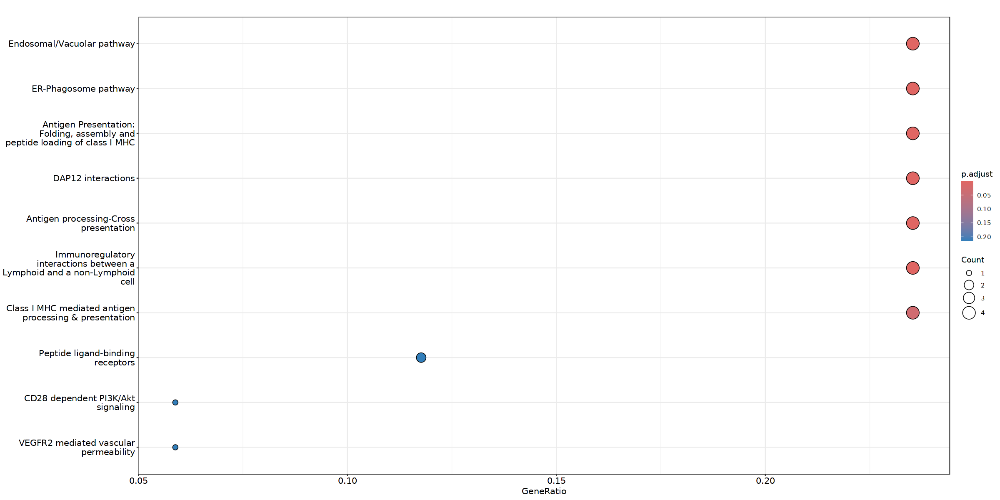

In [419]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [420]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


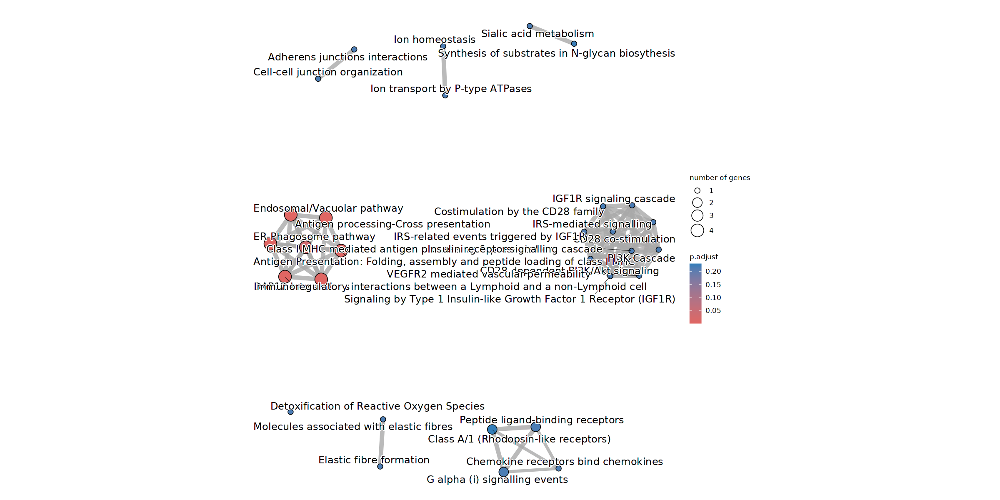

In [421]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 10

In [422]:
highest_cat <- "Late"
second_highest_cat <- "Ctrl"

In [423]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [424]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [425]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [426]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [427]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [428]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [429]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [430]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [431]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [432]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [433]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [434]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:40] "19683" "240332" "19126" "77920" "55983" "102640891" "14761" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [435]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [436]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:40] "19683" "240332" "19126" "77920" "55983" "102640891" "14761" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...59 enriched terms found
'data.frame':	59 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1474244" "R-MMU-190873" "R-MMU-418457" "R-MMU-418555" ...
 $ Description: chr  "Extracellular matrix organization" "Gap junction degradation" "cGMP effects" "G alpha (s) signalling events" ...
 $ GeneRatio  : chr  "3/13" "1/13" "1/13" "2/13" ...
 $ BgRatio    : chr  "230/8582" "10/8582" "10/8582" "132/8582" ...
 $ pvalue     : num  0.00445 0.01505 0.01505 0.01639 0.01953 ...
 $ p.adjust   : num  0.138 0.138 0.138 0.138 0.138 ...
 $ qvalue     : num  0.109 0.109 0.109 0.109 0.109 ...
 $ geneID     : chr  "Col27a1/Capn6/Tnxb" "Dnm1" "Pde10a" "Gpr27/Pde10a" ...
 $ Count      : int  3 1 1 2 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: a

In [437]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

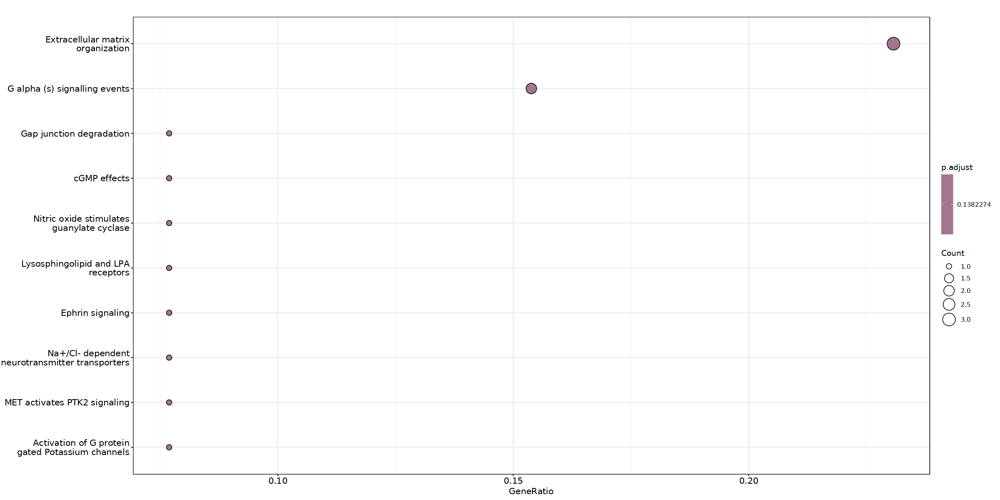

In [438]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [439]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

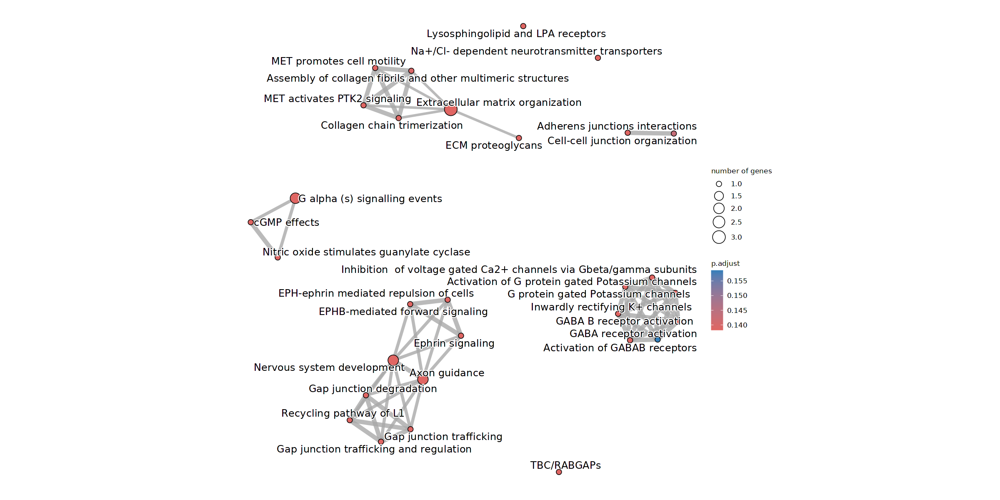

In [440]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 11

In [441]:
highest_cat <- "Late"
second_highest_cat <- "Early"

In [442]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [443]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [444]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [445]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [446]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [447]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [448]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [449]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [450]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [451]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [452]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [453]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:46] "12394" "20983" "667742" "20666" "76770" "68428" "245650" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [454]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [455]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:46] "12394" "20983" "667742" "20666" "76770" "68428" "245650" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...85 enriched terms found
'data.frame':	85 obs. of  9 variables:
 $ ID         : chr  "R-MMU-9013405" "R-MMU-9013406" "R-MMU-446728" "R-MMU-1474244" ...
 $ Description: chr  "RHOD GTPase cycle" "RHOQ GTPase cycle" "Cell junction organization" "Extracellular matrix organization" ...
 $ GeneRatio  : chr  "2/19" "2/19" "2/19" "3/19" ...
 $ BgRatio    : chr  "48/8582" "53/8582" "72/8582" "230/8582" ...
 $ pvalue     : num  0.00493 0.00598 0.01082 0.01341 0.01622 ...
 $ p.adjust   : num  0.21 0.21 0.21 0.21 0.21 ...
 $ qvalue     : num  0.182 0.182 0.182 0.182 0.182 ...
 $ geneID     : chr  "Steap3/Cpne8" "Steap3/Cpne8" "Plec/Flnc" "Sdc1/Ltbp1/Col7a1" ...
 $ Count      : int  2 2 2 3 2 2 4 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an 

In [456]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

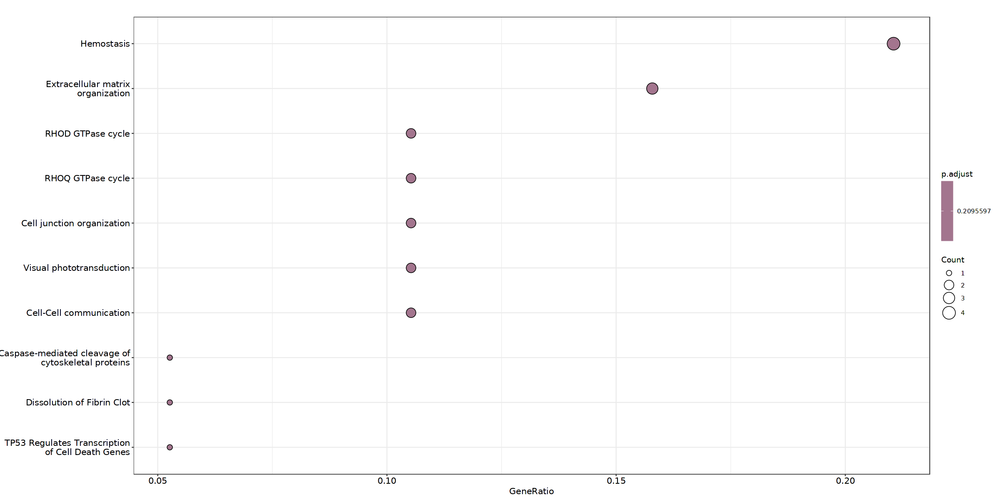

In [457]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [458]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

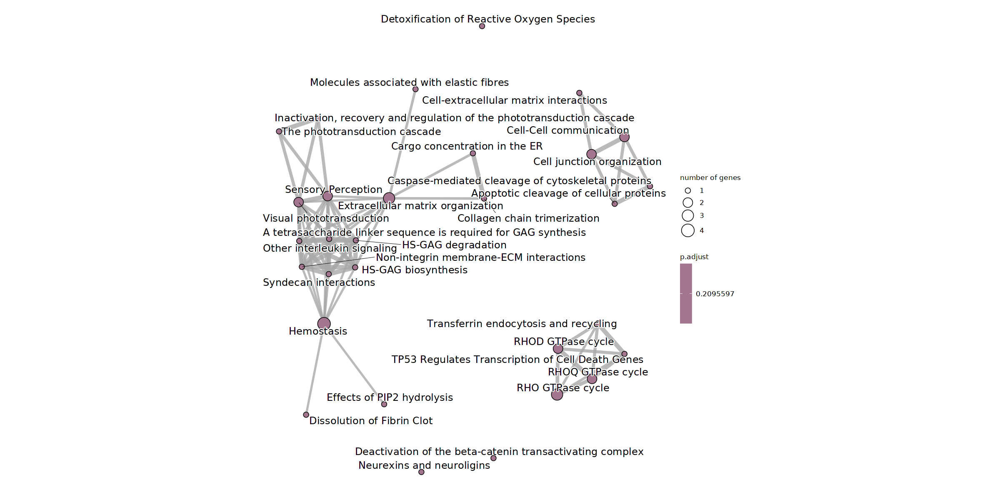

In [459]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 12

In [460]:
highest_cat <- "Late"
second_highest_cat <- "Peak"

In [461]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [462]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [463]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [464]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [465]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [466]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [467]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [468]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [469]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [470]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [471]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [472]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:45] "12833" "668303" "17313" "259277" "21943" "12817" "100504720" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...16 enriched terms found
'data.frame':	16 obs. of  9 variables:
 $ ID         : chr  "R-MMU-5669034" "R-MMU-8948216" "R-MMU-1474228" "R-MMU-1442490" ...
 $ Description: chr  "TNFs bind their physiological receptors" "Collagen chain trimerization" "Degradation of the extracellular matrix" "Collagen degradation" ...
 $ GeneRatio  : chr  "3/21" "3/21" "4/21" "3/21" ...
 $ BgRatio    : chr  "25/8582" "35/8582" "106/8582" "55/8582" ...
 $ pvalue     : num  2.81e-05 7.86e-05 1.12e-04 3.05e-04 3.95e-04 ...
 $ p.adjust   : num  0.00303 0.00403 0.00403 0.00824 0.00853 ...
 $ qvalue     : num  0.0021 0.00279 0.00279 0.0057 0.00591 ...
 $ geneID     : chr  "Tnfsf11/Tnfrsf1b/Tnfrsf1a" "Col6a1/Col13a1/Col6a2" "Col6a1/Col13a1/Col6a2/Scube3" "Col6a1/Col13a1/C

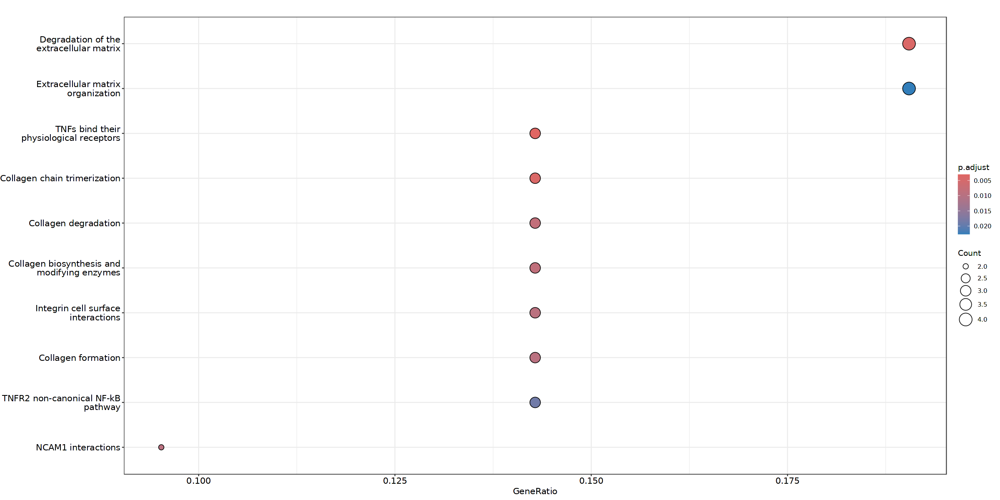

In [473]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [474]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

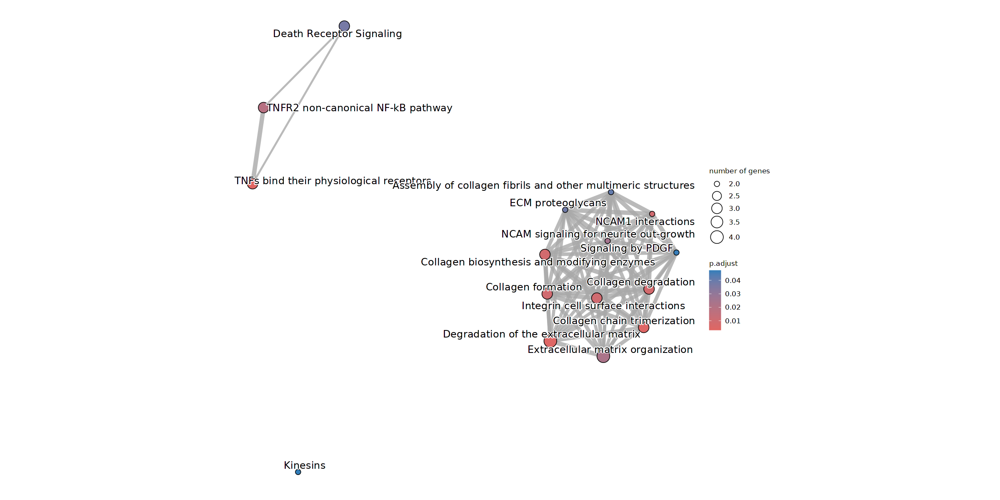

In [475]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [476]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [477]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:45] "12833" "668303" "17313" "259277" "21943" "12817" "100504720" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...108 enriched terms found
'data.frame':	108 obs. of  9 variables:
 $ ID         : chr  "R-MMU-5669034" "R-MMU-8948216" "R-MMU-1474228" "R-MMU-1442490" ...
 $ Description: chr  "TNFs bind their physiological receptors" "Collagen chain trimerization" "Degradation of the extracellular matrix" "Collagen degradation" ...
 $ GeneRatio  : chr  "3/21" "3/21" "4/21" "3/21" ...
 $ BgRatio    : chr  "25/8582" "35/8582" "106/8582" "55/8582" ...
 $ pvalue     : num  2.81e-05 7.86e-05 1.12e-04 3.05e-04 3.95e-04 ...
 $ p.adjust   : num  0.00303 0.00403 0.00403 0.00824 0.00853 ...
 $ qvalue     : num  0.0021 0.00279 0.00279 0.0057 0.00591 ...
 $ geneID     : chr  "Tnfsf11/Tnfrsf1b/Tnfrsf1a" "Col6a1/Col13a1/Col6a2" "Col6a1/Col13a1/Col6a2/Scube3" "Col6a1/Col13a1/Co

In [478]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL56_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

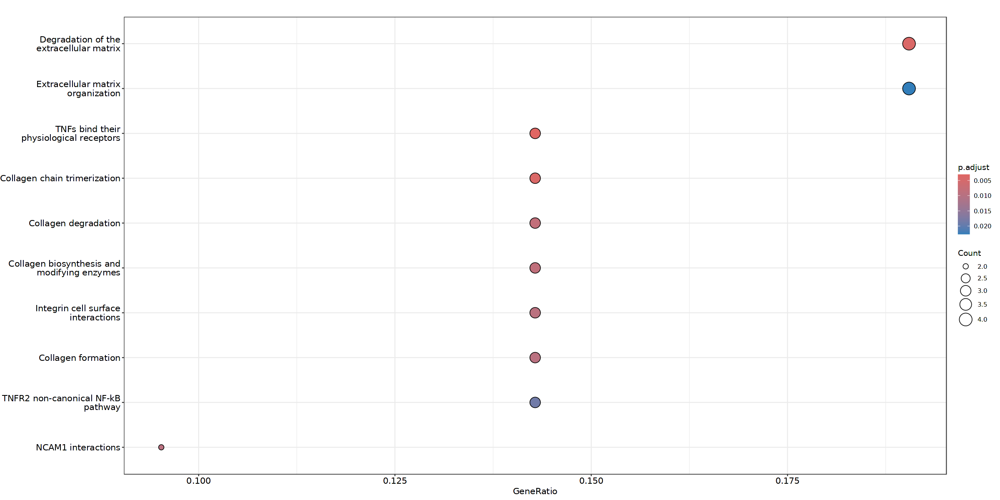

In [479]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [480]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 5 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


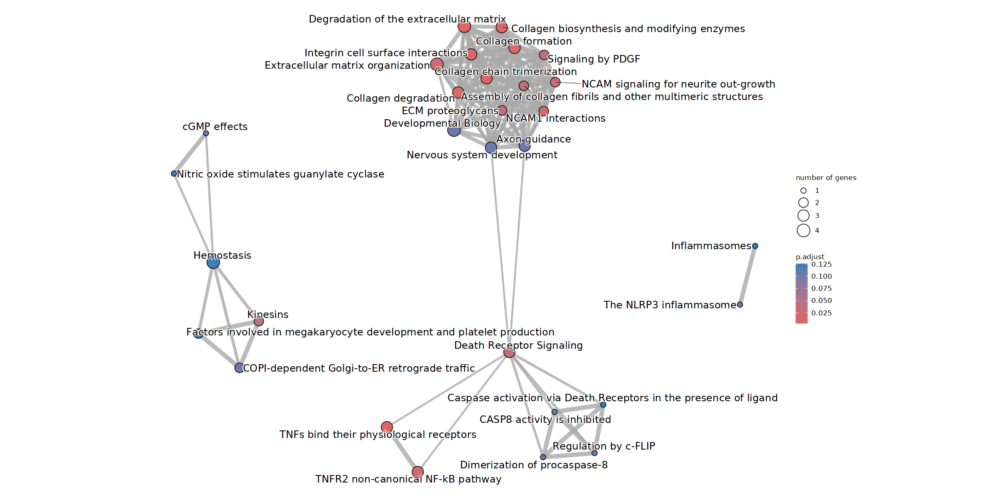

In [481]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

#### 3.1.2 MOL2

In [482]:
df_dynamics <- readRDS(paste0(OS_path_outputs, "Dynamics_DGE_RNA_MOL2.rds"))

In [483]:
df_dynamics_scaled <- df_dynamics/do.call(pmax, df_dynamics)

##### Category 1

In [484]:
highest_cat <- "Ctrl"

In [485]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [486]:
length(gene_list)

[1] 260

In [487]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [488]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [489]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [490]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [491]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [492]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [493]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [494]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:39] "18159" "666048" "14038" "16542" "71897" "18109" "319984" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [495]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [496]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:39] "18159" "666048" "14038" "16542" "71897" "18109" "319984" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...60 enriched terms found
'data.frame':	60 obs. of  9 variables:
 $ ID         : chr  "R-MMU-216083" "R-MMU-109582" "R-MMU-5218921" "R-MMU-419408" ...
 $ Description: chr  "Integrin cell surface interactions" "Hemostasis" "VEGFR2 mediated cell proliferation" "Lysosphingolipid and LPA receptors" ...
 $ GeneRatio  : chr  "2/15" "4/15" "1/15" "1/15" ...
 $ BgRatio    : chr  "66/8582" "492/8582" "13/8582" "14/8582" ...
 $ pvalue     : num  0.00573 0.00878 0.0225 0.02421 0.02763 ...
 $ p.adjust   : num  0.207 0.207 0.207 0.207 0.207 ...
 $ qvalue     : num  0.178 0.178 0.178 0.178 0.178 ...
 $ geneID     : chr  "Col9a1/Itga4" "Dgkg/Itih3/Itga4/Kif21b" "Kdr" "Plppr5" ...
 $ Count      : int  2 4 1 1 1 2 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. 

In [497]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,".csv"), row.names=FALSE)

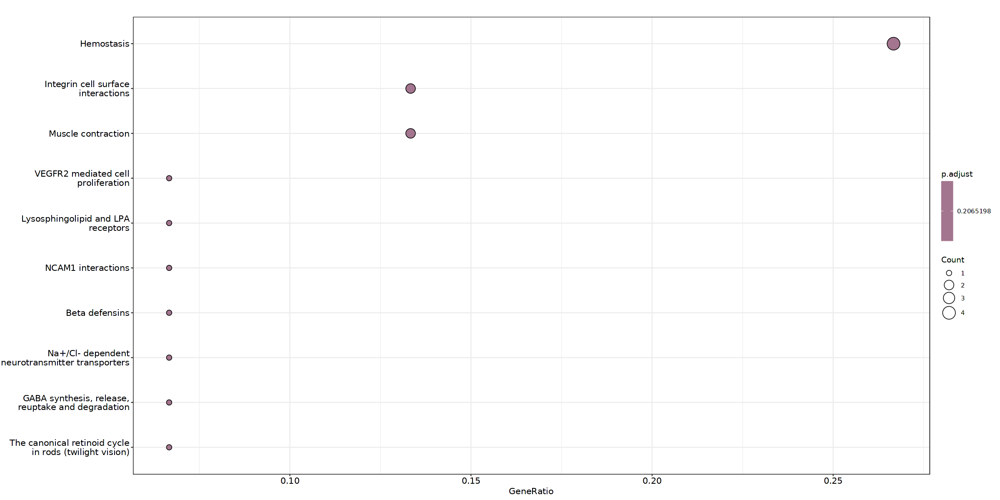

In [498]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [499]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


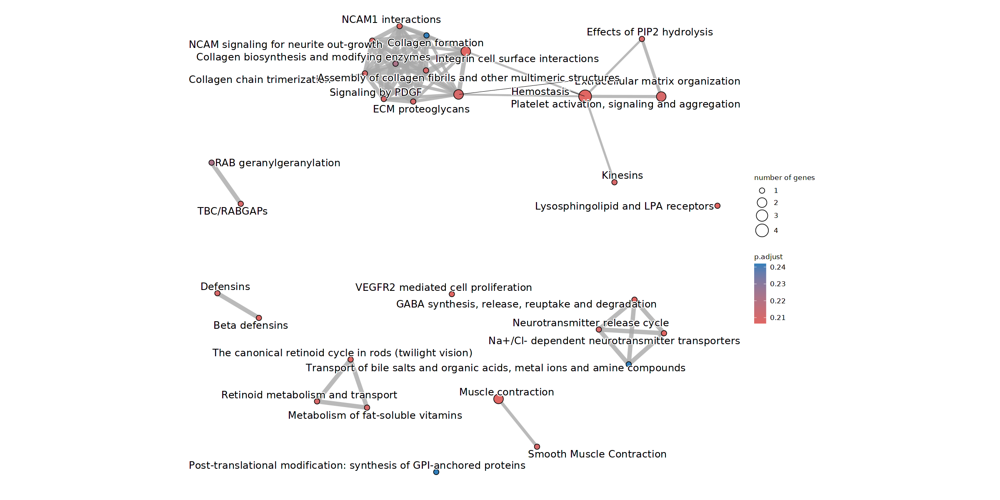

In [500]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Category 2

In [501]:
highest_cat <- "Early"

In [502]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [503]:
length(gene_list)

[1] 403

In [504]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [505]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [506]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [507]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [508]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [509]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [510]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [511]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:46] "80982" "171530" "75750" "381677" "240239" "14161" "114332" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...3 enriched terms found
'data.frame':	3 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8957275" "R-MMU-381426" "R-MMU-2142845"
 $ Description: chr  "Post-translational protein phosphorylation" "Regulation of Insulin-like Growth Factor (IGF) transport and uptake by Insulin-like Growth Factor Binding Proteins (IGFBPs)" "Hyaluronan metabolism"
 $ GeneRatio  : chr  "4/24" "4/24" "2/24"
 $ BgRatio    : chr  "114/8582" "120/8582" "17/8582"
 $ pvalue     : num  0.000256 0.000311 0.000994
 $ p.adjust   : num  0.016 0.016 0.0341
 $ qvalue     : num  0.0123 0.0123 0.0261
 $ geneID     : chr  "Vgf/Fga/Timp1/Tnc" "Vgf/Fga/Timp1/Tnc" "Cemip/Lyve1"
 $ Count      : int  4 4 2
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package fo

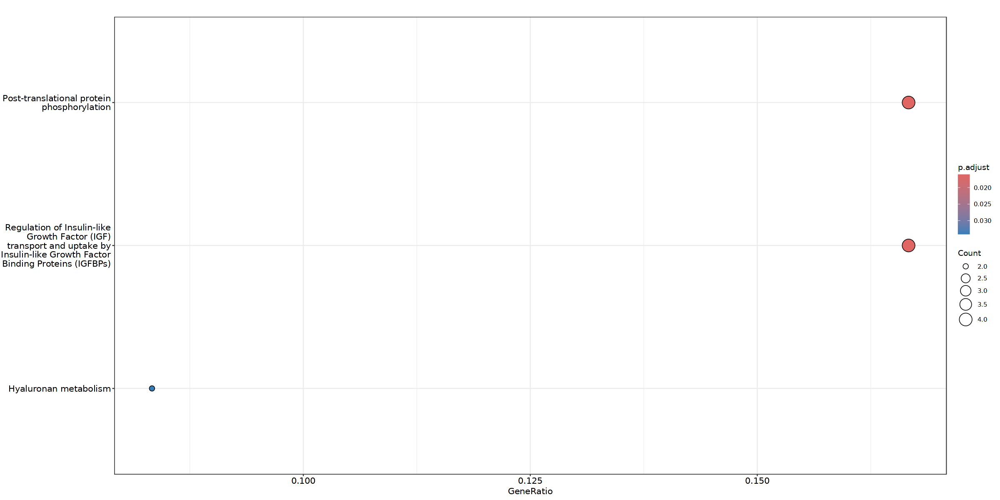

In [512]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [513]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

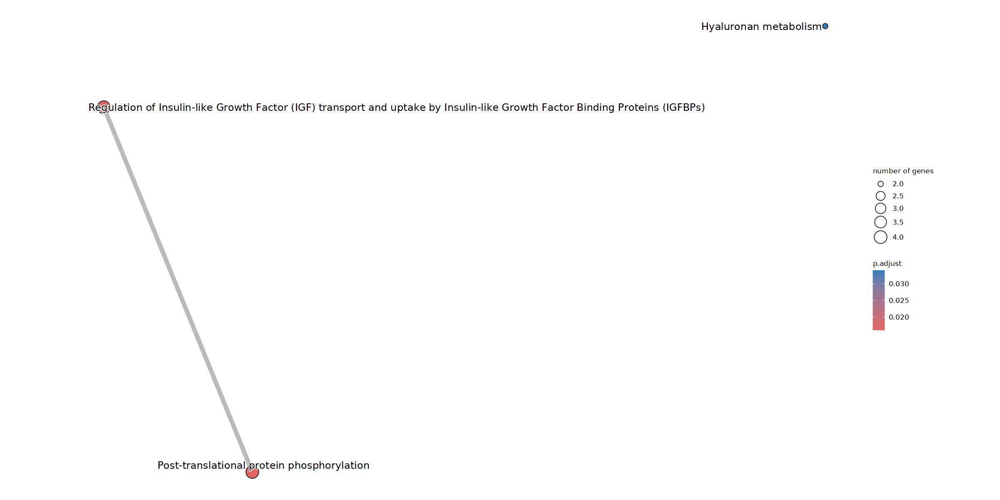

In [514]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [515]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [516]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:46] "80982" "171530" "75750" "381677" "240239" "14161" "114332" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...103 enriched terms found
'data.frame':	103 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8957275" "R-MMU-381426" "R-MMU-2142845" "R-MMU-1630316" ...
 $ Description: chr  "Post-translational protein phosphorylation" "Regulation of Insulin-like Growth Factor (IGF) transport and uptake by Insulin-like Growth Factor Binding Proteins (IGFBPs)" "Hyaluronan metabolism" "Glycosaminoglycan metabolism" ...
 $ GeneRatio  : chr  "4/24" "4/24" "2/24" "3/24" ...
 $ BgRatio    : chr  "114/8582" "120/8582" "17/8582" "119/8582" ...
 $ pvalue     : num  0.000256 0.000311 0.000994 0.004254 0.005751 ...
 $ p.adjust   : num  0.016 0.016 0.0341 0.0805 0.0805 ...
 $ qvalue     : num  0.0123 0.0123 0.0261 0.0617 0.0617 ...
 $ geneID     : chr  "Vgf/Fga/Timp1/Tnc" "Vgf

In [517]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,".csv"), row.names=FALSE)

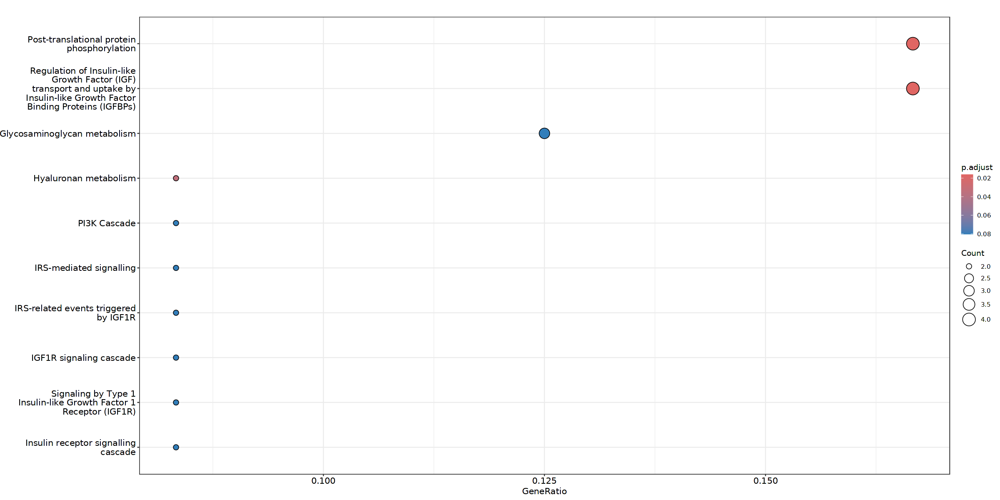

In [518]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [519]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


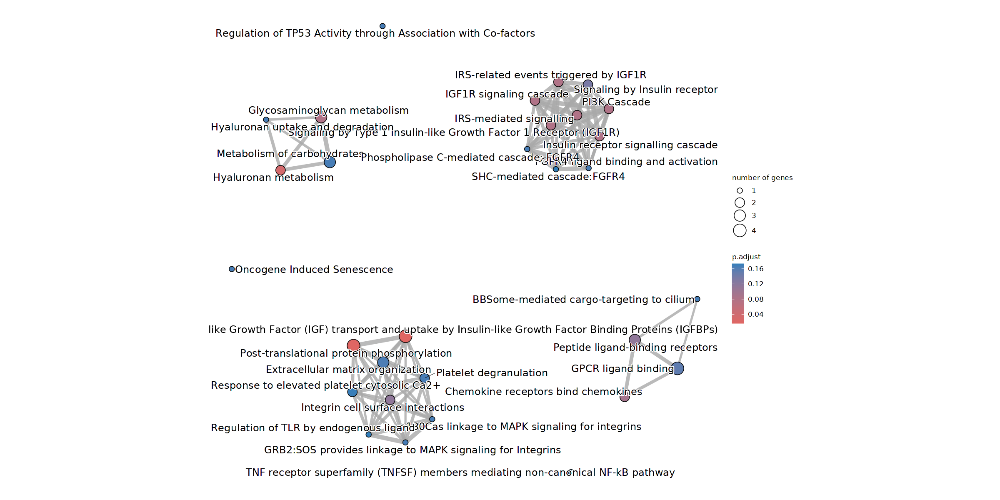

In [520]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Category 3

In [521]:
highest_cat <- "Peak"

In [522]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [523]:
length(gene_list)

[1] 1247

In [524]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [525]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [526]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [527]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [528]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [529]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [530]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [531]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:43] "223672" "71898" "69065" "14573" "225594" "99899" "66815" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...97 enriched terms found
'data.frame':	97 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-2168880" "R-MMU-5668541" "R-MMU-1236974" ...
 $ Description: chr  "Antigen processing-Cross presentation" "Scavenging of heme from plasma" "TNFR2 non-canonical NF-kB pathway" "ER-Phagosome pathway" ...
 $ GeneRatio  : chr  "4/18" "2/18" "3/18" "2/18" ...
 $ BgRatio    : chr  "91/8582" "22/8582" "96/8582" "33/8582" ...
 $ pvalue     : num  3.23e-05 9.36e-04 9.80e-04 2.11e-03 2.11e-03 ...
 $ p.adjust   : num  0.0052 0.0297 0.0297 0.0297 0.0297 ...
 $ qvalue     : num  0.00173 0.00991 0.00991 0.00991 0.00991 ...
 $ geneID     : chr  "Psmb8/Tap1/Psmb9/H2-Q4" "Apol9a/Apol9b" "Tnfsf11/Psmb8/Psmb9" "Tap1/H2-Q4" ...
 $ Count      : int  4 2 3 2 2 2 2

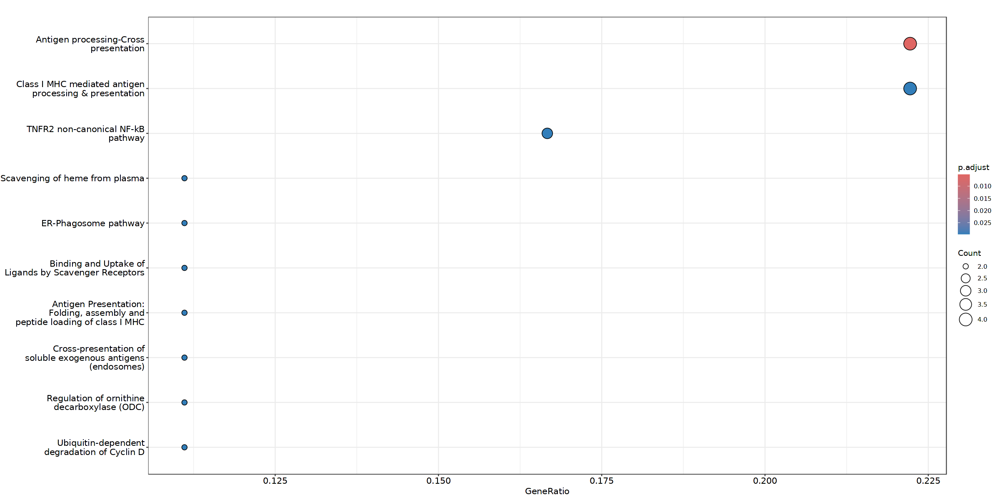

In [532]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [533]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 19 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


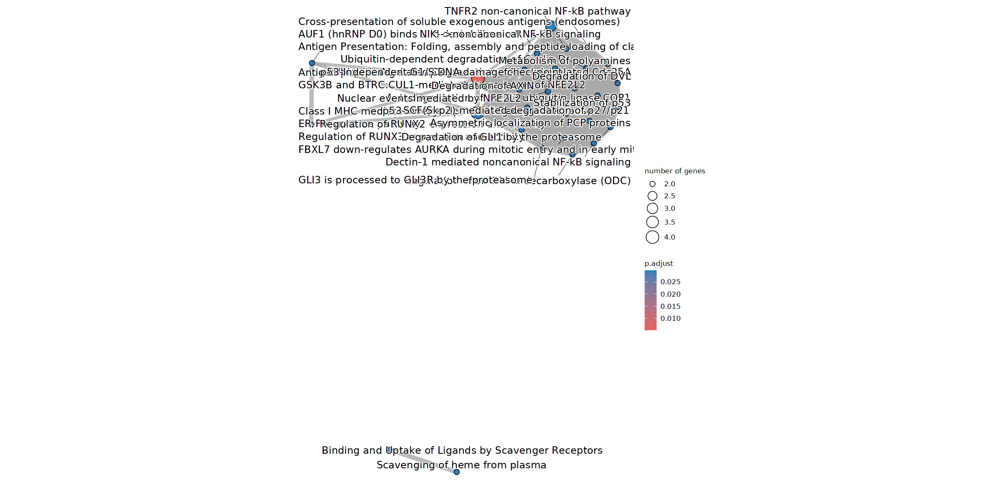

In [534]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [535]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [536]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:43] "223672" "71898" "69065" "14573" "225594" "99899" "66815" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...161 enriched terms found
'data.frame':	161 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236975" "R-MMU-2168880" "R-MMU-5668541" "R-MMU-1236974" ...
 $ Description: chr  "Antigen processing-Cross presentation" "Scavenging of heme from plasma" "TNFR2 non-canonical NF-kB pathway" "ER-Phagosome pathway" ...
 $ GeneRatio  : chr  "4/18" "2/18" "3/18" "2/18" ...
 $ BgRatio    : chr  "91/8582" "22/8582" "96/8582" "33/8582" ...
 $ pvalue     : num  3.23e-05 9.36e-04 9.80e-04 2.11e-03 2.11e-03 ...
 $ p.adjust   : num  0.0052 0.0297 0.0297 0.0297 0.0297 ...
 $ qvalue     : num  0.00173 0.00991 0.00991 0.00991 0.00991 ...
 $ geneID     : chr  "Psmb8/Tap1/Psmb9/H2-Q4" "Apol9a/Apol9b" "Tnfsf11/Psmb8/Psmb9" "Tap1/H2-Q4" ...
 $ Count      : int  4 2 3 2 2 2 2 

In [537]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,".csv"), row.names=FALSE)

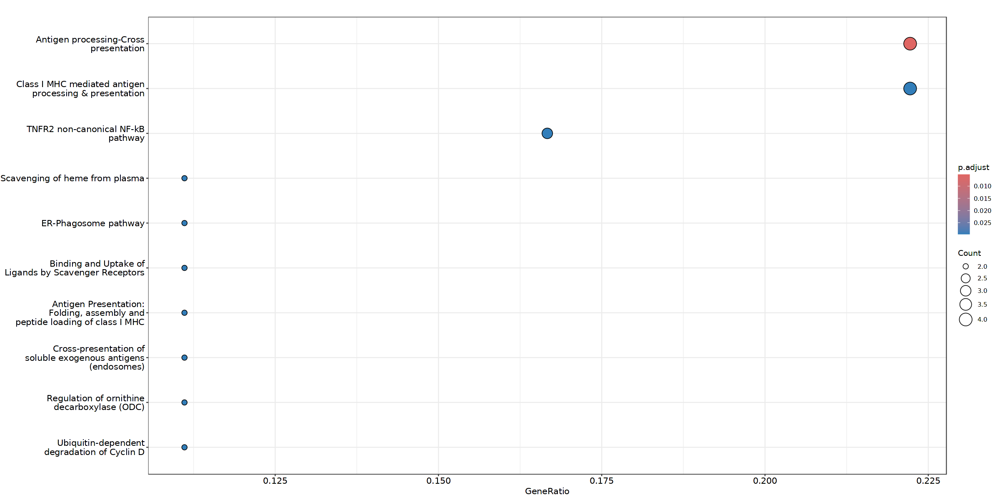

In [538]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [539]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 20 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


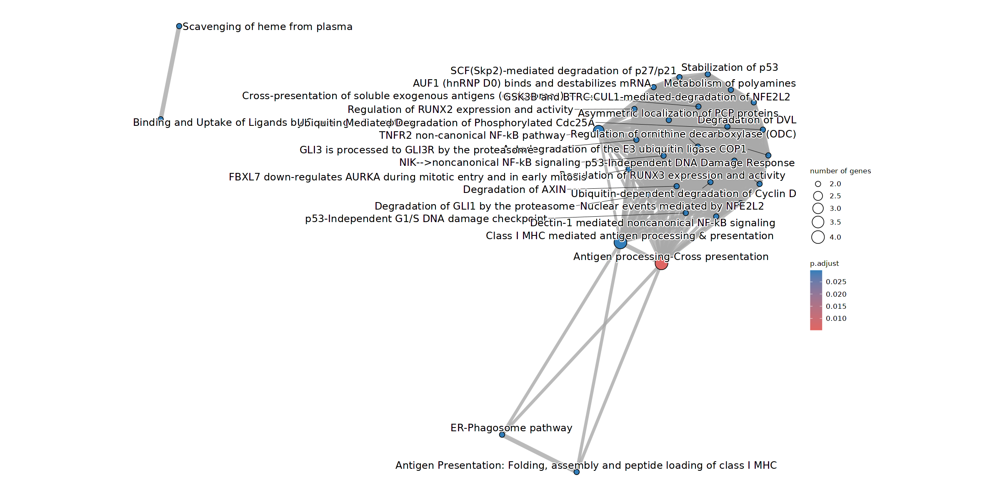

In [540]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Category 4

In [541]:
highest_cat <- "Late"

In [542]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [543]:
length(gene_list)

[1] 588

In [544]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [545]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [546]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [547]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [548]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [549]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [550]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [551]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:43] "11727" "12833" "13206" "230959" "12817" "100504720" "57780" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...11 enriched terms found
'data.frame':	11 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8948216" "R-MMU-1442490" "R-MMU-1650814" "R-MMU-1474290" ...
 $ Description: chr  "Collagen chain trimerization" "Collagen degradation" "Collagen biosynthesis and modifying enzymes" "Collagen formation" ...
 $ GeneRatio  : chr  "3/15" "3/15" "3/15" "3/15" ...
 $ BgRatio    : chr  "35/8582" "55/8582" "60/8582" "73/8582" ...
 $ pvalue     : num  2.73e-05 1.07e-04 1.39e-04 2.50e-04 4.79e-04 ...
 $ p.adjust   : num  0.00175 0.00297 0.00297 0.00399 0.0058 ...
 $ qvalue     : num  0.00109 0.00186 0.00186 0.0025 0.00362 ...
 $ geneID     : chr  "Col6a1/Col13a1/Col23a1" "Col6a1/Col13a1/Mmp11" "Col6a1/Col13a1/Col23a1" "Col6a1/Col13a1/Col23a1" ...
 $ Count      : i

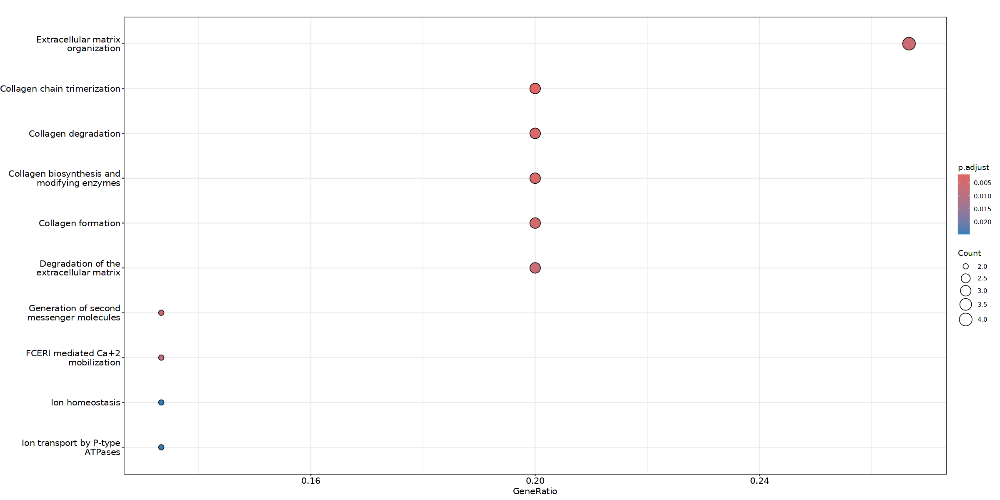

In [552]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [553]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

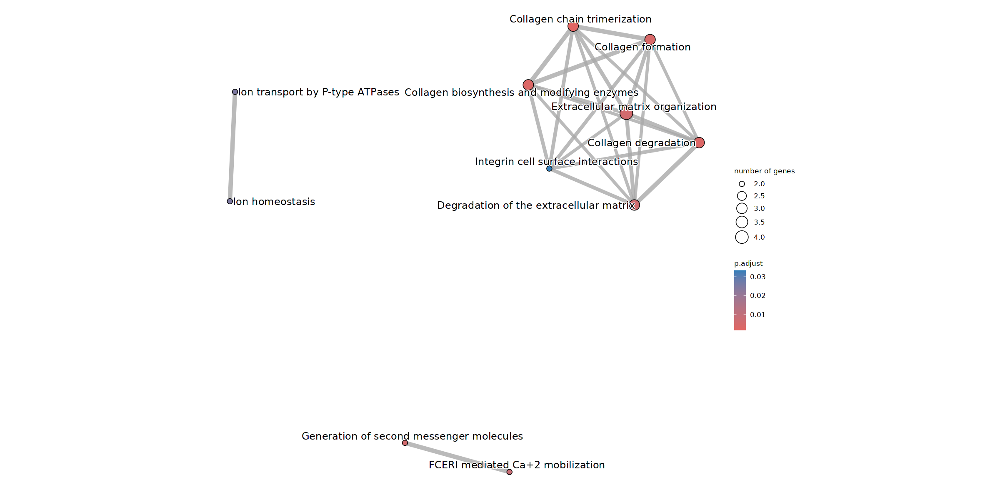

In [554]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [555]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [556]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:43] "11727" "12833" "13206" "230959" "12817" "100504720" "57780" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...64 enriched terms found
'data.frame':	64 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8948216" "R-MMU-1442490" "R-MMU-1650814" "R-MMU-1474290" ...
 $ Description: chr  "Collagen chain trimerization" "Collagen degradation" "Collagen biosynthesis and modifying enzymes" "Collagen formation" ...
 $ GeneRatio  : chr  "3/15" "3/15" "3/15" "3/15" ...
 $ BgRatio    : chr  "35/8582" "55/8582" "60/8582" "73/8582" ...
 $ pvalue     : num  2.73e-05 1.07e-04 1.39e-04 2.50e-04 4.79e-04 ...
 $ p.adjust   : num  0.00175 0.00297 0.00297 0.00399 0.0058 ...
 $ qvalue     : num  0.00109 0.00186 0.00186 0.0025 0.00362 ...
 $ geneID     : chr  "Col6a1/Col13a1/Col23a1" "Col6a1/Col13a1/Mmp11" "Col6a1/Col13a1/Col23a1" "Col6a1/Col13a1/Col23a1" ...
 $ Count      : int 

In [557]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,".csv"), row.names=FALSE)

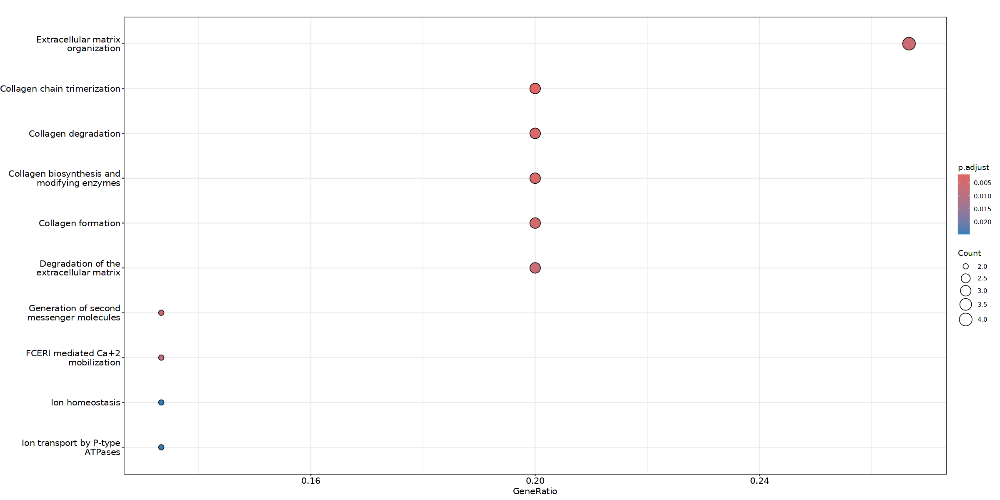

In [558]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [559]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

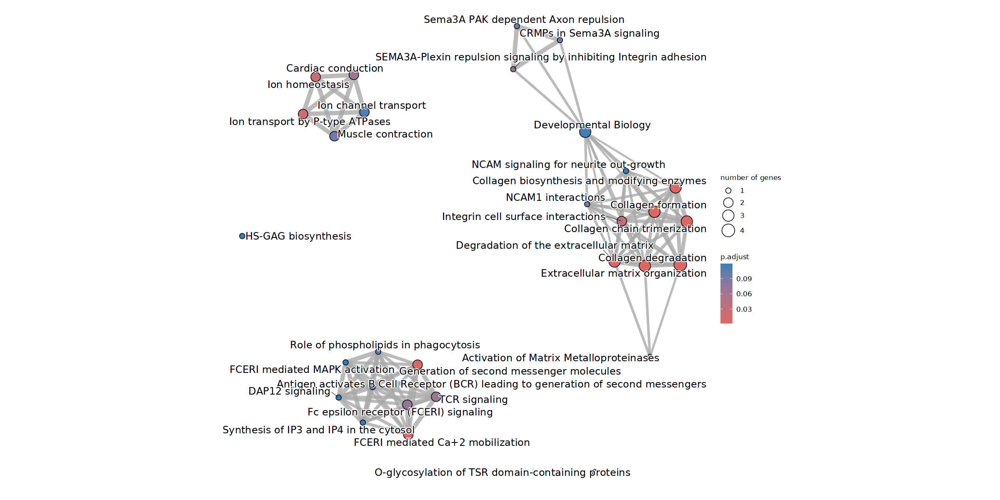

In [560]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 1

In [561]:
highest_cat <- "Ctrl"
second_highest_cat <- "Early"

In [562]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [563]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [564]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [565]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [566]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [567]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [568]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [569]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [570]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [571]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [572]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [573]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:38] "18159" "14038" "16542" "102638008" "16426" "100503289" "67606" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [574]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [575]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:38] "18159" "14038" "16542" "102638008" "16426" "100503289" "67606" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...54 enriched terms found
'data.frame':	54 obs. of  9 variables:
 $ ID         : chr  "R-MMU-216083" "R-MMU-1474244" "R-MMU-109582" "R-MMU-114608" ...
 $ Description: chr  "Integrin cell surface interactions" "Extracellular matrix organization" "Hemostasis" "Platelet degranulation" ...
 $ GeneRatio  : chr  "2/15" "3/15" "4/15" "2/15" ...
 $ BgRatio    : chr  "66/8582" "230/8582" "492/8582" "117/8582" ...
 $ pvalue     : num  0.00573 0.00681 0.00878 0.01723 0.01865 ...
 $ p.adjust   : num  0.147 0.147 0.147 0.147 0.147 ...
 $ qvalue     : num  0.121 0.121 0.121 0.121 0.121 ...
 $ geneID     : chr  "Col9a1/Itga4" "Col9a1/Itga4/Mmp15" "Itih3/Itga4/Kif21b/Ly6g6f" "Itih3/Ly6g6f" ...
 $ Count      : int  2 3 4 2 2 1 1 1 2 1 ...
#...Citation
  Guangchua

In [576]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

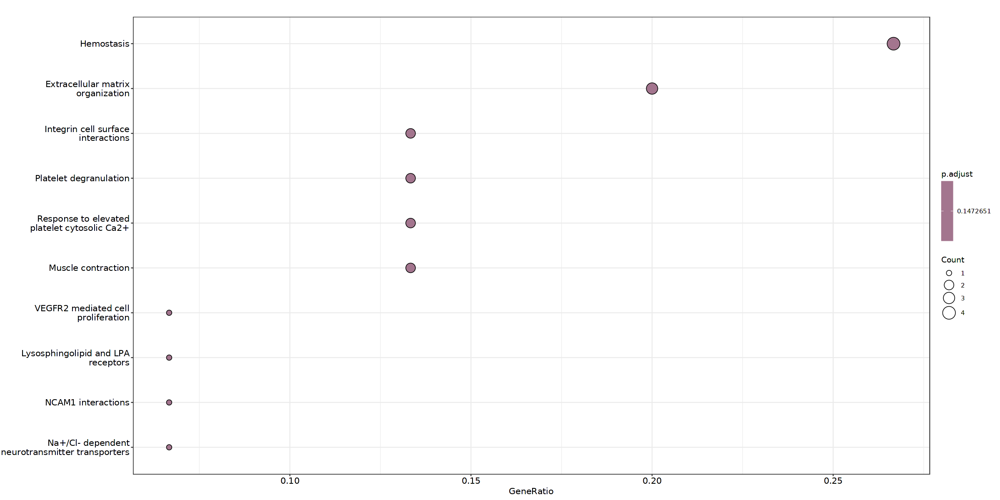

In [577]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [578]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

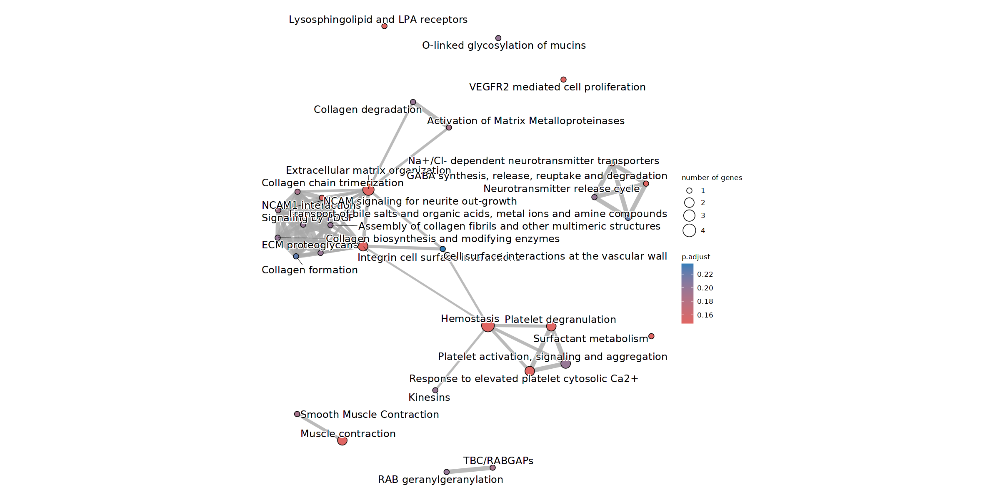

In [579]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 2

In [580]:
highest_cat <- "Ctrl"
second_highest_cat <- "Peak"

In [581]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [582]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [583]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [584]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [585]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [586]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [587]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [588]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [589]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [590]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [591]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [592]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:11] "110197" "217410" "53322" "73710" "381413" "22339" "69573" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...2 enriched terms found
'data.frame':	2 obs. of  9 variables:
 $ ID         : chr  "R-MMU-109582" "R-MMU-76002"
 $ Description: chr  "Hemostasis" "Platelet activation, signaling and aggregation"
 $ GeneRatio  : chr  "4/7" "3/7"
 $ BgRatio    : chr  "492/8582" "246/8582"
 $ pvalue     : num  0.000325 0.000748
 $ p.adjust   : num  0.0263 0.0303
 $ qvalue     : num  0.0175 0.0201
 $ geneID     : chr  "Dgkg/Tubb2b/Vegfa/Rapgef3" "Dgkg/Vegfa/Rapgef3"
 $ Count      : int  4 3
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


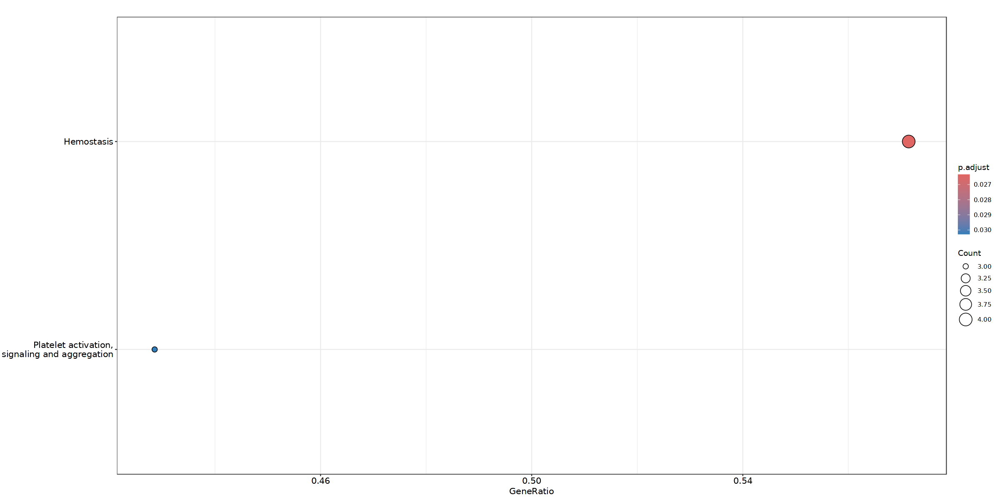

In [593]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [594]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

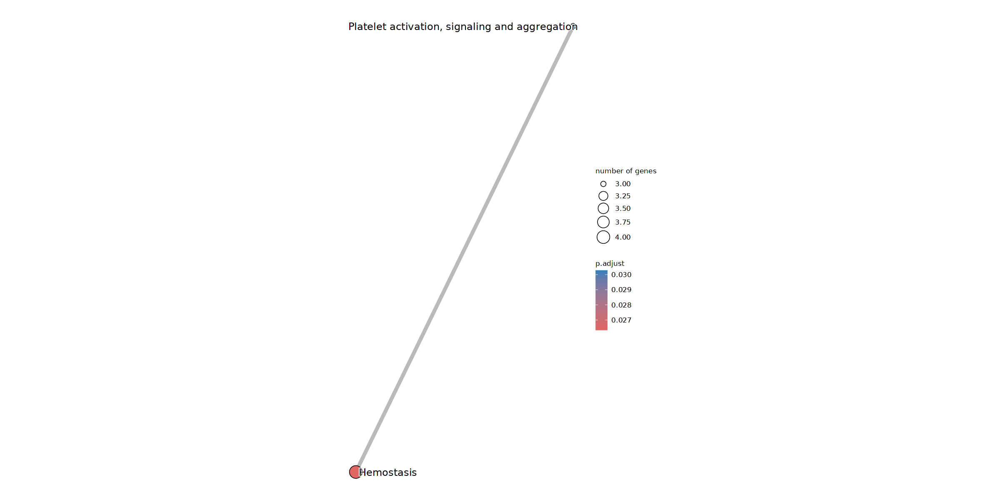

In [595]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [596]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [597]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:11] "110197" "217410" "53322" "73710" "381413" "22339" "69573" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...81 enriched terms found
'data.frame':	81 obs. of  9 variables:
 $ ID         : chr  "R-MMU-109582" "R-MMU-76002" "R-MMU-5218921" "R-MMU-392517" ...
 $ Description: chr  "Hemostasis" "Platelet activation, signaling and aggregation" "VEGFR2 mediated cell proliferation" "Rap1 signalling" ...
 $ GeneRatio  : chr  "4/7" "3/7" "1/7" "1/7" ...
 $ BgRatio    : chr  "492/8582" "246/8582" "13/8582" "14/8582" ...
 $ pvalue     : num  0.000325 0.000748 0.010559 0.011367 0.012175 ...
 $ p.adjust   : num  0.0263 0.0303 0.1097 0.1097 0.1097 ...
 $ qvalue     : num  0.0175 0.0201 0.0727 0.0727 0.0727 ...
 $ geneID     : chr  "Dgkg/Tubb2b/Vegfa/Rapgef3" "Dgkg/Vegfa/Rapgef3" "Vegfa" "Rapgef3" ...
 $ Count      : int  4 3 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang

In [598]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

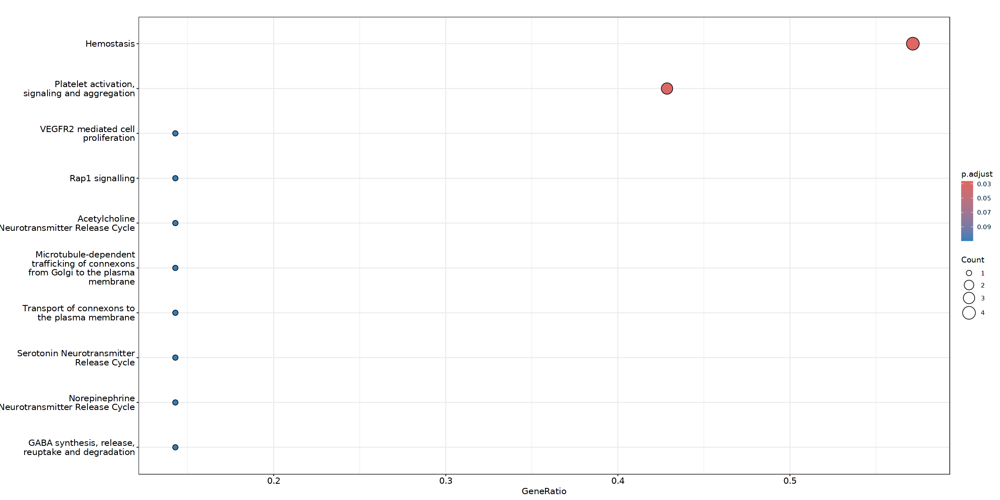

In [599]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [600]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

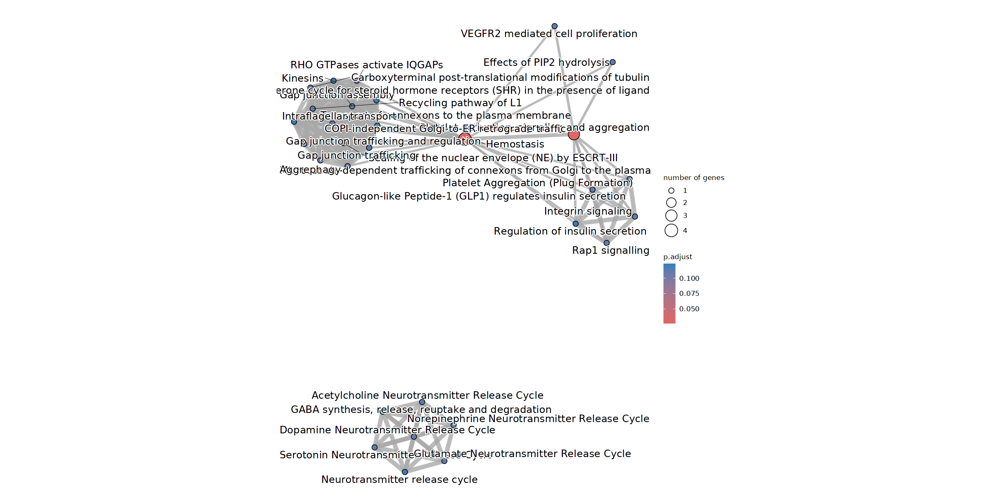

In [601]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 3

In [602]:
highest_cat <- "Ctrl"
second_highest_cat <- "Late"

In [603]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [604]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [605]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [606]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [607]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [608]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [609]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [610]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [611]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [612]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [613]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [614]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:41] "666048" "71897" "18109" "319984" "79235" "97998" "619548" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [615]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [616]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:41] "666048" "71897" "18109" "319984" "79235" "97998" "619548" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...79 enriched terms found
'data.frame':	79 obs. of  9 variables:
 $ ID         : chr  "R-MMU-9035034" "R-MMU-9696264" "R-MMU-9696273" "R-MMU-9696270" ...
 $ Description: chr  "RHOF GTPase cycle" "RND3 GTPase cycle" "RND1 GTPase cycle" "RND2 GTPase cycle" ...
 $ GeneRatio  : chr  "2/18" "2/18" "2/18" "2/18" ...
 $ BgRatio    : chr  "37/8582" "40/8582" "41/8582" "42/8582" ...
 $ pvalue     : num  0.00265 0.00309 0.00325 0.0034 0.00443 ...
 $ p.adjust   : num  0.0672 0.0672 0.0672 0.0672 0.0699 ...
 $ qvalue     : num  0.0484 0.0484 0.0484 0.0484 0.0503 ...
 $ geneID     : chr  "Cav1/Depdc1b" "Cav1/Depdc1b" "Cav1/Depdc1b" "Cav1/Depdc1b" ...
 $ Count      : int  2 2 2 2 2 2 2 2 2 2 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconduct

In [617]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

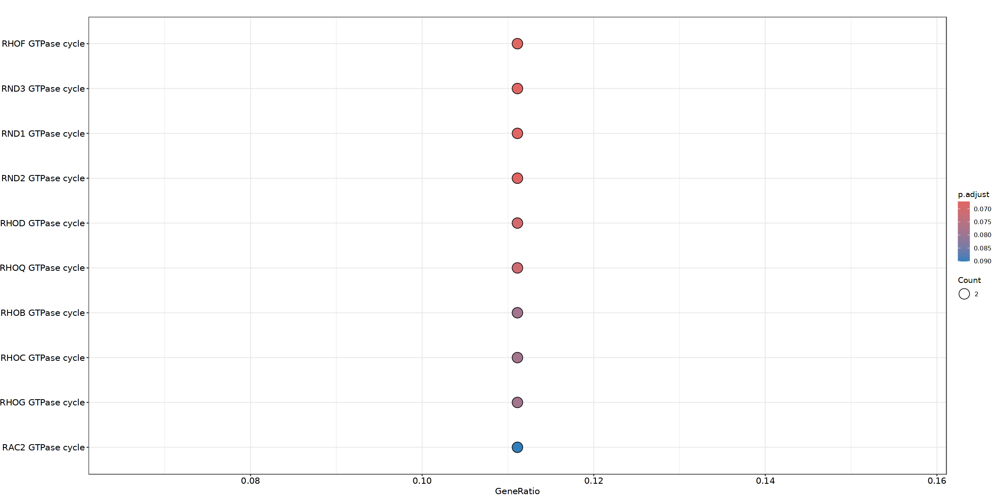

In [618]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [619]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 8 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


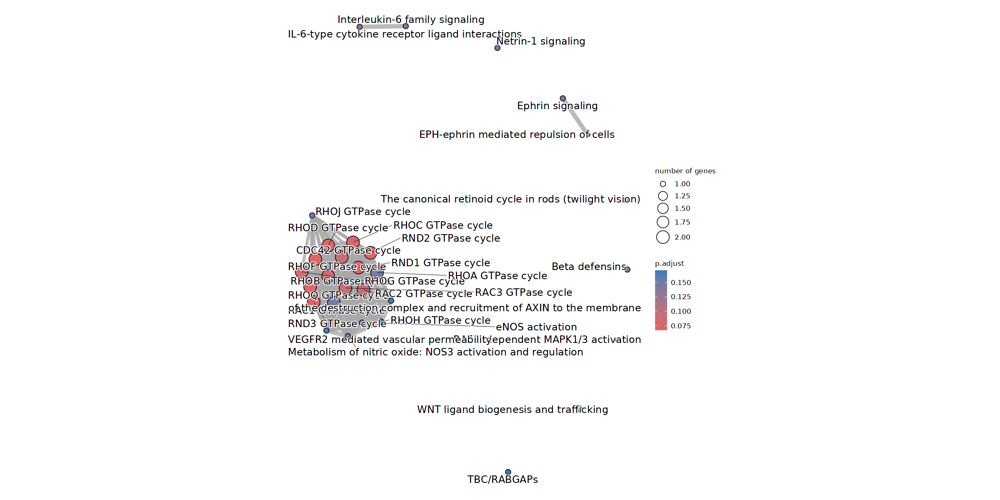

In [620]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 4

In [621]:
highest_cat <- "Early"
second_highest_cat <- "Ctrl"

In [622]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [623]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [624]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [625]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [626]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [627]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [628]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [629]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [630]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [631]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [632]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [633]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:43] "224079" "22061" "14765" "73040" "19263" "53896" "69351" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...2 enriched terms found
'data.frame':	2 obs. of  9 variables:
 $ ID         : chr  "R-MMU-191273" "R-MMU-8957322"
 $ Description: chr  "Cholesterol biosynthesis" "Metabolism of steroids"
 $ GeneRatio  : chr  "7/21" "7/21"
 $ BgRatio    : chr  "27/8582" "126/8582"
 $ pvalue     : num  1.48e-13 1.22e-08
 $ p.adjust   : num  9.32e-12 3.84e-07
 $ qvalue     : num  8.72e-12 3.59e-07
 $ geneID     : chr  "Fdps/Mvd/Idi1/Dhcr24/Sqle/Cyp51/Msmo1" "Fdps/Mvd/Idi1/Dhcr24/Sqle/Cyp51/Msmo1"
 $ Count      : int  7 7
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


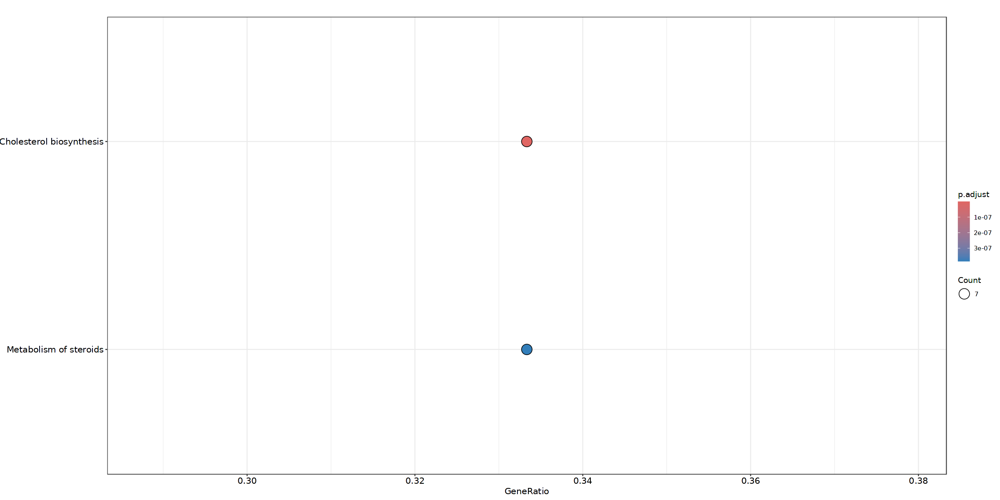

In [634]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [635]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

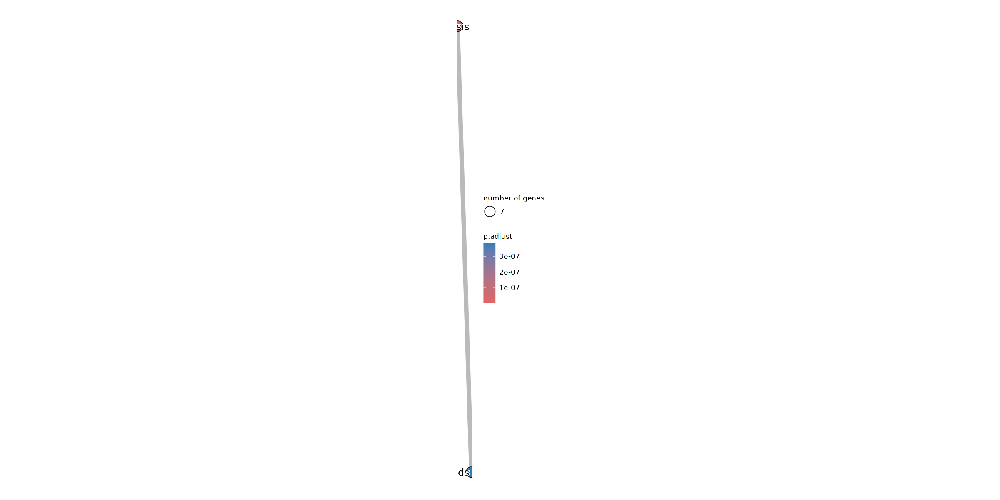

In [636]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [637]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [638]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:43] "224079" "22061" "14765" "73040" "19263" "53896" "69351" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...63 enriched terms found
'data.frame':	63 obs. of  9 variables:
 $ ID         : chr  "R-MMU-191273" "R-MMU-8957322" "R-MMU-8963693" "R-MMU-982772" ...
 $ Description: chr  "Cholesterol biosynthesis" "Metabolism of steroids" "Aspartate and asparagine metabolism" "Growth hormone receptor signaling" ...
 $ GeneRatio  : chr  "7/21" "7/21" "1/21" "1/21" ...
 $ BgRatio    : chr  "27/8582" "126/8582" "11/8582" "11/8582" ...
 $ pvalue     : num  1.48e-13 1.22e-08 2.66e-02 2.66e-02 3.37e-02 ...
 $ p.adjust   : num  9.32e-12 3.84e-07 3.54e-01 3.54e-01 3.54e-01 ...
 $ qvalue     : num  8.72e-12 3.59e-07 3.32e-01 3.32e-01 3.32e-01 ...
 $ geneID     : chr  "Fdps/Mvd/Idi1/Dhcr24/Sqle/Cyp51/Msmo1" "Fdps/Mvd/Idi1/Dhcr24/Sqle/Cyp51/Msmo1" "Naalad2" "Prlr" ...
 $ Count 

In [639]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

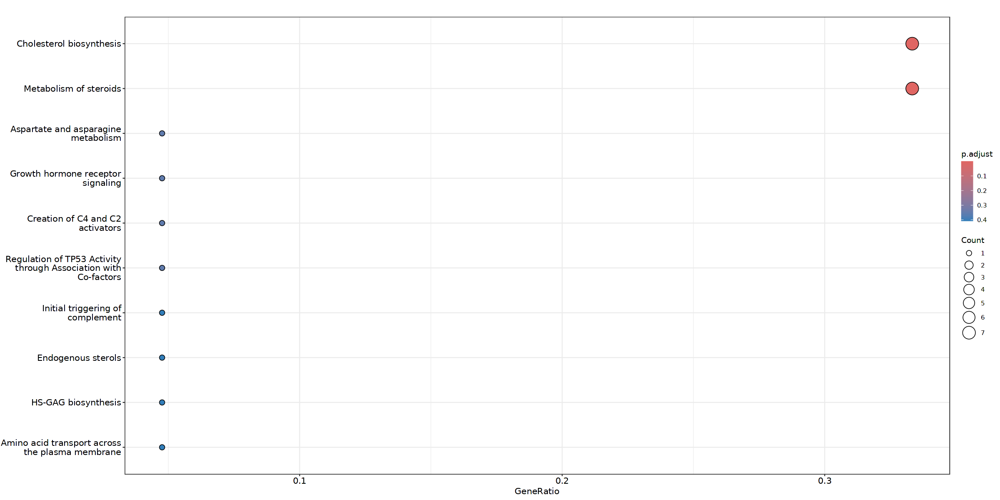

In [640]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [641]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

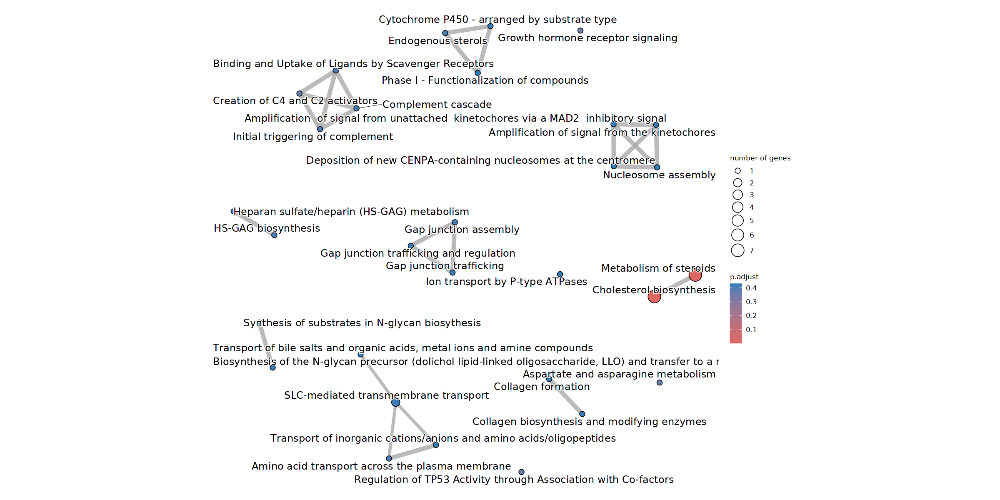

In [642]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 5

In [643]:
highest_cat <- "Early"
second_highest_cat <- "Peak"

In [644]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [645]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [646]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [647]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [648]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [649]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [650]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [651]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [652]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [653]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [654]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [655]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:43] "80982" "171530" "75750" "381677" "240239" "14161" "19259" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...2 enriched terms found
'data.frame':	2 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8957275" "R-MMU-381426"
 $ Description: chr  "Post-translational protein phosphorylation" "Regulation of Insulin-like Growth Factor (IGF) transport and uptake by Insulin-like Growth Factor Binding Proteins (IGFBPs)"
 $ GeneRatio  : chr  "4/21" "4/21"
 $ BgRatio    : chr  "114/8582" "120/8582"
 $ pvalue     : num  0.000148 0.000181
 $ p.adjust   : num  0.00887 0.00887
 $ qvalue     : num  0.00648 0.00648
 $ geneID     : chr  "Vgf/Fga/Timp1/Tnc" "Vgf/Fga/Timp1/Tnc"
 $ Count      : int  4 4
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479

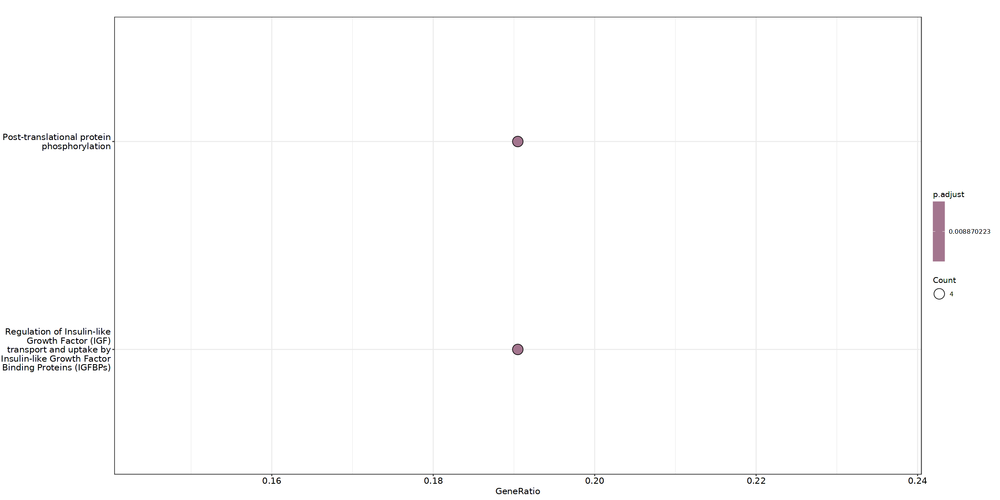

In [656]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [657]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

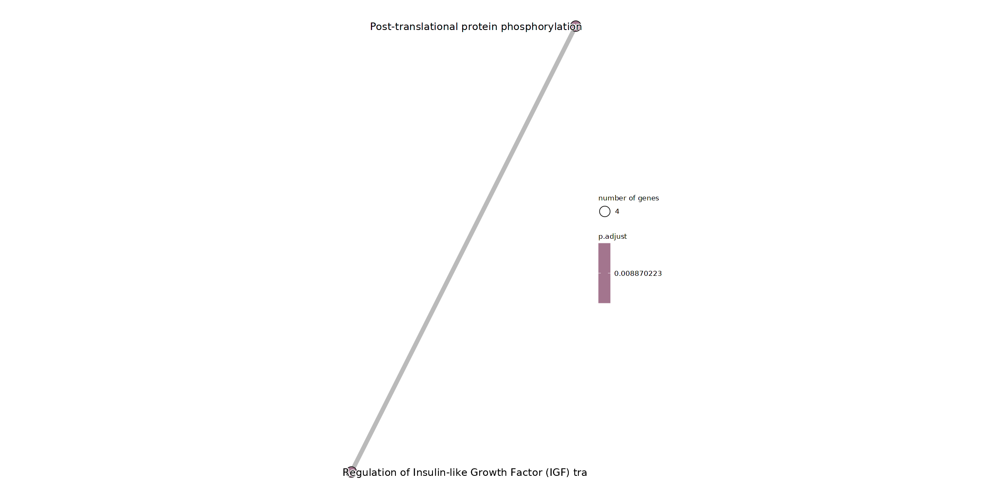

In [658]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [659]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [660]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:43] "80982" "171530" "75750" "381677" "240239" "14161" "19259" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...98 enriched terms found
'data.frame':	98 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8957275" "R-MMU-381426" "R-MMU-109704" "R-MMU-112399" ...
 $ Description: chr  "Post-translational protein phosphorylation" "Regulation of Insulin-like Growth Factor (IGF) transport and uptake by Insulin-like Growth Factor Binding Proteins (IGFBPs)" "PI3K Cascade" "IRS-mediated signalling" ...
 $ GeneRatio  : chr  "4/21" "4/21" "2/21" "2/21" ...
 $ BgRatio    : chr  "114/8582" "120/8582" "41/8582" "42/8582" ...
 $ pvalue     : num  0.000148 0.000181 0.004415 0.004629 0.005532 ...
 $ p.adjust   : num  0.00887 0.00887 0.07364 0.07364 0.07364 ...
 $ qvalue     : num  0.00648 0.00648 0.05379 0.05379 0.05379 ...
 $ geneID     : chr  "Vgf/Fga/Timp1/Tnc" "Vgf/Fga/Tim

In [661]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

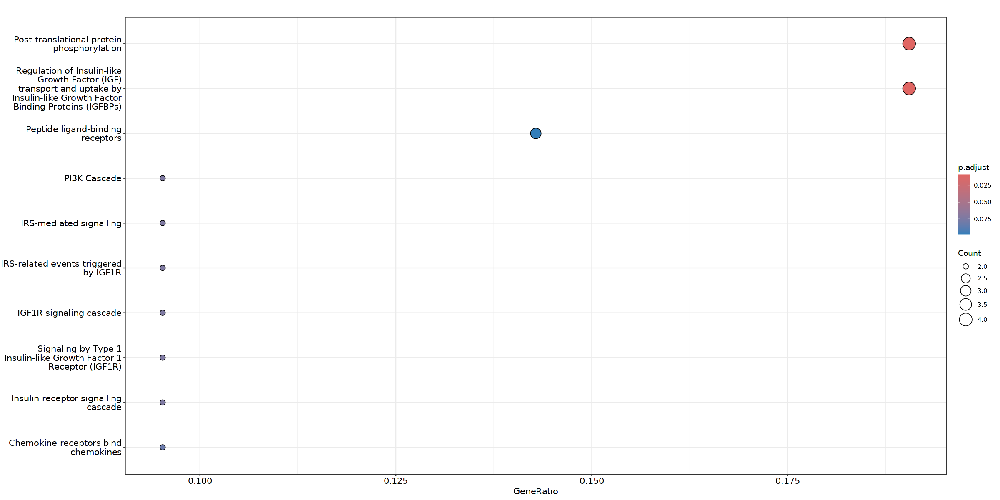

In [662]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [663]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

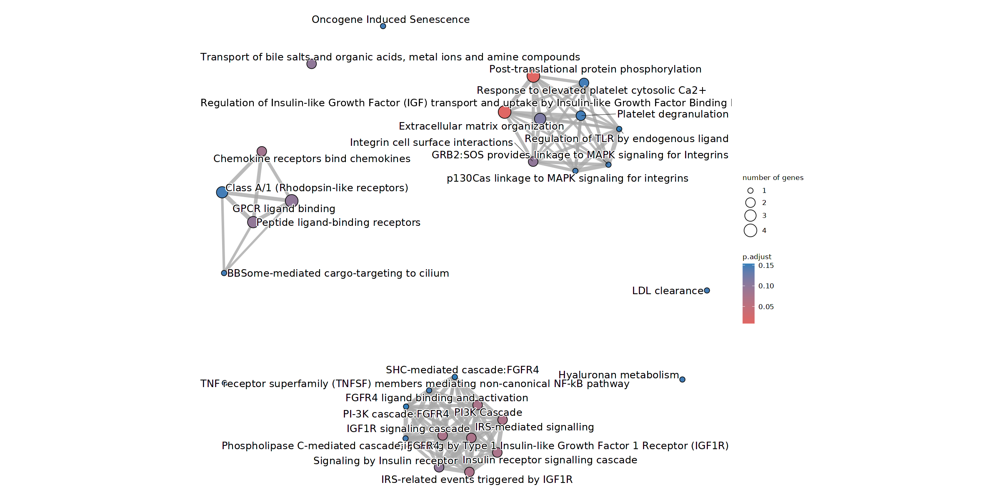

In [664]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 6

In [665]:
highest_cat <- "Early"
second_highest_cat <- "Late"

In [666]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [667]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [668]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [669]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [670]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [671]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [672]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [673]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [674]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [675]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [676]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [677]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:29] "114332" "11910" "14432" "319317" "14559" "16519" "233424" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [678]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [679]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:29] "114332" "11910" "14432" "319317" "14559" "16519" "233424" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...77 enriched terms found
'data.frame':	77 obs. of  9 variables:
 $ ID         : chr  "R-MMU-69166" "R-MMU-2160916" "R-MMU-69183" "R-MMU-174437" ...
 $ Description: chr  "Removal of the Flap Intermediate" "Hyaluronan uptake and degradation" "Processive synthesis on the lagging strand" "Removal of the Flap Intermediate from the C-strand" ...
 $ GeneRatio  : chr  "1/9" "1/9" "1/9" "1/9" ...
 $ BgRatio    : chr  "11/8582" "12/8582" "12/8582" "13/8582" ...
 $ pvalue     : num  0.0115 0.0125 0.0125 0.0136 0.0156 ...
 $ p.adjust   : num  0.129 0.129 0.129 0.129 0.129 ...
 $ qvalue     : num  0.0898 0.0898 0.0898 0.0898 0.0898 ...
 $ geneID     : chr  "Dna2" "Lyve1" "Dna2" "Dna2" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu,

In [680]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

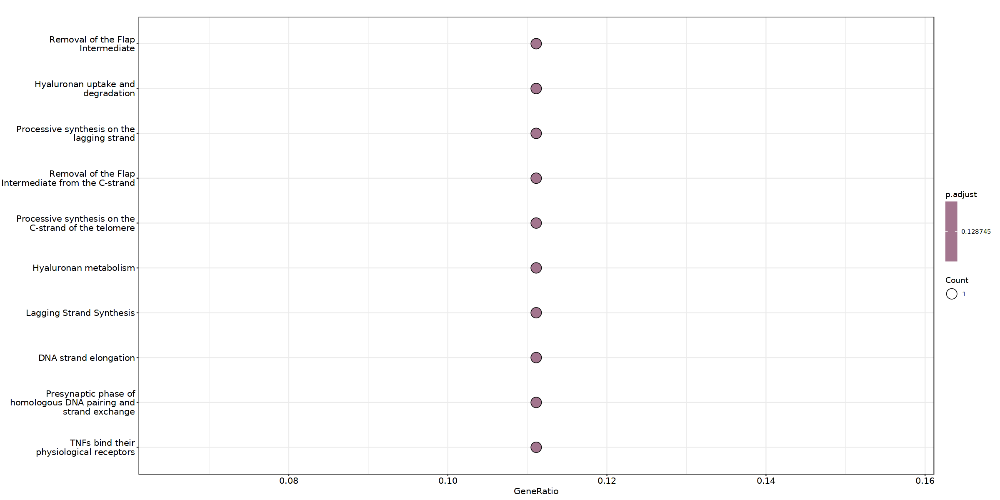

In [681]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [682]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 3 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


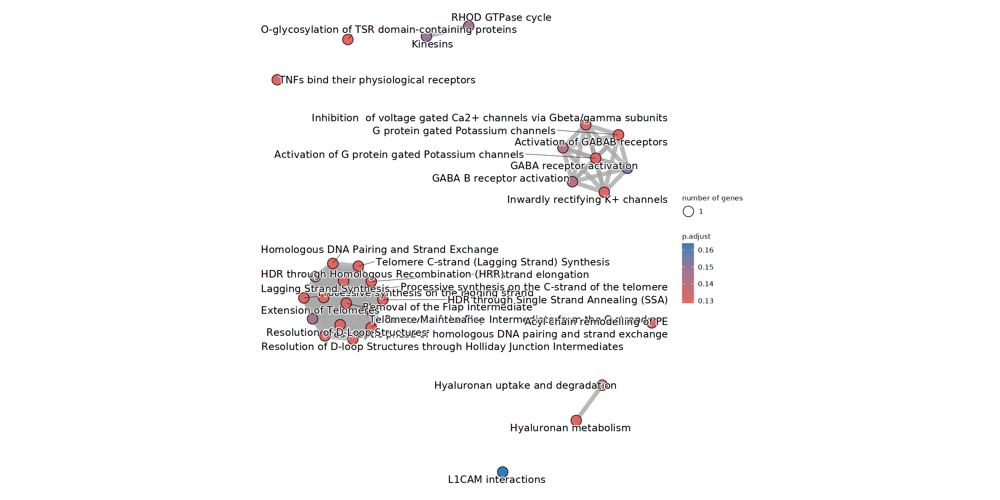

In [683]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 7

In [684]:
highest_cat <- "Peak"
second_highest_cat <- "Ctrl"

In [685]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [686]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [687]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [688]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [689]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [690]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [691]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [692]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [693]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [694]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [695]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [696]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:37] "77220" "24066" "13004" "66717" "399603" "239618" "20965" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [697]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [698]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:37] "77220" "24066" "13004" "66717" "399603" "239618" "20965" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...66 enriched terms found
'data.frame':	66 obs. of  9 variables:
 $ ID         : chr  "R-MMU-3769402" "R-MMU-112316" "R-MMU-2022923" "R-MMU-4641265" ...
 $ Description: chr  "Deactivation of the beta-catenin transactivating complex" "Neuronal System" "Dermatan sulfate biosynthesis" "Repression of WNT target genes" ...
 $ GeneRatio  : chr  "2/15" "3/15" "1/15" "1/15" ...
 $ BgRatio    : chr  "30/8582" "323/8582" "10/8582" "10/8582" ...
 $ pvalue     : num  0.00121 0.01716 0.01735 0.01735 0.01907 ...
 $ p.adjust   : num  0.0796 0.1448 0.1448 0.1448 0.1448 ...
 $ qvalue     : num  0.0584 0.1062 0.1062 0.1062 0.1062 ...
 $ geneID     : chr  "Tcf7l1/Sox13" "Syn2/Gabrb3/Kcnb1" "Ncan" "Tcf7l1" ...
 $ Count      : int  2 3 1 1 1 1 1 2 1 1 ...
#...Citation
  Gu

In [699]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

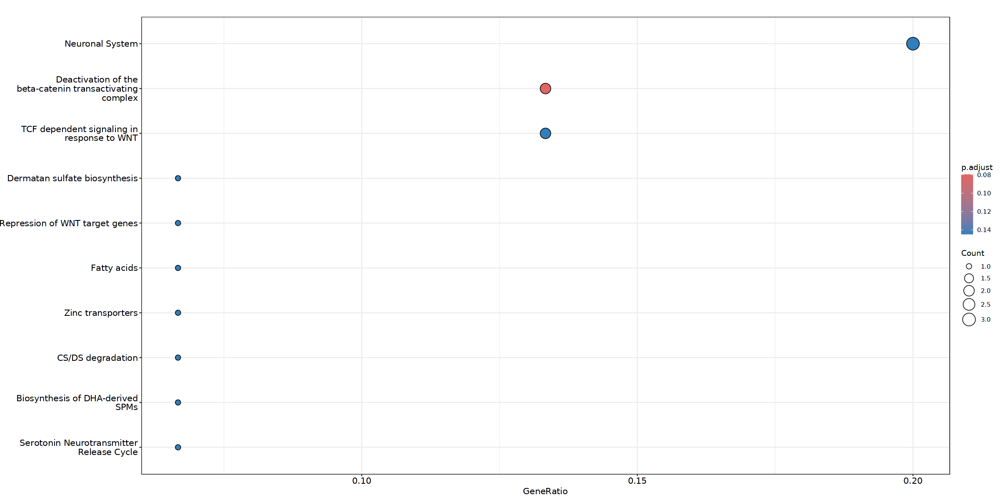

In [700]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [701]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

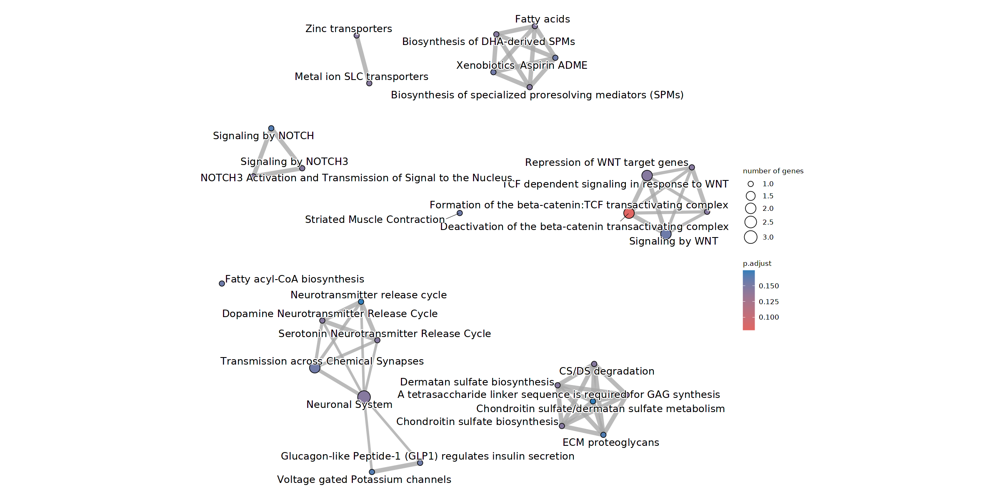

In [702]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 8

In [703]:
highest_cat <- "Peak"
second_highest_cat <- "Early"

In [704]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [705]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [706]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [707]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [708]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [709]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [710]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [711]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [712]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [713]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [714]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [715]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:47] "69065" "14573" "20715" "628900" "237886" "69068" "238393" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [716]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [717]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:47] "69065" "14573" "20715" "628900" "237886" "69068" "238393" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...166 enriched terms found
'data.frame':	166 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1169410" "R-MMU-913531" "R-MMU-450408" "R-MMU-9833482" ...
 $ Description: chr  "Antiviral mechanism by IFN-stimulated genes" "Interferon Signaling" "AUF1 (hnRNP D0) binds and destabilizes mRNA" "PKR-mediated signaling" ...
 $ GeneRatio  : chr  "3/18" "3/18" "2/18" "2/18" ...
 $ BgRatio    : chr  "91/8582" "131/8582" "56/8582" "64/8582" ...
 $ pvalue     : num  0.000839 0.002398 0.005984 0.007756 0.00897 ...
 $ p.adjust   : num  0.139 0.199 0.258 0.258 0.258 ...
 $ qvalue     : num  0.128 0.183 0.237 0.237 0.237 ...
 $ geneID     : chr  "Isg15/Sphk1/Oasl1" "Isg15/Sphk1/Oasl1" "Psmb8/Hspb1" "Isg15/Sphk1" ...
 $ Count      : int  3 3 2 2 2 2 4 2 2 2 ...
#...Ci

In [718]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

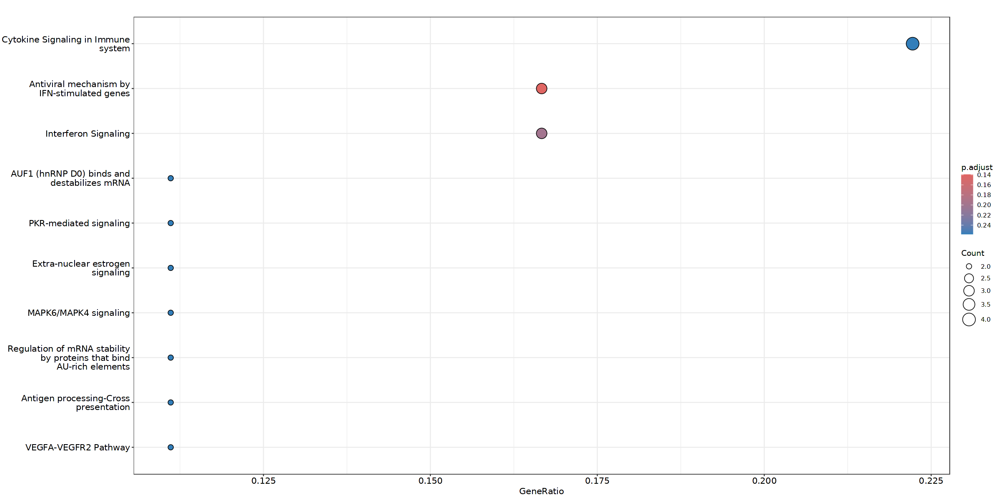

In [719]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [720]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 2 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


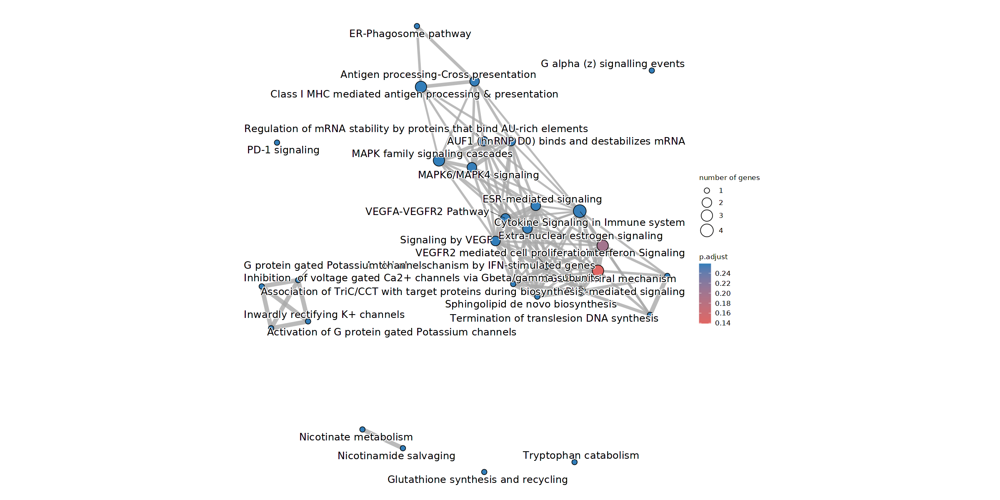

In [721]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 9

In [722]:
highest_cat <- "Peak"
second_highest_cat <- "Late"

In [723]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [724]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [725]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [726]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [727]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [728]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [729]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [730]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [731]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [732]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [733]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [734]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:44] "223672" "71898" "225594" "99899" "66815" "23960" "276950" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...10 enriched terms found
'data.frame':	10 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236977" "R-MMU-1236974" "R-MMU-1236975" "R-MMU-983170" ...
 $ Description: chr  "Endosomal/Vacuolar pathway" "ER-Phagosome pathway" "Antigen processing-Cross presentation" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "4/19" "4/19" "5/19" "4/19" ...
 $ BgRatio    : chr  "24/8582" "33/8582" "91/8582" "40/8582" ...
 $ pvalue     : num  1.77e-07 6.74e-07 1.24e-06 1.49e-06 8.27e-06 ...
 $ p.adjust   : num  2.89e-05 5.50e-05 6.08e-05 6.08e-05 2.70e-04 ...
 $ qvalue     : num  2.56e-05 4.86e-05 5.38e-05 5.38e-05 2.38e-04 ...
 $ geneID     : chr  "H2-Q4/H2-Q7/H2-M3/H2-Q6" "H2-Q4/H2-Q7/H2-M3/H2-Q6" "Psmb9/H2-

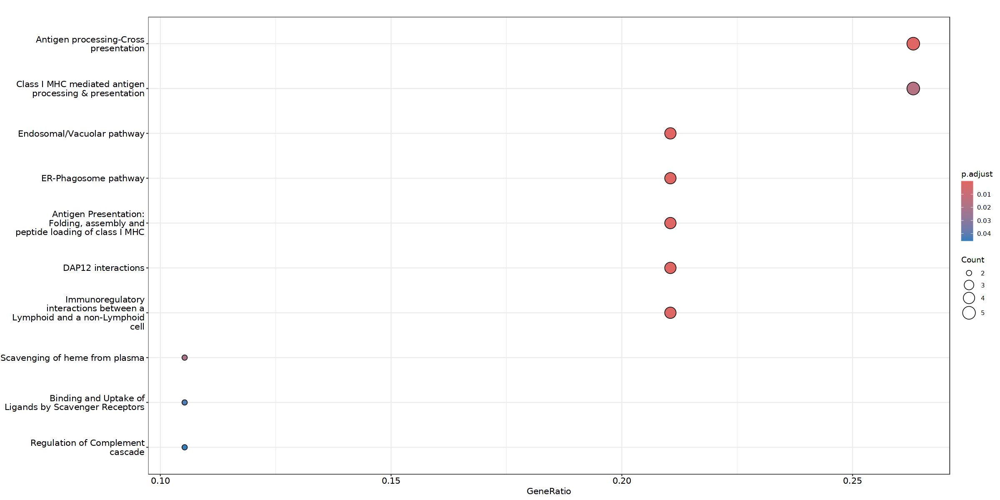

In [735]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [736]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

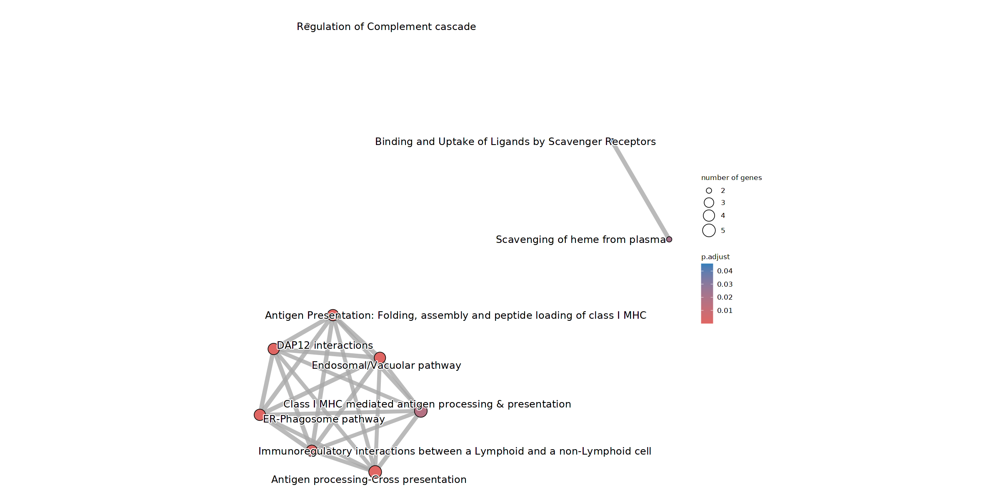

In [737]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [738]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [739]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:44] "223672" "71898" "225594" "99899" "66815" "23960" "276950" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...163 enriched terms found
'data.frame':	163 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236977" "R-MMU-1236974" "R-MMU-1236975" "R-MMU-983170" ...
 $ Description: chr  "Endosomal/Vacuolar pathway" "ER-Phagosome pathway" "Antigen processing-Cross presentation" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "4/19" "4/19" "5/19" "4/19" ...
 $ BgRatio    : chr  "24/8582" "33/8582" "91/8582" "40/8582" ...
 $ pvalue     : num  1.77e-07 6.74e-07 1.24e-06 1.49e-06 8.27e-06 ...
 $ p.adjust   : num  2.89e-05 5.50e-05 6.08e-05 6.08e-05 2.70e-04 ...
 $ qvalue     : num  2.56e-05 4.86e-05 5.38e-05 5.38e-05 2.38e-04 ...
 $ geneID     : chr  "H2-Q4/H2-Q7/H2-M3/H2-Q6" "H2-Q4/H2-Q7/H2-M3/H2-Q6" "Psmb9/H2-Q

In [740]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

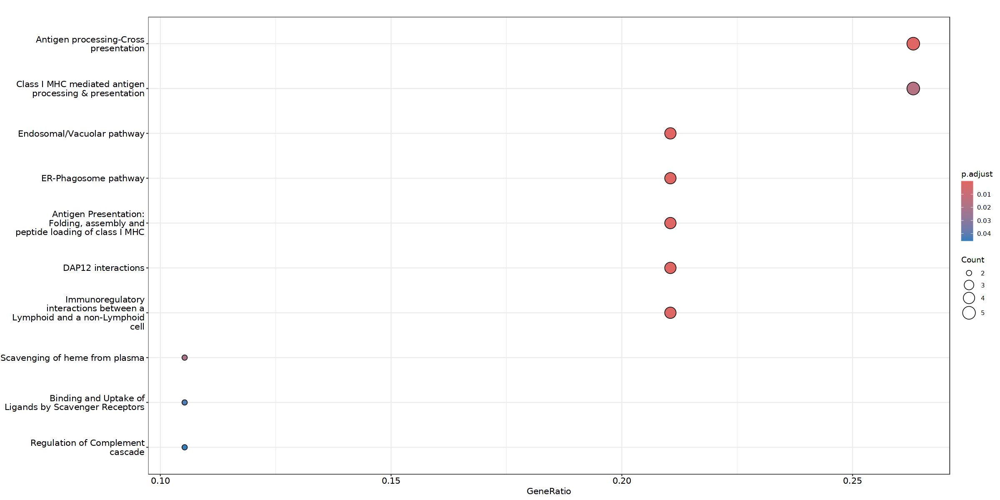

In [741]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [742]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

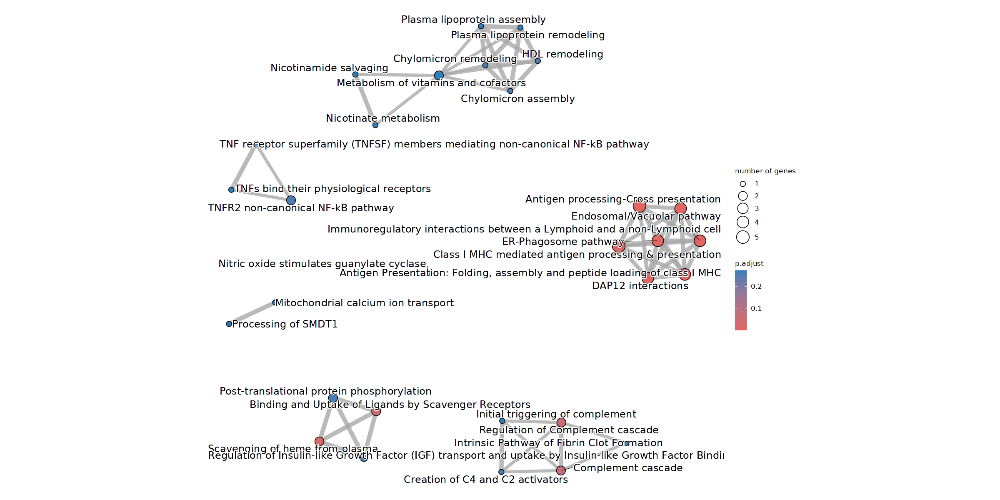

In [743]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 10

In [744]:
highest_cat <- "Late"
second_highest_cat <- "Ctrl"

In [745]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [746]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [747]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [748]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [749]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [750]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [751]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [752]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [753]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [754]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [755]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [756]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:32] "102640891" "94092" "14282" "241489" "240816" "216152" "18053" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [757]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [758]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:32] "102640891" "94092" "14282" "241489" "240816" "216152" "18053" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...52 enriched terms found
'data.frame':	52 obs. of  9 variables:
 $ ID         : chr  "R-MMU-193692" "R-MMU-418457" "R-MMU-8964058" "R-MMU-8963888" ...
 $ Description: chr  "Regulated proteolysis of p75NTR" "cGMP effects" "HDL remodeling" "Chylomicron assembly" ...
 $ GeneRatio  : chr  "1/8" "1/8" "1/8" "1/8" ...
 $ BgRatio    : chr  "10/8582" "10/8582" "10/8582" "11/8582" ...
 $ pvalue     : num  0.00929 0.00929 0.00929 0.01021 0.01021 ...
 $ p.adjust   : num  0.0653 0.0653 0.0653 0.0653 0.0653 ...
 $ qvalue     : num  0.033 0.033 0.033 0.033 0.033 ...
 $ geneID     : chr  "Ngfr" "Pde11a" "Apoe" "Apoe" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome p

In [759]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

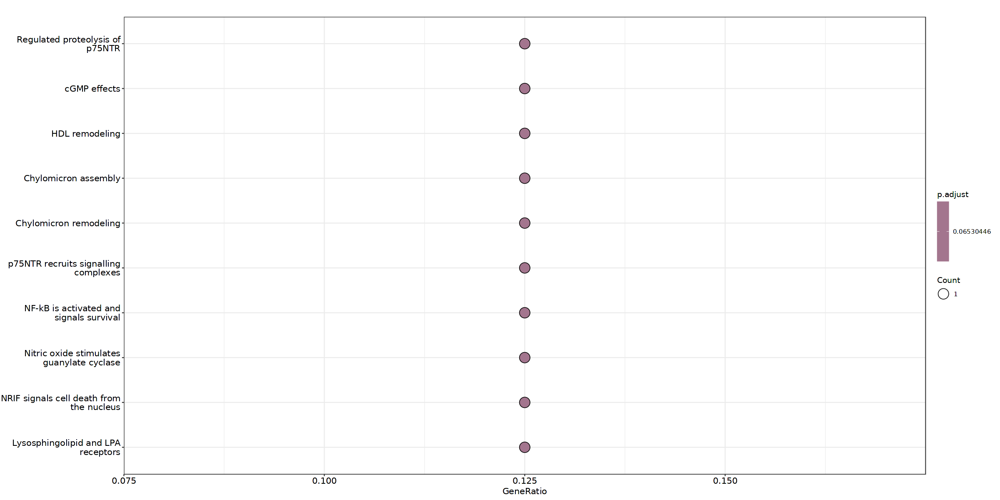

In [760]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [761]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

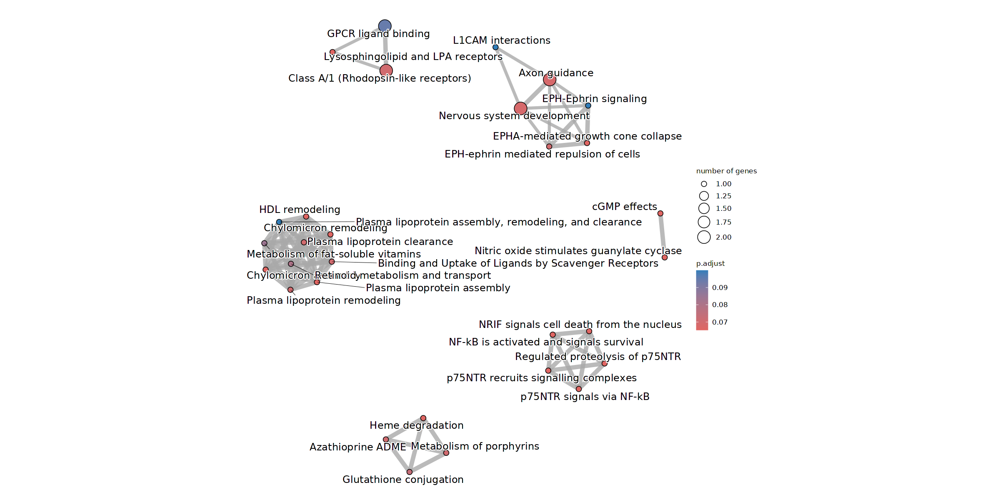

In [762]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 11

In [763]:
highest_cat <- "Late"
second_highest_cat <- "Early"

In [764]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [765]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [766]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [767]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [768]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [769]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [770]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [771]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [772]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [773]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [774]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [775]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:31] "56183" "381835" "18503" "239435" "69824" "629147" "320624" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [776]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [777]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:31] "56183" "381835" "18503" "239435" "69824" "629147" "320624" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...43 enriched terms found
'data.frame':	43 obs. of  9 variables:
 $ ID         : chr  "R-MMU-418594" "R-MMU-203615" "R-MMU-202131" "R-MMU-196757" ...
 $ Description: chr  "G alpha (i) signalling events" "eNOS activation" "Metabolism of nitric oxide: NOS3 activation and regulation" "Metabolism of folate and pterines" ...
 $ GeneRatio  : chr  "3/11" "1/11" "1/11" "1/11" ...
 $ BgRatio    : chr  "274/8582" "11/8582" "14/8582" "16/8582" ...
 $ pvalue     : num  0.00439 0.01402 0.01781 0.02033 0.0226 ...
 $ p.adjust   : num  0.182 0.182 0.182 0.182 0.182 ...
 $ qvalue     : num  0.16 0.16 0.16 0.16 0.16 ...
 $ geneID     : chr  "Nmu/Npb/Gpsm1" "Ddah1" "Ddah1" "Aldh1l2" ...
 $ Count      : int  3 1 1 1 2 1 1 1 2 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu

In [778]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

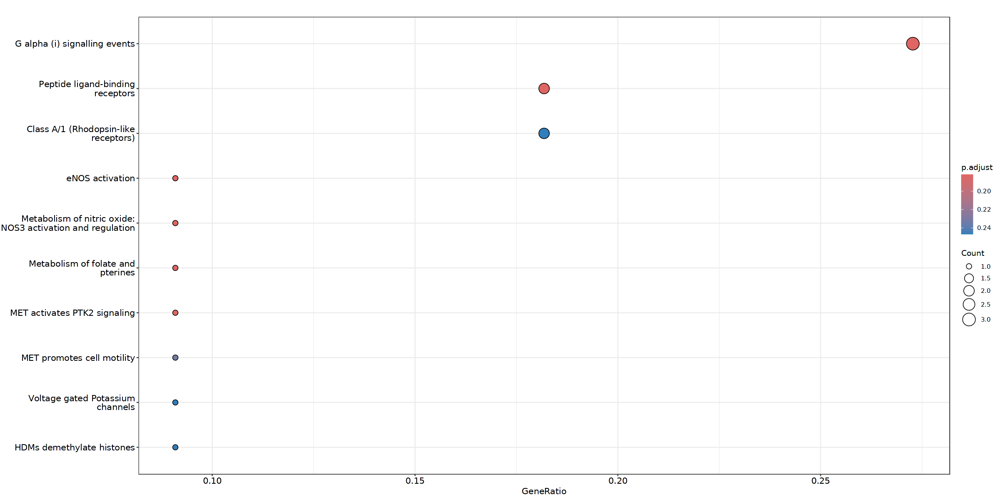

In [779]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [780]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


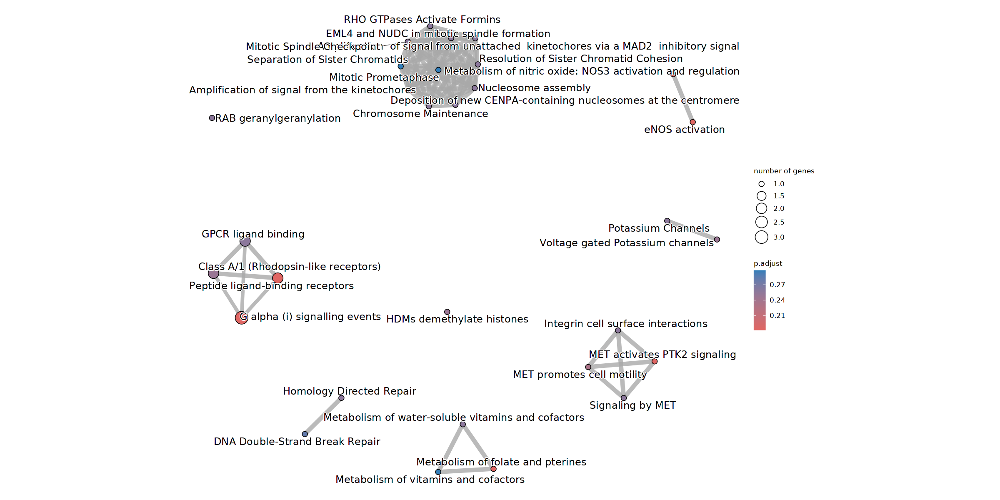

In [781]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 12

In [782]:
highest_cat <- "Late"
second_highest_cat <- "Peak"

In [783]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [784]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [785]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [786]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [787]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [788]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [789]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [790]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [791]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [792]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [793]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [794]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:41] "11727" "12833" "13206" "230959" "12817" "100504720" "57780" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...11 enriched terms found
'data.frame':	11 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8948216" "R-MMU-1442490" "R-MMU-1650814" "R-MMU-1474290" ...
 $ Description: chr  "Collagen chain trimerization" "Collagen degradation" "Collagen biosynthesis and modifying enzymes" "Collagen formation" ...
 $ GeneRatio  : chr  "3/15" "3/15" "3/15" "3/15" ...
 $ BgRatio    : chr  "35/8582" "55/8582" "60/8582" "73/8582" ...
 $ pvalue     : num  2.73e-05 1.07e-04 1.39e-04 2.50e-04 4.79e-04 ...
 $ p.adjust   : num  0.00164 0.00279 0.00279 0.00375 0.00544 ...
 $ qvalue     : num  0.00095 0.00161 0.00161 0.00217 0.00315 ...
 $ geneID     : chr  "Col6a1/Col13a1/Col23a1" "Col6a1/Col13a1/Mmp11" "Col6a1/Col13a1/Col23a1" "Col6a1/Col13a1/Col23a1" ...
 $ Count      :

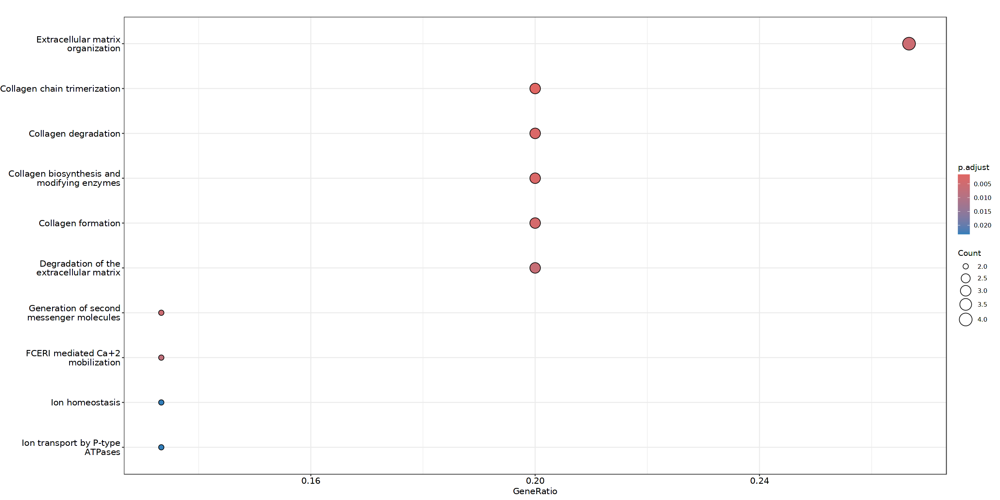

In [795]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [796]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

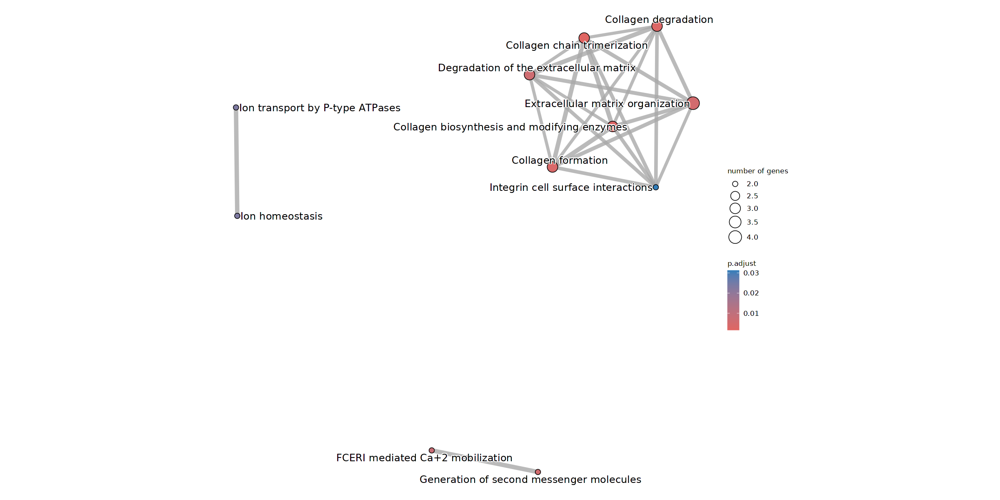

In [797]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [798]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [799]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:41] "11727" "12833" "13206" "230959" "12817" "100504720" "57780" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...60 enriched terms found
'data.frame':	60 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8948216" "R-MMU-1442490" "R-MMU-1650814" "R-MMU-1474290" ...
 $ Description: chr  "Collagen chain trimerization" "Collagen degradation" "Collagen biosynthesis and modifying enzymes" "Collagen formation" ...
 $ GeneRatio  : chr  "3/15" "3/15" "3/15" "3/15" ...
 $ BgRatio    : chr  "35/8582" "55/8582" "60/8582" "73/8582" ...
 $ pvalue     : num  2.73e-05 1.07e-04 1.39e-04 2.50e-04 4.79e-04 ...
 $ p.adjust   : num  0.00164 0.00279 0.00279 0.00375 0.00544 ...
 $ qvalue     : num  0.00095 0.00161 0.00161 0.00217 0.00315 ...
 $ geneID     : chr  "Col6a1/Col13a1/Col23a1" "Col6a1/Col13a1/Mmp11" "Col6a1/Col13a1/Col23a1" "Col6a1/Col13a1/Col23a1" ...
 $ Count      : in

In [800]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_MOL2_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

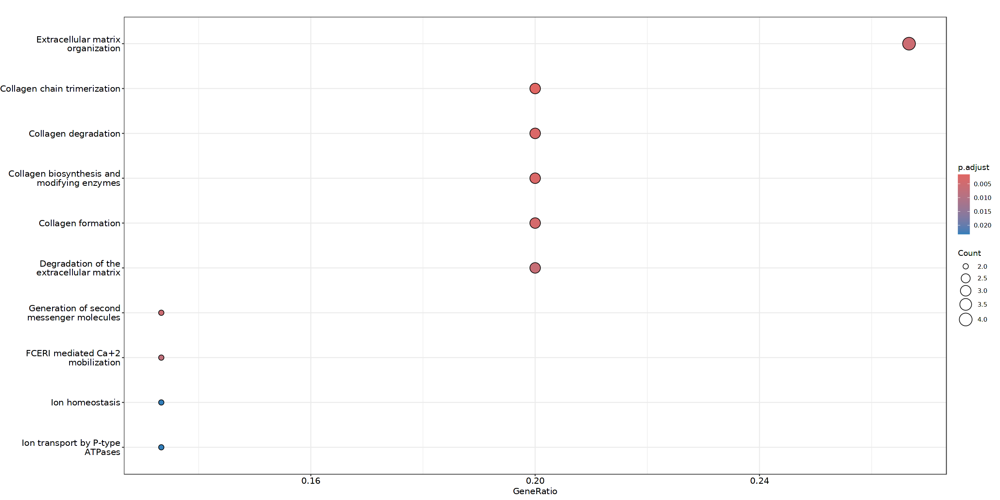

In [801]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [802]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

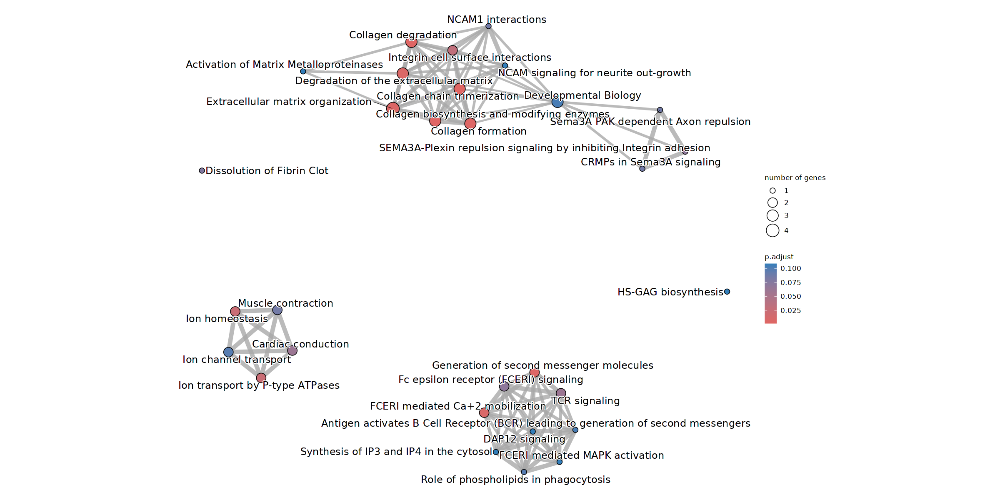

In [803]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

#### 3.1.3 OPC

In [804]:
df_dynamics <- readRDS(paste0(OS_path_outputs, "Dynamics_DGE_RNA_OPC.rds"))

In [805]:
df_dynamics_scaled <- df_dynamics/do.call(pmax, df_dynamics)

##### Category 1

In [806]:
highest_cat <- "Ctrl"

In [807]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [808]:
length(gene_list)

[1] 84

In [809]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [810]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [811]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [812]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [813]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [814]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [815]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [816]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:43] "21333" "77383" "12653" "11535" "240638" "22339" "16527" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [817]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [818]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:43] "21333" "77383" "12653" "11535" "240638" "22339" "16527" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...92 enriched terms found
'data.frame':	92 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1296071" "R-MMU-8957275" "R-MMU-1296346" "R-MMU-381426" ...
 $ Description: chr  "Potassium Channels" "Post-translational protein phosphorylation" "Tandem pore domain potassium channels" "Regulation of Insulin-like Growth Factor (IGF) transport and uptake by Insulin-like Growth Factor Binding Proteins (IGFBPs)" ...
 $ GeneRatio  : chr  "2/17" "2/17" "1/17" "2/17" ...
 $ BgRatio    : chr  "97/8582" "114/8582" "11/8582" "120/8582" ...
 $ pvalue     : num  0.0154 0.0209 0.0216 0.023 0.0255 ...
 $ p.adjust   : num  0.251 0.251 0.251 0.251 0.251 ...
 $ qvalue     : num  0.221 0.221 0.221 0.221 0.221 ...
 $ geneID     : chr  "Kcnk3/Kcnj6" "Chgb/Serpind1" "Kcnk3" "Chgb

In [819]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,".csv"), row.names=FALSE)

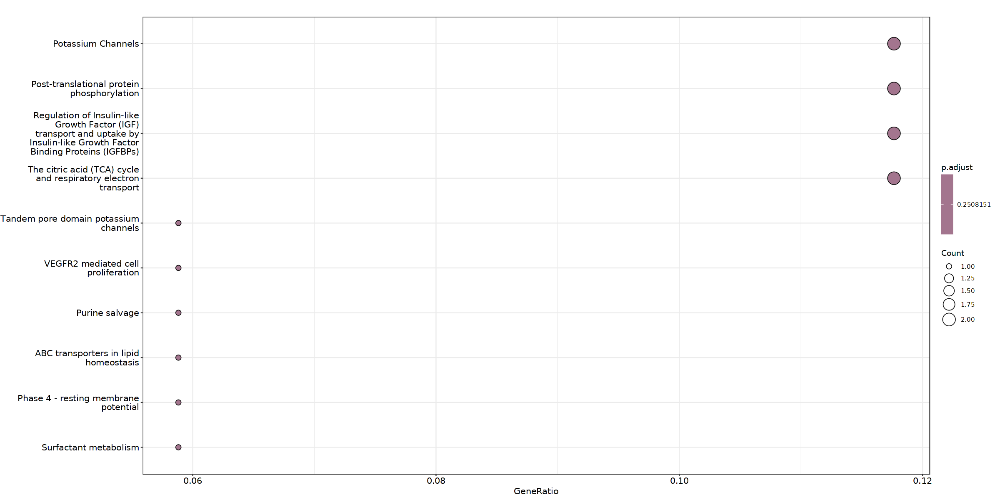

In [820]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [821]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

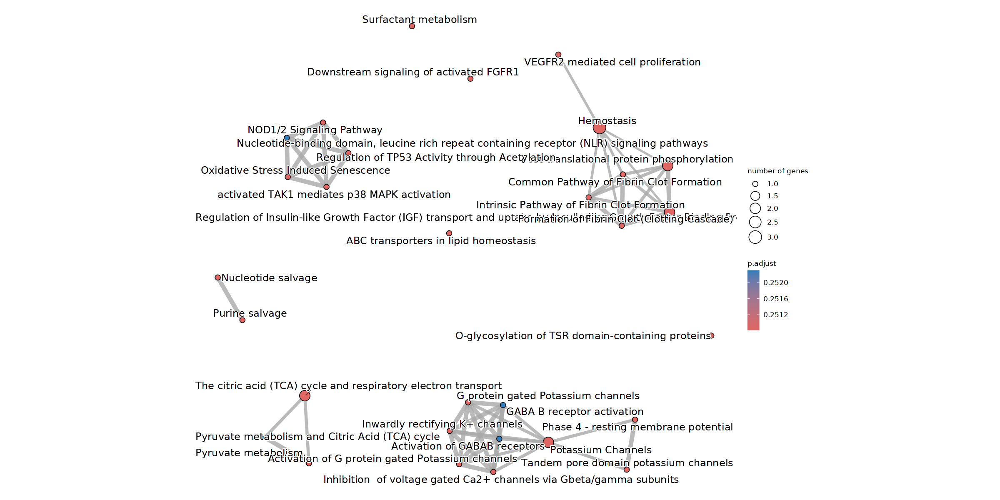

In [822]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Category 2

In [823]:
highest_cat <- "Early"

In [824]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [825]:
length(gene_list)

[1] 232

In [826]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [827]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [828]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [829]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [830]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [831]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [832]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [833]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:48] "15953" "69550" "20296" "16859" "24110" "12051" "55932" "23962" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [834]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [835]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:48] "15953" "69550" "20296" "16859" "24110" "12051" "55932" "23962" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...197 enriched terms found
'data.frame':	197 obs. of  9 variables:
 $ ID         : chr  "R-MMU-9020702" "R-MMU-1169408" "R-MMU-909733" "R-MMU-446652" ...
 $ Description: chr  "Interleukin-1 signaling" "ISG15 antiviral mechanism" "Interferon alpha/beta signaling" "Interleukin-1 family signaling" ...
 $ GeneRatio  : chr  "3/20" "2/20" "2/20" "3/20" ...
 $ BgRatio    : chr  "102/8582" "28/8582" "29/8582" "115/8582" ...
 $ pvalue     : num  0.0016 0.00188 0.00202 0.00226 0.00295 ...
 $ p.adjust   : num  0.0922 0.0922 0.0922 0.0922 0.0922 ...
 $ qvalue     : num  0.0779 0.0779 0.0779 0.0779 0.0779 ...
 $ geneID     : chr  "Usp18/Psmb8/Il1r1" "Usp18/Isg15" "Usp18/Socs3" "Usp18/Psmb8/Il1r1" ...
 $ Count      : int  3 2 2 3 4 5 3 2 2 2 ...
#...Citation
 

In [836]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,".csv"), row.names=FALSE)

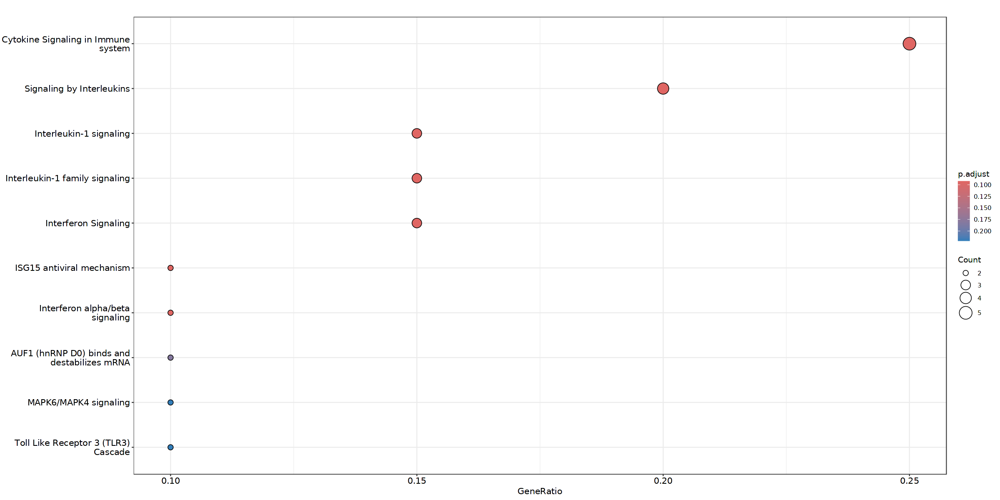

In [837]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [838]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

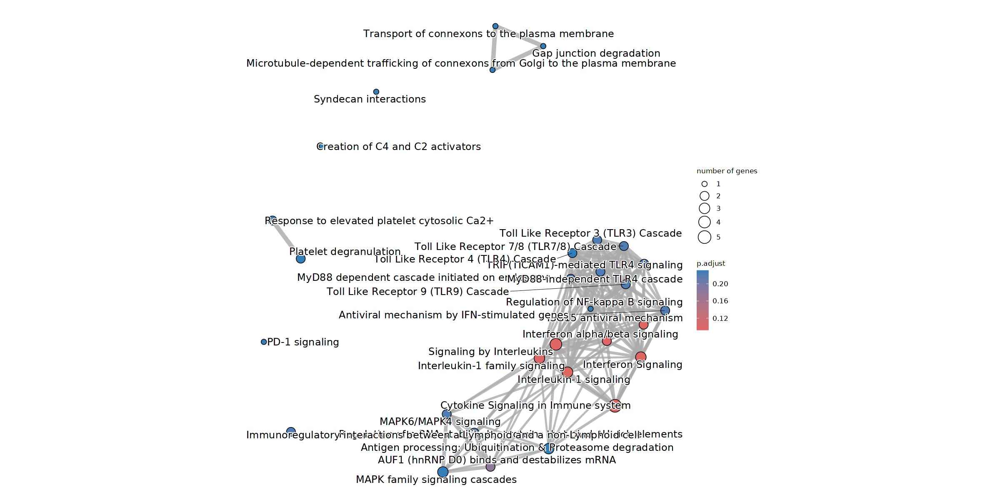

In [839]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Category 3

In [840]:
highest_cat <- "Peak"

In [841]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [842]:
length(gene_list)

[1] 231

In [843]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [844]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [845]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [846]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [847]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [848]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [849]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [850]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:45] "240328" "14469" "225594" "14960" "60440" "15900" "110454" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...11 enriched terms found
'data.frame':	11 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236977" "R-MMU-1236975" "R-MMU-1236974" "R-MMU-983170" ...
 $ Description: chr  "Endosomal/Vacuolar pathway" "Antigen processing-Cross presentation" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "3/17" "4/17" "3/17" "3/17" ...
 $ BgRatio    : chr  "24/8582" "91/8582" "33/8582" "40/8582" ...
 $ pvalue     : num  1.27e-05 2.53e-05 3.40e-05 6.10e-05 2.16e-04 ...
 $ p.adjust   : num  0.00194 0.00194 0.00194 0.00261 0.0074 ...
 $ qvalue     : num  0.00175 0.00175 0.00175 0.00236 0.0067 ...
 $ geneID     : chr  "H2-Q6/H2-Q7/H2-Q4" "H2-Q6/H2-Q7/H2-Q4/Psmb9" "H2-Q6/H2-Q7/H2-Q4" "H2-Q6/H

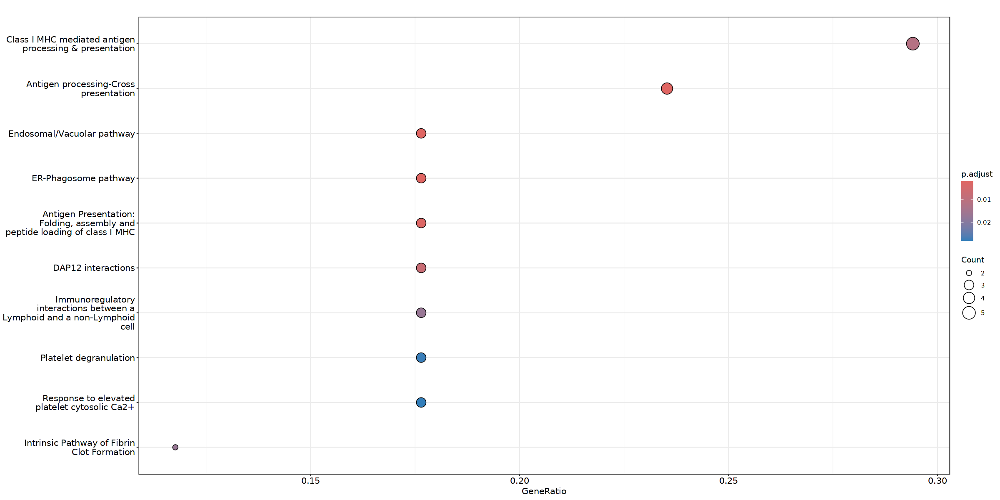

In [851]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [852]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

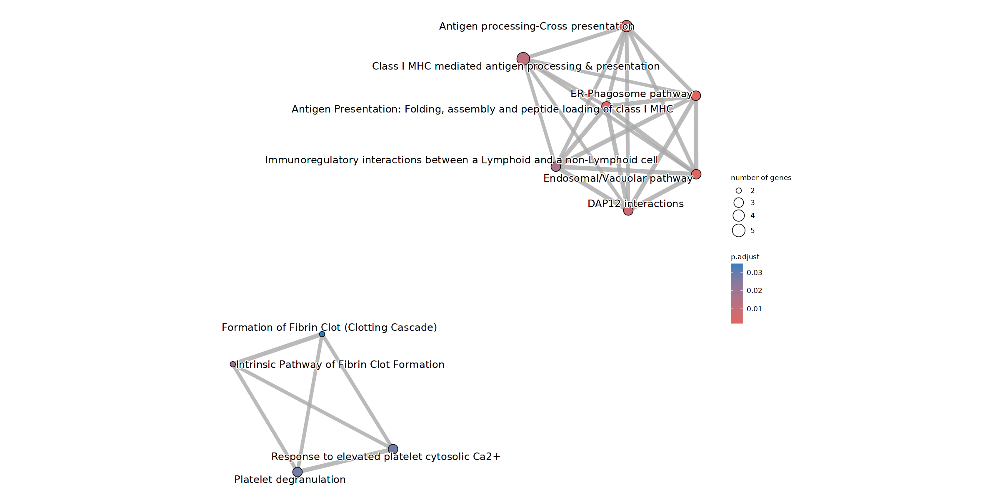

In [853]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [854]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [855]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:45] "240328" "14469" "225594" "14960" "60440" "15900" "110454" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...171 enriched terms found
'data.frame':	171 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1236977" "R-MMU-1236975" "R-MMU-1236974" "R-MMU-983170" ...
 $ Description: chr  "Endosomal/Vacuolar pathway" "Antigen processing-Cross presentation" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "3/17" "4/17" "3/17" "3/17" ...
 $ BgRatio    : chr  "24/8582" "91/8582" "33/8582" "40/8582" ...
 $ pvalue     : num  1.27e-05 2.53e-05 3.40e-05 6.10e-05 2.16e-04 ...
 $ p.adjust   : num  0.00194 0.00194 0.00194 0.00261 0.0074 ...
 $ qvalue     : num  0.00175 0.00175 0.00175 0.00236 0.0067 ...
 $ geneID     : chr  "H2-Q6/H2-Q7/H2-Q4" "H2-Q6/H2-Q7/H2-Q4/Psmb9" "H2-Q6/H2-Q7/H2-Q4" "H2-Q6/H2

In [856]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,".csv"), row.names=FALSE)

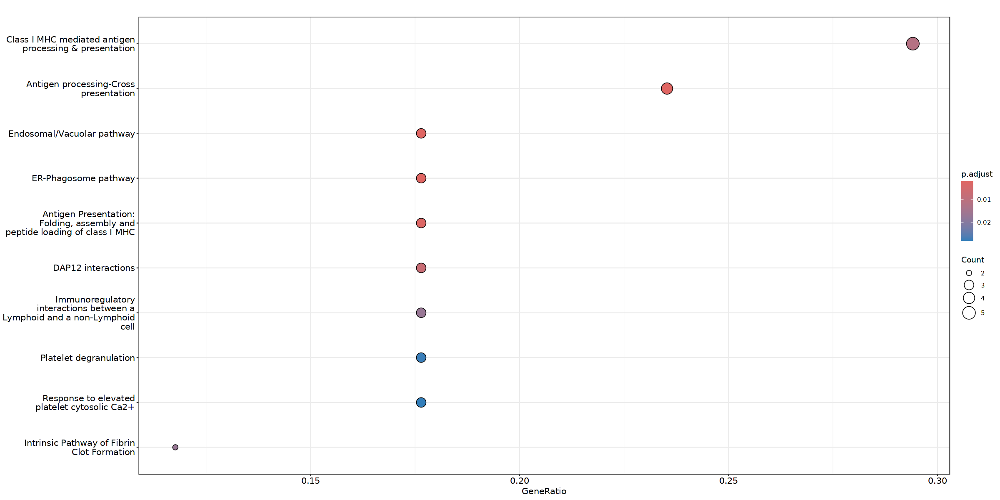

In [857]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [858]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

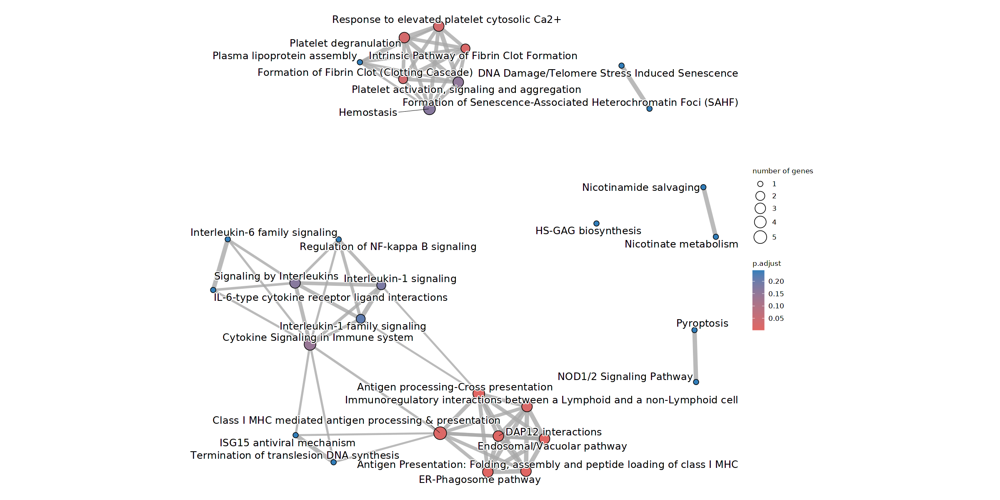

In [859]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Category 4

In [860]:
highest_cat <- "Late"

In [861]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [862]:
length(gene_list)

[1] 43

In [863]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [864]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [865]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [866]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [867]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [868]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [869]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [870]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:42] "117148" "22065" "243764" "242425" "270049" "68027" "72080" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [871]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [872]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:42] "117148" "22065" "243764" "242425" "270049" "68027" "72080" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...91 enriched terms found
'data.frame':	91 obs. of  9 variables:
 $ ID         : chr  "R-MMU-112314" "R-MMU-977444" "R-MMU-991365" "R-MMU-112316" ...
 $ Description: chr  "Neurotransmitter receptors and postsynaptic signal transmission" "GABA B receptor activation" "Activation of GABAB receptors" "Neuronal System" ...
 $ GeneRatio  : chr  "3/21" "2/21" "2/21" "4/21" ...
 $ BgRatio    : chr  "138/8582" "41/8582" "41/8582" "323/8582" ...
 $ pvalue     : num  0.00438 0.00442 0.00442 0.0071 0.00839 ...
 $ p.adjust   : num  0.134 0.134 0.134 0.153 0.153 ...
 $ qvalue     : num  0.105 0.105 0.105 0.12 0.12 ...
 $ geneID     : chr  "Gabbr2/Adcy1/Grip1" "Gabbr2/Adcy1" "Gabbr2/Adcy1" "Gabbr2/Adcy1/Shank1/Grip1" ...
 $ Count      : int  3 2 2 4 2 3 2 1 1 1 ...

In [873]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,".csv"), row.names=FALSE)

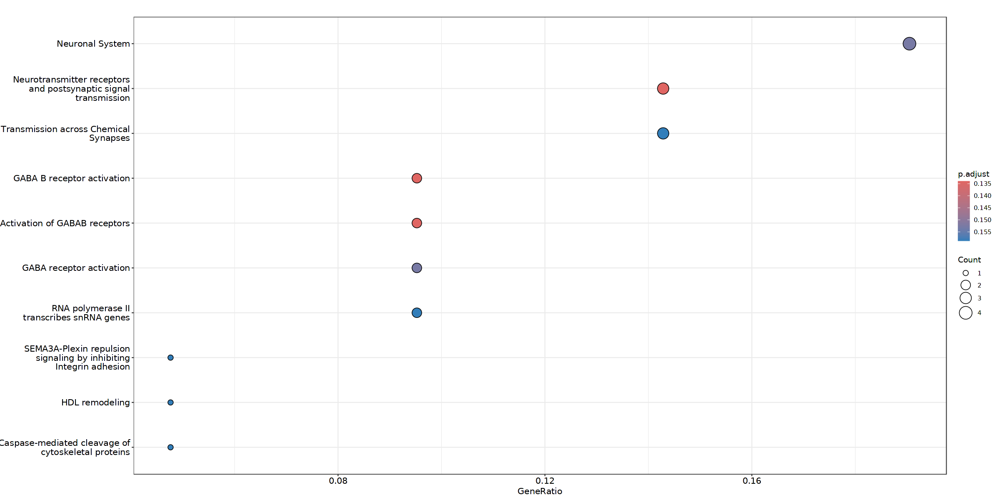

In [874]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [875]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 1 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


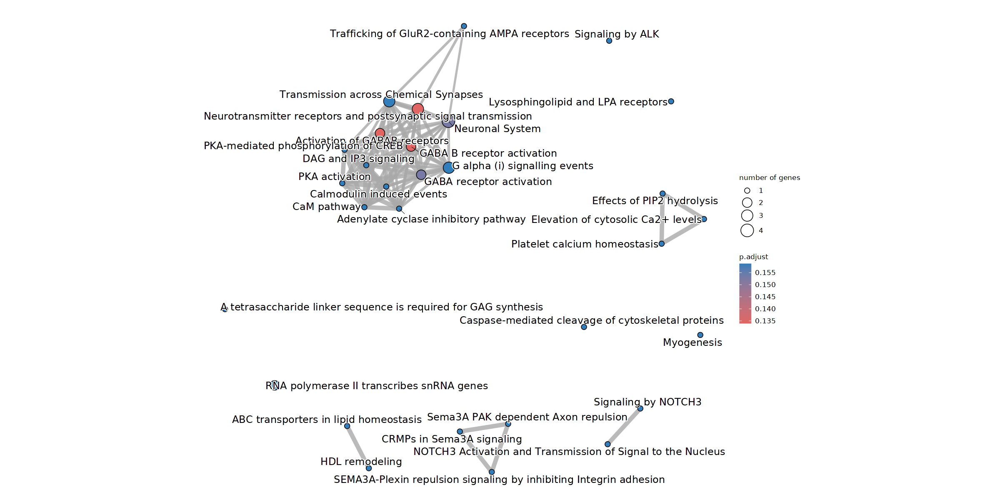

In [876]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 1

In [877]:
highest_cat <- "Ctrl"
second_highest_cat <- "Early"

In [878]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [879]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [880]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [881]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [882]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [883]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [884]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [885]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [886]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [887]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [888]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [889]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:25] "77383" "12653" "11535" "22339" "226359" "67272" "16522" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [890]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [891]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:25] "77383" "12653" "11535" "22339" "226359" "67272" "16522" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...52 enriched terms found
'data.frame':	52 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8957275" "R-MMU-381426" "R-MMU-8964058" "R-MMU-8963888" ...
 $ Description: chr  "Post-translational protein phosphorylation" "Regulation of Insulin-like Growth Factor (IGF) transport and uptake by Insulin-like Growth Factor Binding Proteins (IGFBPs)" "HDL remodeling" "Chylomicron assembly" ...
 $ GeneRatio  : chr  "2/9" "2/9" "1/9" "1/9" ...
 $ BgRatio    : chr  "114/8582" "120/8582" "10/8582" "11/8582" ...
 $ pvalue     : num  0.00592 0.00655 0.01044 0.01148 0.01148 ...
 $ p.adjust   : num  0.101 0.101 0.101 0.101 0.101 ...
 $ qvalue     : num  0.055 0.055 0.055 0.055 0.055 ...
 $ geneID     : chr  "Chgb/Apoe" "Chgb/Apoe" "Apoe" "Apoe" ...
 $ Count      : int 

In [892]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

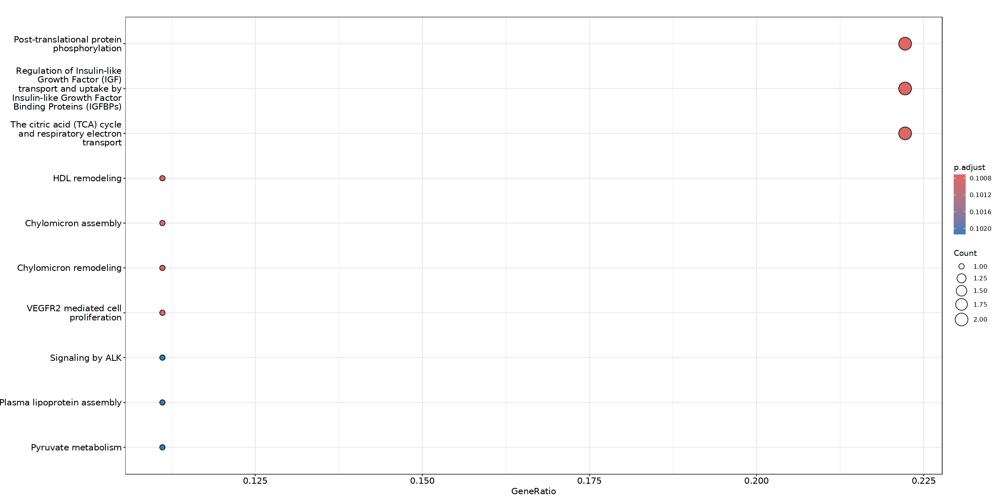

In [893]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [894]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

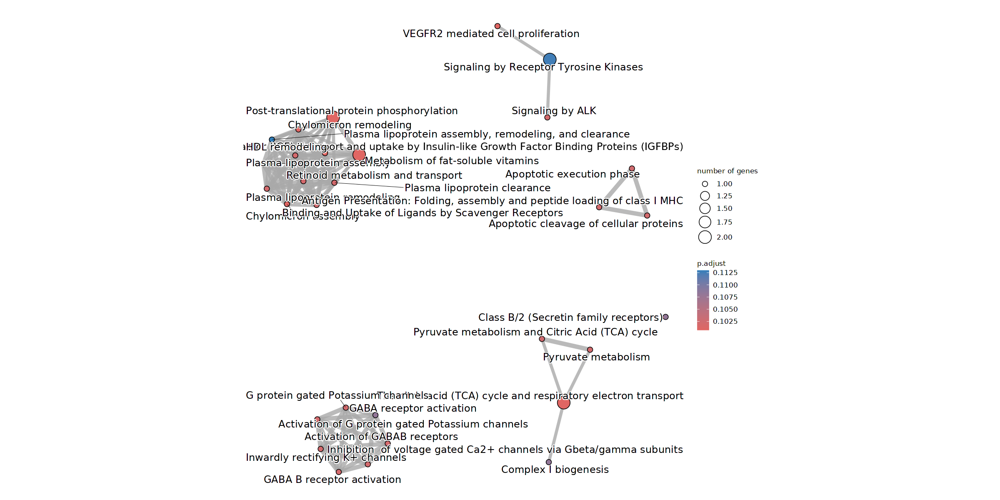

In [895]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 2

In [896]:
highest_cat <- "Ctrl"
second_highest_cat <- "Peak"

In [897]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [898]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [899]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [900]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [901]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [902]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [903]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [904]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [905]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [906]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [907]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [908]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:2] "76184" "330409"
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...2 enriched terms found
'data.frame':	2 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1369062" "R-MMU-382556"
 $ Description: chr  "ABC transporters in lipid homeostasis" "ABC-family proteins mediated transport"
 $ GeneRatio  : chr  "1/1" "1/1"
 $ BgRatio    : chr  "16/8582" "99/8582"
 $ pvalue     : num  0.00186 0.01154
 $ p.adjust   : num  0.00373 0.01154
 $ qvalue     : logi  NA NA
 $ geneID     : chr  "Abca6" "Abca6"
 $ Count      : int  1 1
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


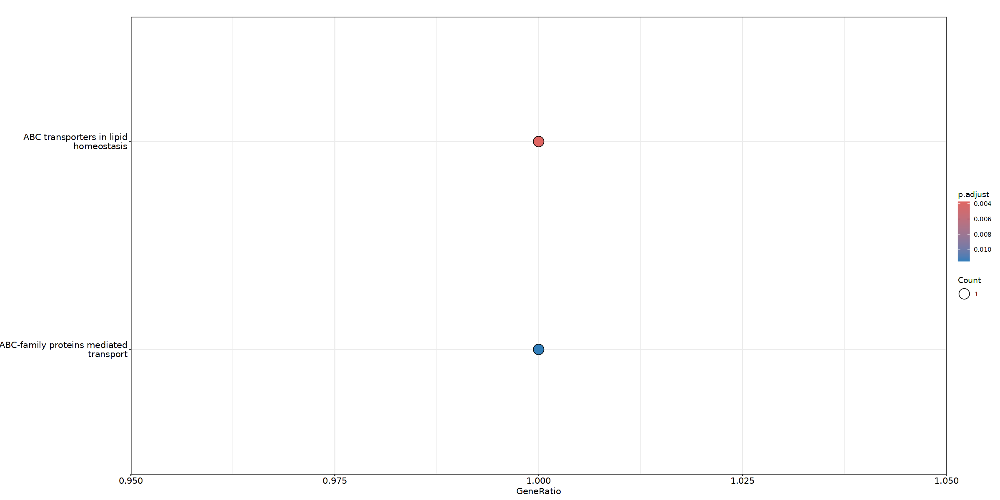

In [909]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [910]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

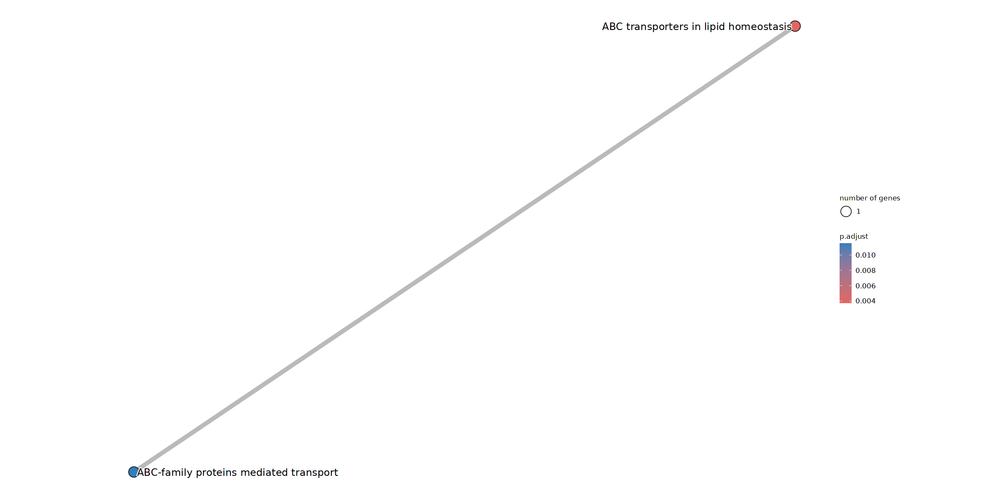

In [911]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [912]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [913]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:2] "76184" "330409"
#...pvalues adjusted by 'fdr' with cutoff <1 
#...2 enriched terms found
'data.frame':	2 obs. of  9 variables:
 $ ID         : chr  "R-MMU-1369062" "R-MMU-382556"
 $ Description: chr  "ABC transporters in lipid homeostasis" "ABC-family proteins mediated transport"
 $ GeneRatio  : chr  "1/1" "1/1"
 $ BgRatio    : chr  "16/8582" "99/8582"
 $ pvalue     : num  0.00186 0.01154
 $ p.adjust   : num  0.00373 0.01154
 $ qvalue     : logi  NA NA
 $ geneID     : chr  "Abca6" "Abca6"
 $ Count      : int  1 1
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [914]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

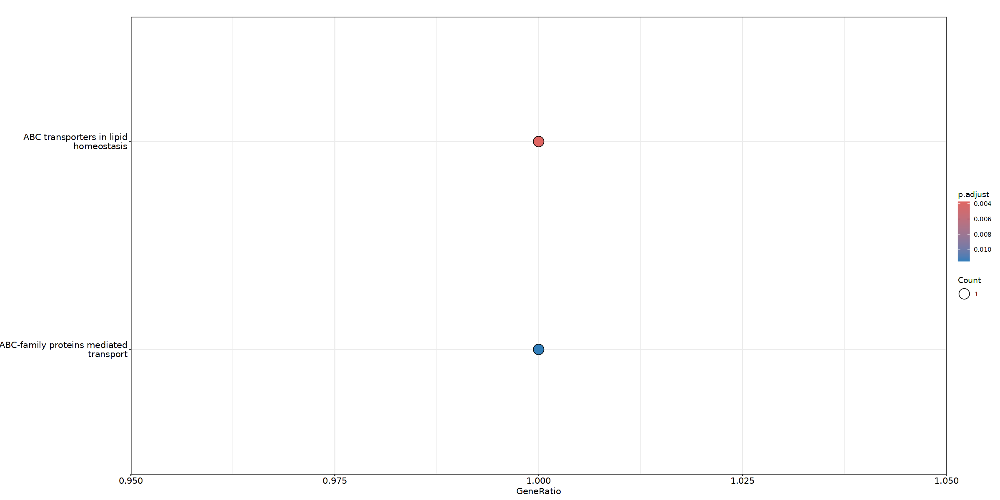

In [915]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [916]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

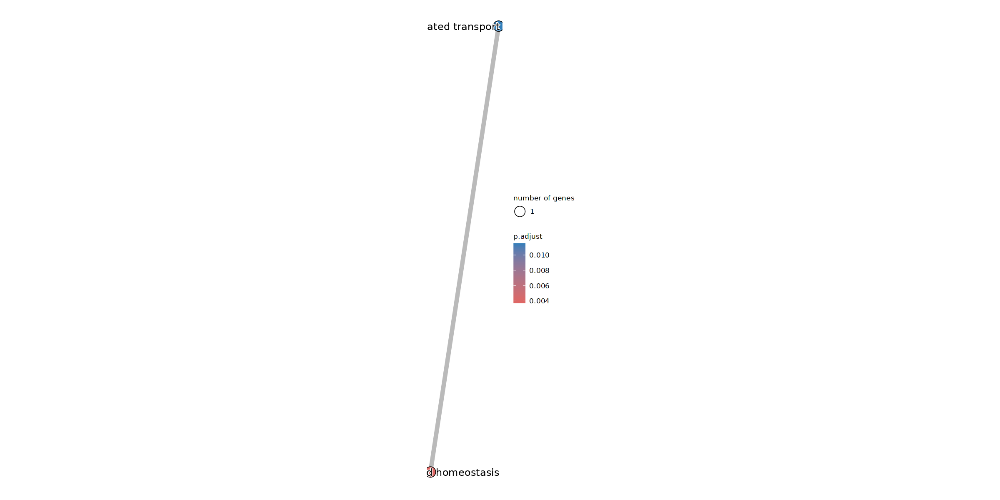

In [917]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 3

In [918]:
highest_cat <- "Ctrl"
second_highest_cat <- "Late"

In [919]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [920]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [921]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [922]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [923]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [924]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [925]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [926]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [927]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [928]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [929]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [930]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:44] "21333" "240638" "16527" "240479" "17285" "26950" "269152" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [931]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [932]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:44] "21333" "240638" "16527" "240479" "17285" "26950" "269152" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...82 enriched terms found
'data.frame':	82 obs. of  9 variables:
 $ ID         : chr  "R-MMU-190873" "R-MMU-1296346" "R-MMU-8856828" "R-MMU-74217" ...
 $ Description: chr  "Gap junction degradation" "Tandem pore domain potassium channels" "Clathrin-mediated endocytosis" "Purine salvage" ...
 $ GeneRatio  : chr  "1/15" "1/15" "2/15" "1/15" ...
 $ BgRatio    : chr  "10/8582" "11/8582" "133/8582" "14/8582" ...
 $ pvalue     : num  0.0174 0.0191 0.0219 0.0242 0.0293 ...
 $ p.adjust   : num  0.236 0.236 0.236 0.236 0.236 ...
 $ qvalue     : num  0.209 0.209 0.209 0.209 0.209 ...
 $ geneID     : chr  "Dab2" "Kcnk3" "Hip1r/Dab2" "Gmpr" ...
 $ Count      : int  1 1 2 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor pa

In [933]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

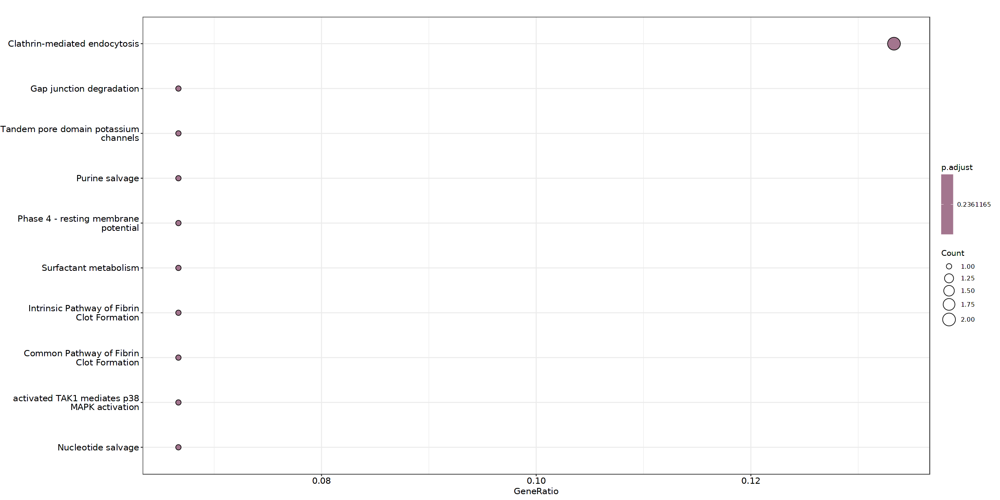

In [934]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [935]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

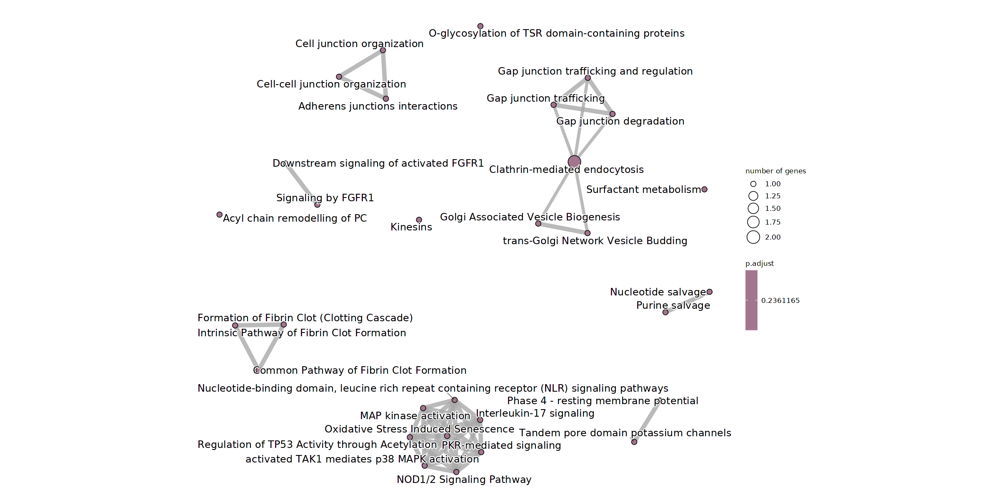

In [936]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 4

In [937]:
highest_cat <- "Early"
second_highest_cat <- "Ctrl"

In [938]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [939]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [940]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [941]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [942]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [943]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [944]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [945]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [946]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [947]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [948]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [949]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:46] "14609" "11606" "16426" "73874" "20971" "107449" "110196" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...2 enriched terms found
'data.frame':	2 obs. of  9 variables:
 $ ID         : chr  "R-MMU-191273" "R-MMU-8957322"
 $ Description: chr  "Cholesterol biosynthesis" "Metabolism of steroids"
 $ GeneRatio  : chr  "16/30" "17/30"
 $ BgRatio    : chr  "27/8582" "126/8582"
 $ pvalue     : num  4.57e-35 2.30e-24
 $ p.adjust   : num  2.88e-33 7.24e-23
 $ qvalue     : num  2.79e-33 7.02e-23
 $ geneID     : chr  "Fdps/Idi1/Msmo1/Nsdhl/Dhcr7/Dhcr24/Sc5d/Hmgcr/Sqle/Fdft1/Cyp51/Hsd17b7/Lss/Ebp/Hmgcs1/Pmvk" "Fdps/Idi1/Msmo1/Nsdhl/Dhcr7/Dhcr24/Stard4/Sc5d/Hmgcr/Sqle/Fdft1/Cyp51/Hsd17b7/Lss/Ebp/Hmgcs1/Pmvk"
 $ Count      : int  16 17
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Mo

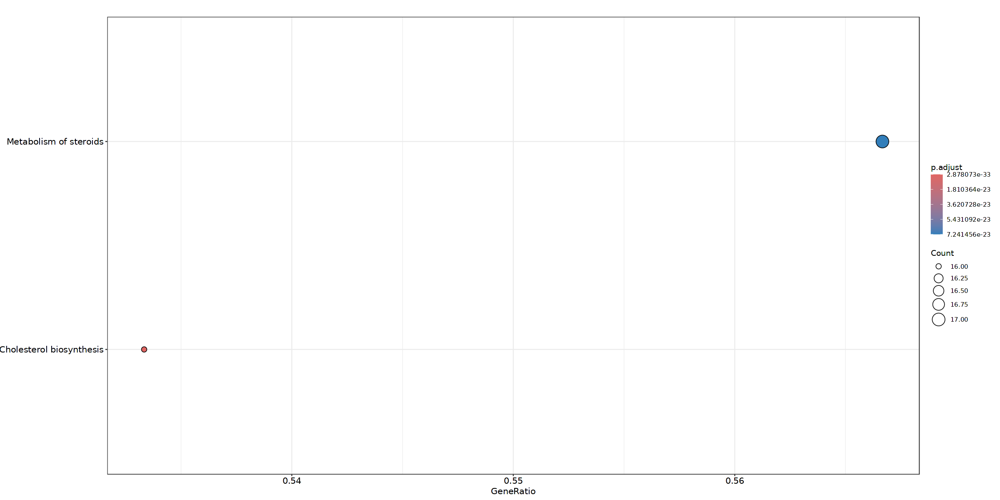

In [950]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [951]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

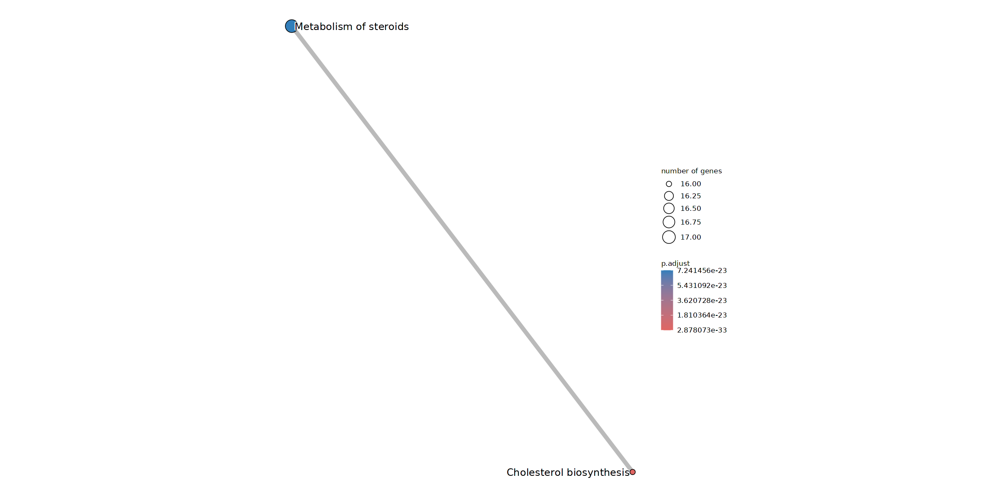

In [952]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [953]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [954]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:46] "14609" "11606" "16426" "73874" "20971" "107449" "110196" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...63 enriched terms found
'data.frame':	63 obs. of  9 variables:
 $ ID         : chr  "R-MMU-191273" "R-MMU-8957322" "R-MMU-190873" "R-MMU-196108" ...
 $ Description: chr  "Cholesterol biosynthesis" "Metabolism of steroids" "Gap junction degradation" "Pregnenolone biosynthesis" ...
 $ GeneRatio  : chr  "16/30" "17/30" "1/30" "1/30" ...
 $ BgRatio    : chr  "27/8582" "126/8582" "10/8582" "12/8582" ...
 $ pvalue     : num  4.57e-35 2.30e-24 3.44e-02 4.12e-02 4.79e-02 ...
 $ p.adjust   : num  2.88e-33 7.24e-23 2.87e-01 2.87e-01 2.87e-01 ...
 $ qvalue     : num  2.79e-33 7.02e-23 2.78e-01 2.78e-01 2.78e-01 ...
 $ geneID     : chr  "Fdps/Idi1/Msmo1/Nsdhl/Dhcr7/Dhcr24/Sc5d/Hmgcr/Sqle/Fdft1/Cyp51/Hsd17b7/Lss/Ebp/Hmgcs1/Pmvk" "Fdps/Idi1/Msmo1/Nsdhl/Dhcr7/Dhcr2

In [955]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

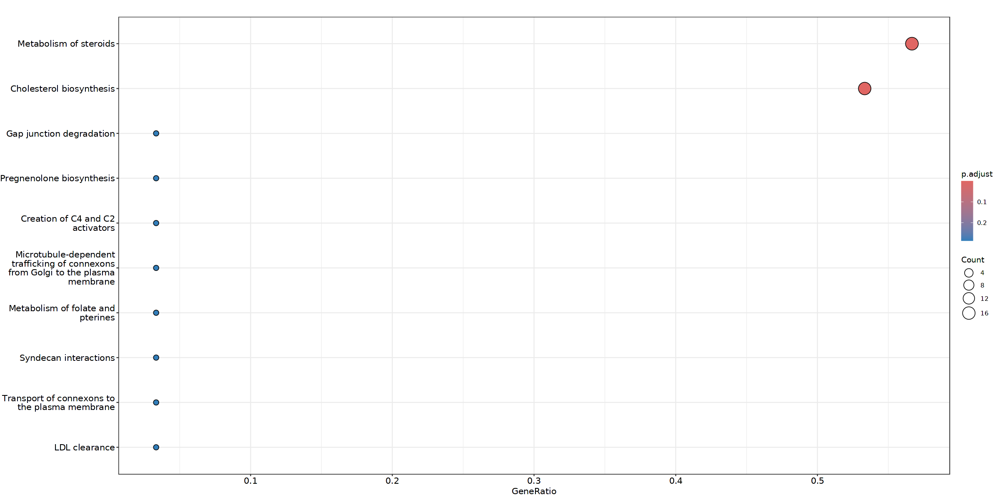

In [956]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [957]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

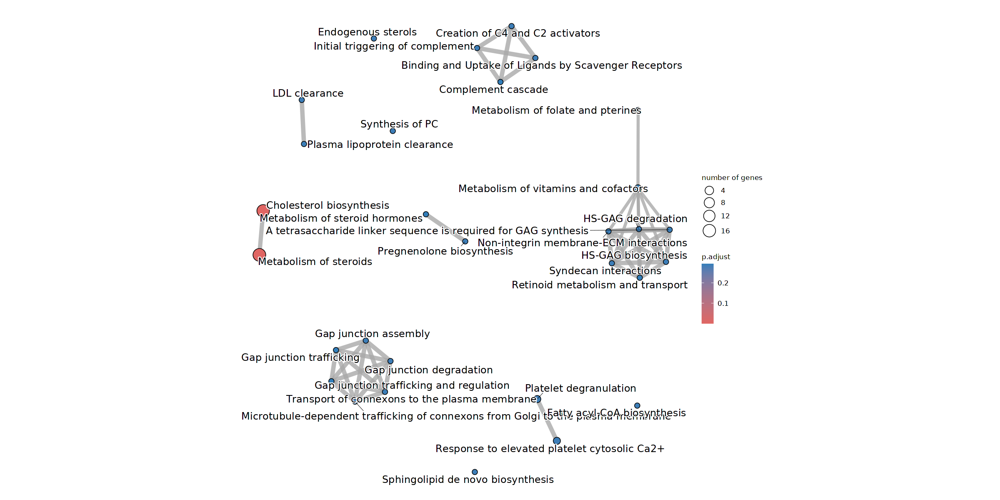

In [958]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 5

In [959]:
highest_cat <- "Early"
second_highest_cat <- "Peak"

In [960]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [961]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [962]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [963]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [964]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [965]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [966]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [967]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [968]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [969]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [970]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [971]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:50] "15953" "69550" "20296" "16859" "24110" "12051" "55932" "23962" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...5 enriched terms found
'data.frame':	5 obs. of  9 variables:
 $ ID         : chr  "R-MMU-913531" "R-MMU-1169408" "R-MMU-909733" "R-MMU-1280215" ...
 $ Description: chr  "Interferon Signaling" "ISG15 antiviral mechanism" "Interferon alpha/beta signaling" "Cytokine Signaling in Immune system" ...
 $ GeneRatio  : chr  "5/21" "3/21" "3/21" "7/21" ...
 $ BgRatio    : chr  "131/8582" "28/8582" "29/8582" "447/8582" ...
 $ pvalue     : num  1.28e-05 3.98e-05 4.43e-05 6.10e-05 1.34e-03
 $ p.adjust   : num  0.00221 0.00254 0.00254 0.00262 0.04595
 $ qvalue     : num  0.00188 0.00216 0.00216 0.00223 0.03909
 $ geneID     : chr  "Usp18/Isg15/Socs3/Irf9/Eif2ak2" "Usp18/Isg15/Eif2ak2" "Usp18/Socs3/Irf9" "Usp18/Psmb8/Isg15/Il1r1/Socs3/Irf9/Eif2ak2" ...
 $ 

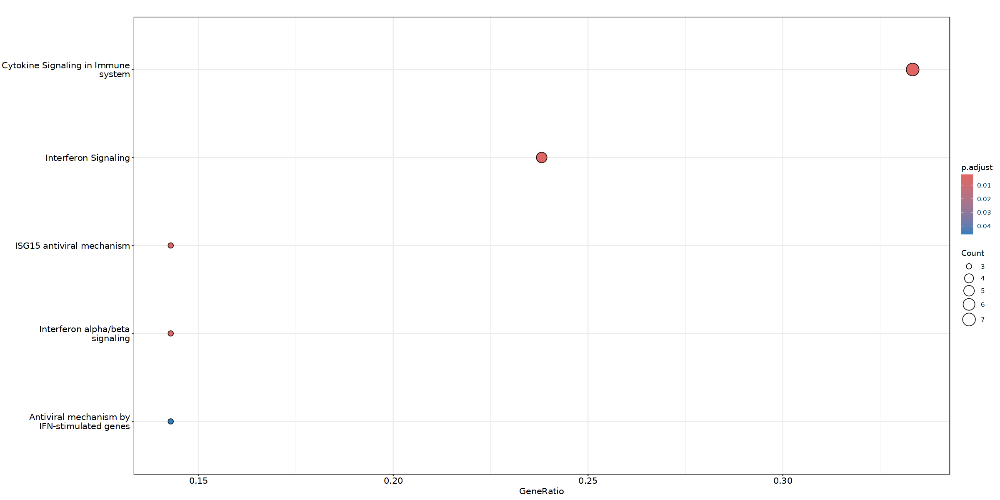

In [972]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [973]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

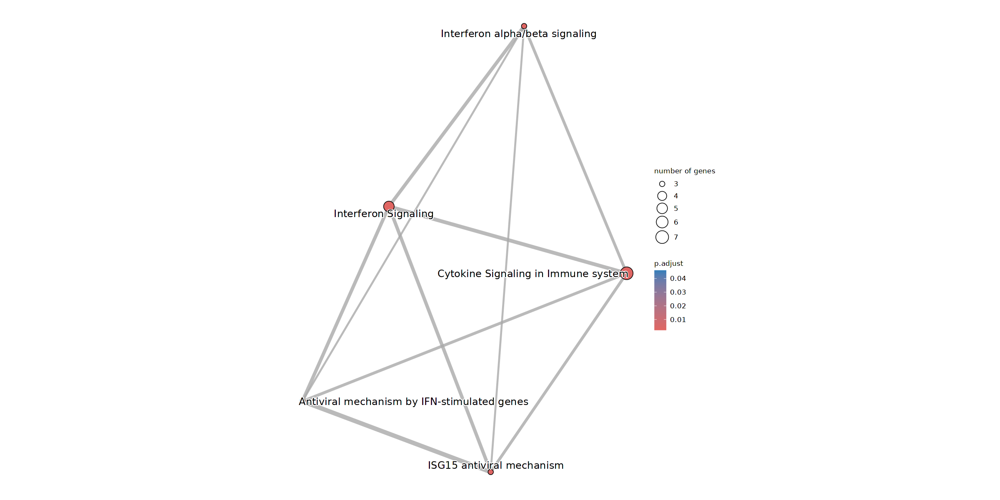

In [974]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [975]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [976]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:50] "15953" "69550" "20296" "16859" "24110" "12051" "55932" "23962" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...172 enriched terms found
'data.frame':	172 obs. of  9 variables:
 $ ID         : chr  "R-MMU-913531" "R-MMU-1169408" "R-MMU-909733" "R-MMU-1280215" ...
 $ Description: chr  "Interferon Signaling" "ISG15 antiviral mechanism" "Interferon alpha/beta signaling" "Cytokine Signaling in Immune system" ...
 $ GeneRatio  : chr  "5/21" "3/21" "3/21" "7/21" ...
 $ BgRatio    : chr  "131/8582" "28/8582" "29/8582" "447/8582" ...
 $ pvalue     : num  1.28e-05 3.98e-05 4.43e-05 6.10e-05 1.34e-03 ...
 $ p.adjust   : num  0.00221 0.00254 0.00254 0.00262 0.04595 ...
 $ qvalue     : num  0.00188 0.00216 0.00216 0.00223 0.03909 ...
 $ geneID     : chr  "Usp18/Isg15/Socs3/Irf9/Eif2ak2" "Usp18/Isg15/Eif2ak2" "Usp18/Socs3/Irf9" "Usp18/Psmb8/Isg15/Il1r1/Socs3/Irf9/Eif

In [977]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

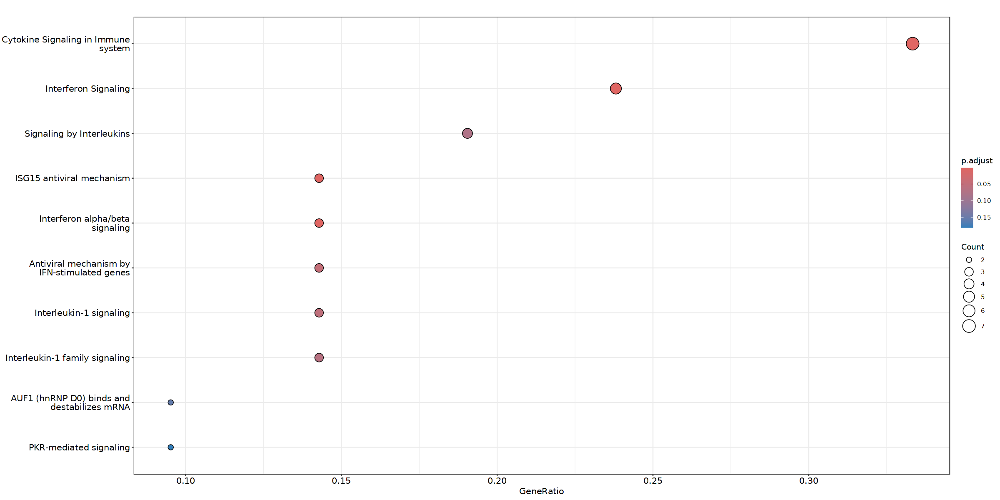

In [978]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [979]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 7 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


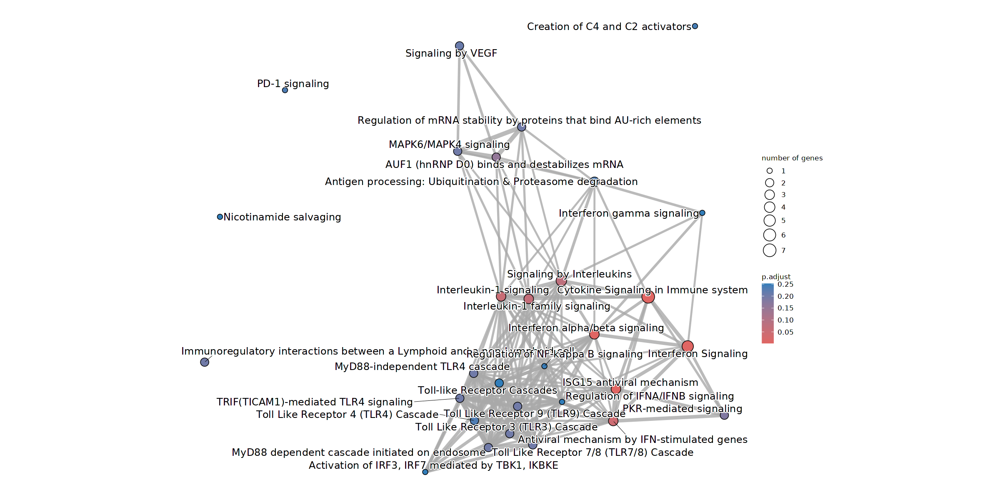

In [980]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 6

In [981]:
highest_cat <- "Early"
second_highest_cat <- "Late"

In [982]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [983]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [984]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [985]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [986]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [987]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [988]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [989]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [990]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [991]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [992]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [993]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:15] "19713" "14799" "16477" "14156" "67492" "21808" "76257" "14281" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [994]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [995]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:15] "19713" "14799" "16477" "14156" "67492" "21808" "76257" "14281" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...74 enriched terms found
'data.frame':	74 obs. of  9 variables:
 $ ID         : chr  "R-MMU-5173214" "R-MMU-5173105" "R-MMU-450341" "R-MMU-83936" ...
 $ Description: chr  "O-glycosylation of TSR domain-containing proteins" "O-linked glycosylation" "Activation of the AP-1 family of transcription factors" "Transport of nucleosides and free purine and pyrimidine bases across the plasma membrane" ...
 $ GeneRatio  : chr  "2/11" "2/11" "1/11" "1/11" ...
 $ BgRatio    : chr  "33/8582" "97/8582" "10/8582" "11/8582" ...
 $ pvalue     : num  0.000772 0.006508 0.01275 0.014017 0.01907 ...
 $ p.adjust   : num  0.0571 0.1573 0.1573 0.1573 0.1573 ...
 $ qvalue     : num  0.0414 0.1141 0.1141 0.1141 0.1141 ...
 $ geneID     : chr  "Adamtsl3/Adamts5" "Adamtsl3

In [996]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

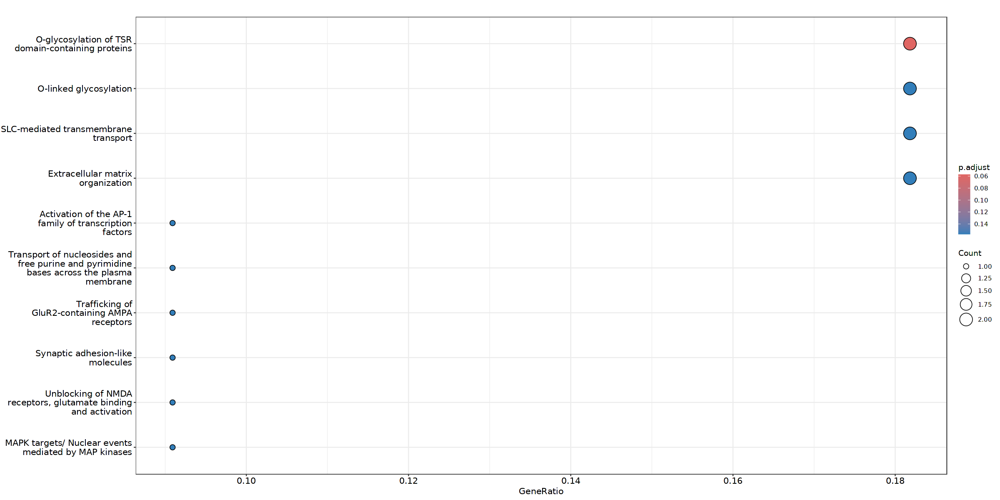

In [997]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [998]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

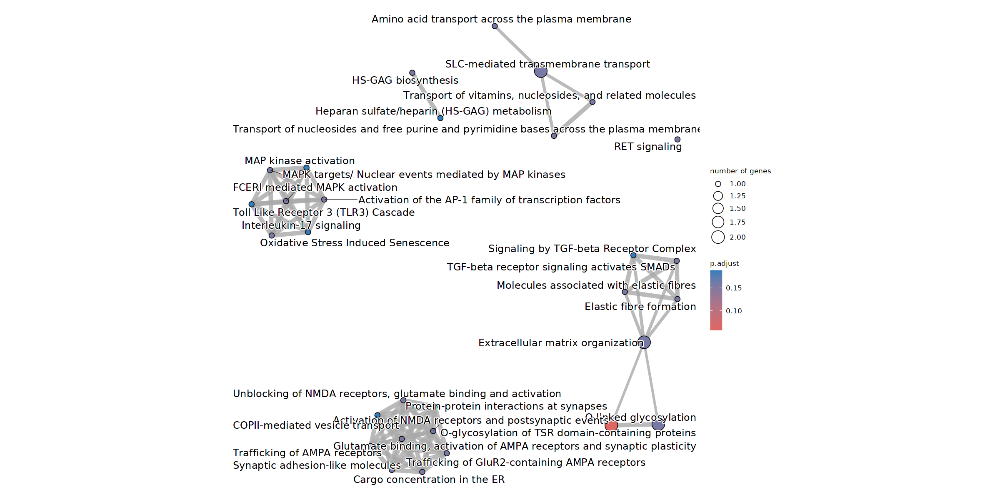

In [999]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 7

In [1000]:
highest_cat <- "Peak"
second_highest_cat <- "Ctrl"

In [1001]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [1002]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [1003]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [1004]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [1005]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [1006]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [1007]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [1008]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [1009]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [1010]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [1011]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [1012]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:7] "64929" "192136" "107993" "13867" "227058" "76633" "218454"
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...14 enriched terms found
'data.frame':	14 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8847993" "R-MMU-1358803" "R-MMU-6785631" "R-MMU-1963642" ...
 $ Description: chr  "ERBB2 Activates PTK6 Signaling" "Downregulation of ERBB2:ERBB3 signaling" "ERBB2 Regulates Cell Motility" "PI3K events in ERBB2 signaling" ...
 $ GeneRatio  : chr  "1/2" "1/2" "1/2" "1/2" ...
 $ BgRatio    : chr  "11/8582" "12/8582" "13/8582" "14/8582" ...
 $ pvalue     : num  0.00256 0.00279 0.00303 0.00326 0.00349 ...
 $ p.adjust   : num  0.0154 0.0154 0.0154 0.0154 0.0154 ...
 $ qvalue     : num  0.00588 0.00588 0.00588 0.00588 0.00588 ...
 $ geneID     : chr  "Erbb3" "Erbb3" "Erbb3" "Erbb3" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Y

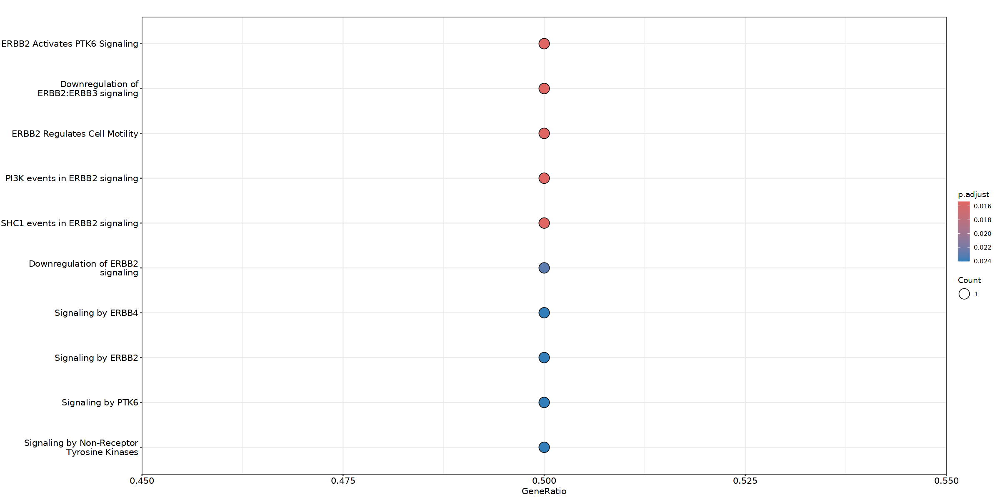

In [1013]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [1014]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

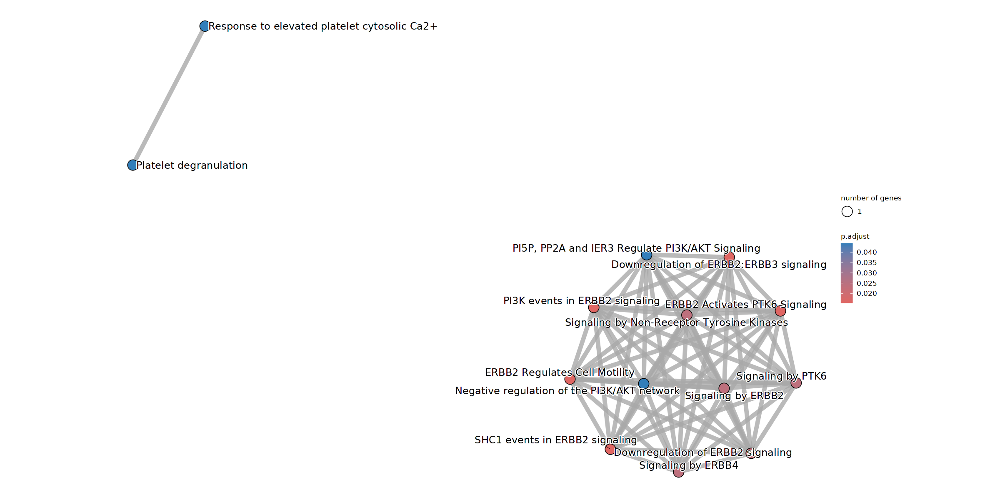

In [1015]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [1016]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [1017]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:7] "64929" "192136" "107993" "13867" "227058" "76633" "218454"
#...pvalues adjusted by 'fdr' with cutoff <1 
#...22 enriched terms found
'data.frame':	22 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8847993" "R-MMU-1358803" "R-MMU-6785631" "R-MMU-1963642" ...
 $ Description: chr  "ERBB2 Activates PTK6 Signaling" "Downregulation of ERBB2:ERBB3 signaling" "ERBB2 Regulates Cell Motility" "PI3K events in ERBB2 signaling" ...
 $ GeneRatio  : chr  "1/2" "1/2" "1/2" "1/2" ...
 $ BgRatio    : chr  "11/8582" "12/8582" "13/8582" "14/8582" ...
 $ pvalue     : num  0.00256 0.00279 0.00303 0.00326 0.00349 ...
 $ p.adjust   : num  0.0154 0.0154 0.0154 0.0154 0.0154 ...
 $ qvalue     : num  0.00588 0.00588 0.00588 0.00588 0.00588 ...
 $ geneID     : chr  "Erbb3" "Erbb3" "Erbb3" "Erbb3" ...
 $ Count      : int  1 1 1 1 1 1 1 1 1 1 ...
#...Citation
  Guangchuang Yu, Qing-Yu H

In [1018]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

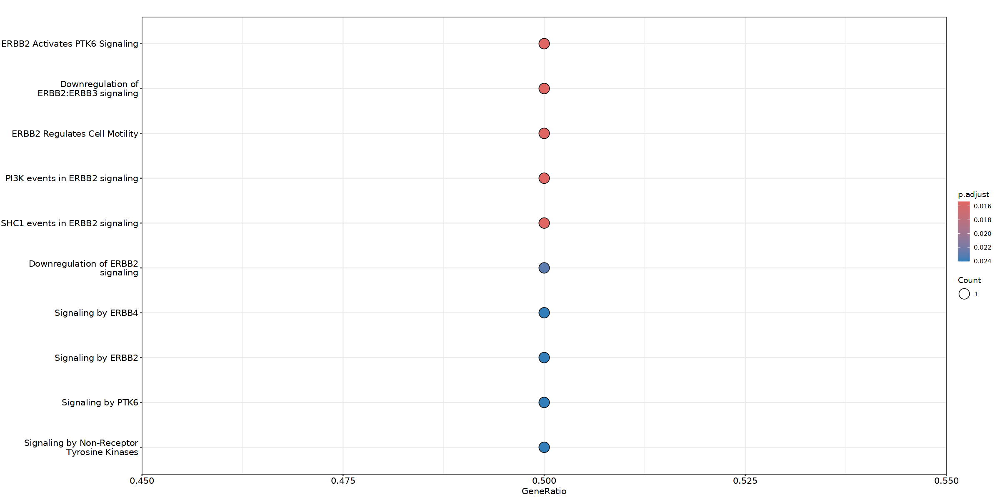

In [1019]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [1020]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

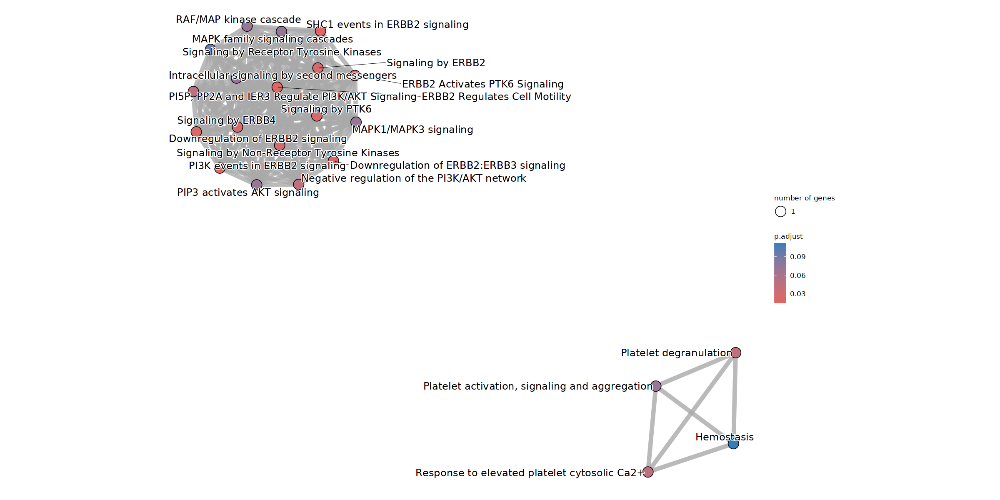

In [1021]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 8

In [1022]:
highest_cat <- "Peak"
second_highest_cat <- "Early"

In [1023]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [1024]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [1025]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [1026]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [1027]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [1028]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [1029]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [1030]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [1031]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [1032]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [1033]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [1034]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:44] "240328" "14469" "225594" "14960" "60440" "15900" "110454" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [1035]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [1036]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:44] "240328" "14469" "225594" "14960" "60440" "15900" "110454" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...174 enriched terms found
'data.frame':	174 obs. of  9 variables:
 $ ID         : chr  "R-MMU-140837" "R-MMU-114608" "R-MMU-76005" "R-MMU-109582" ...
 $ Description: chr  "Intrinsic Pathway of Fibrin Clot Formation" "Platelet degranulation" "Response to elevated platelet cytosolic Ca2+" "Hemostasis" ...
 $ GeneRatio  : chr  "2/17" "3/17" "3/17" "5/17" ...
 $ BgRatio    : chr  "21/8582" "117/8582" "122/8582" "492/8582" ...
 $ pvalue     : num  0.000759 0.001461 0.001648 0.002111 0.002237 ...
 $ p.adjust   : num  0.0778 0.0778 0.0778 0.0778 0.0778 ...
 $ qvalue     : num  0.0702 0.0702 0.0702 0.0702 0.0702 ...
 $ geneID     : chr  "Serping1/A2m" "Serping1/Serpina3i/A2m" "Serping1/Serpina3i/A2m" "Serping1/Serpina3i/Cd74/A2m/Cd44" ...
 $ Count      : int

In [1037]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

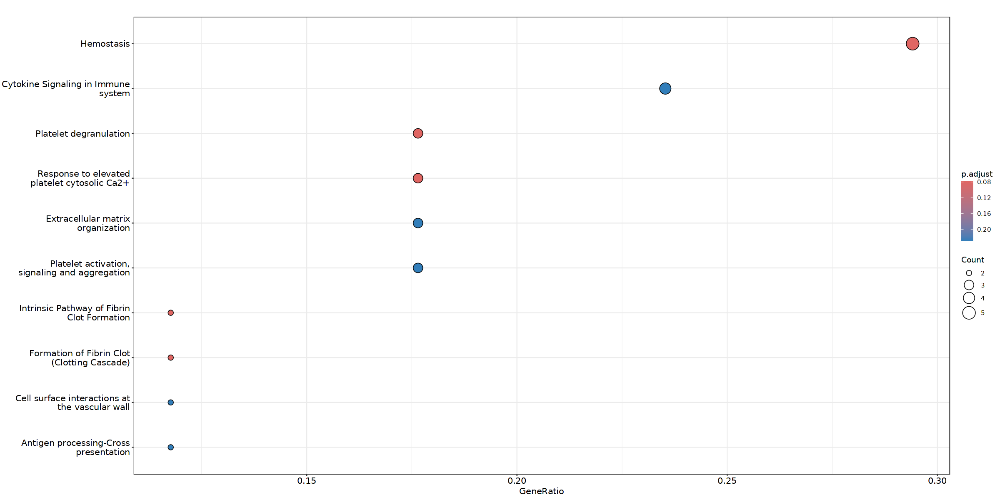

In [1038]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [1039]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

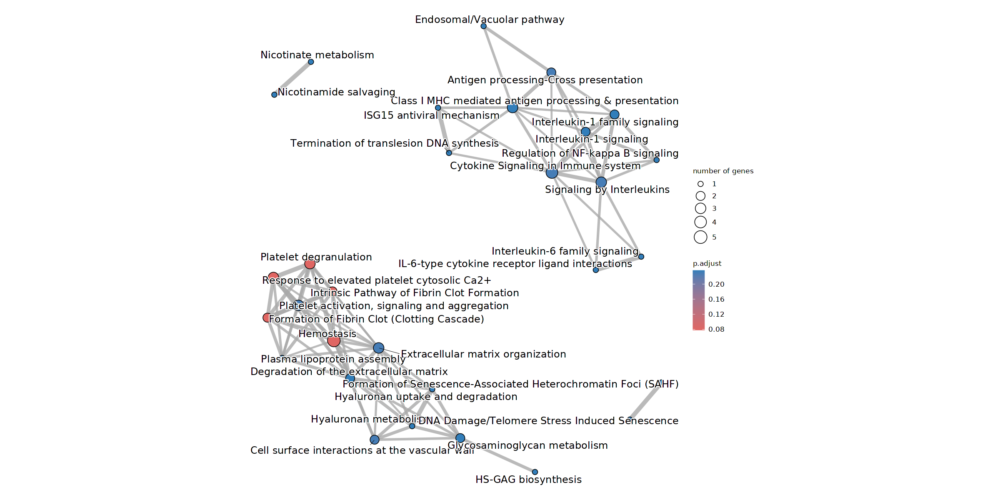

In [1040]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 9

In [1041]:
highest_cat <- "Peak"
second_highest_cat <- "Late"

In [1042]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [1043]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [1044]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [1045]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [1046]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [1047]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [1048]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [1049]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [1050]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [1051]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [1052]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [1053]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:42] "110557" "236573" "245240" "15018" "59012" "12363" "243864" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...8 enriched terms found
'data.frame':	8 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8963898" "R-MMU-1236977" "R-MMU-1236974" "R-MMU-983170" ...
 $ Description: chr  "Plasma lipoprotein assembly" "Endosomal/Vacuolar pathway" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "2/15" "2/15" "2/15" "2/15" ...
 $ BgRatio    : chr  "19/8582" "24/8582" "33/8582" "40/8582" ...
 $ pvalue     : num  0.000479 0.00077 0.001459 0.002141 0.002703 ...
 $ p.adjust   : num  0.0273 0.0273 0.0345 0.038 0.0384 ...
 $ qvalue     : num  0.0166 0.0166 0.021 0.0231 0.0233 ...
 $ geneID     : chr  "Bmp1/Abca1" "H2-Q6/H2-Q7" "H2-Q6/H2-Q7" "H2-Q6/H2-Q7" ...
 $ Count      : int  2 2 2 2 2 2 2 2


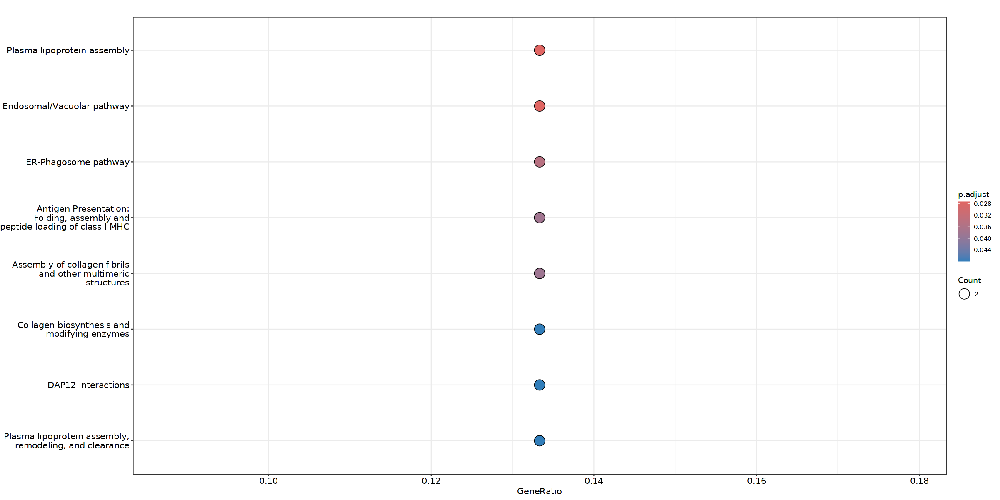

In [1054]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [1055]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

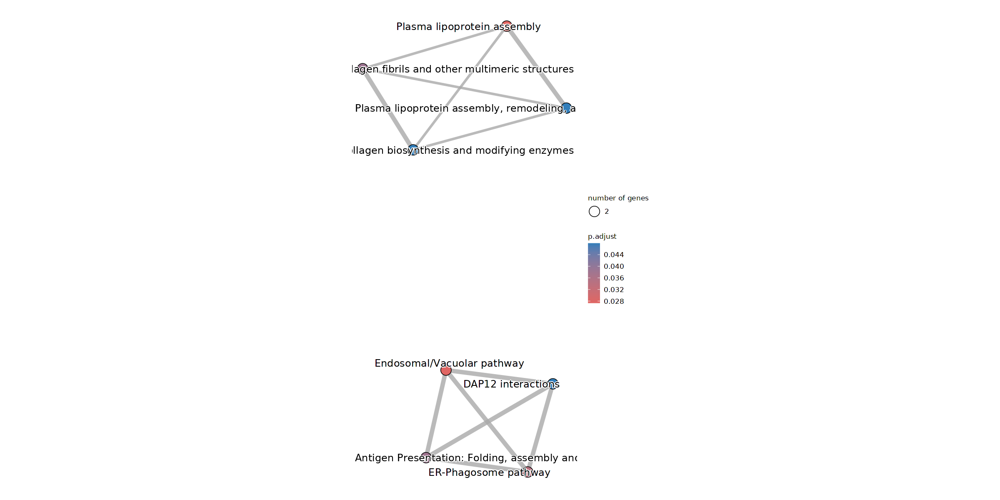

In [1056]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [1057]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [1058]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:42] "110557" "236573" "245240" "15018" "59012" "12363" "243864" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...71 enriched terms found
'data.frame':	71 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8963898" "R-MMU-1236977" "R-MMU-1236974" "R-MMU-983170" ...
 $ Description: chr  "Plasma lipoprotein assembly" "Endosomal/Vacuolar pathway" "ER-Phagosome pathway" "Antigen Presentation: Folding, assembly and peptide loading of class I MHC" ...
 $ GeneRatio  : chr  "2/15" "2/15" "2/15" "2/15" ...
 $ BgRatio    : chr  "19/8582" "24/8582" "33/8582" "40/8582" ...
 $ pvalue     : num  0.000479 0.00077 0.001459 0.002141 0.002703 ...
 $ p.adjust   : num  0.0273 0.0273 0.0345 0.038 0.0384 ...
 $ qvalue     : num  0.0166 0.0166 0.021 0.0231 0.0233 ...
 $ geneID     : chr  "Bmp1/Abca1" "H2-Q6/H2-Q7" "H2-Q6/H2-Q7" "H2-Q6/H2-Q7" ...
 $ Count      : int  2 2 2 2 2 2 2 2 2

In [1059]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

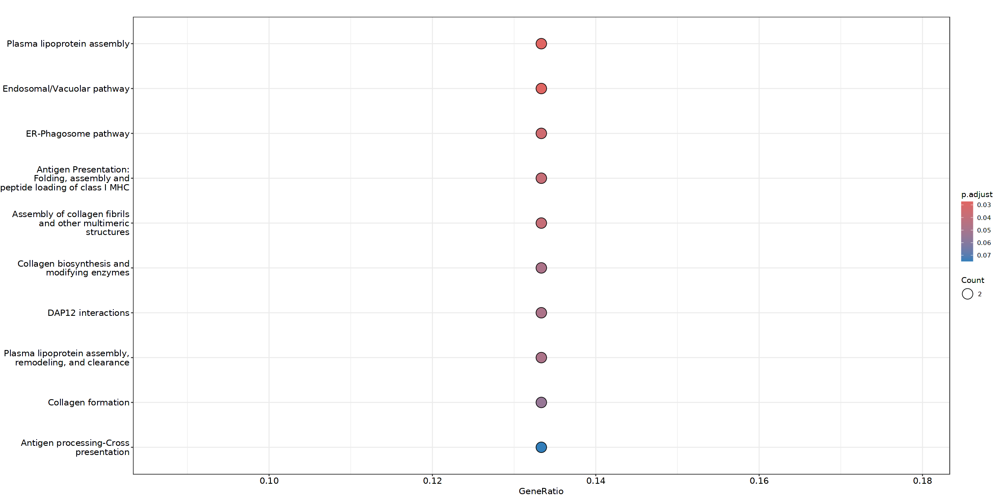

In [1060]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [1061]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

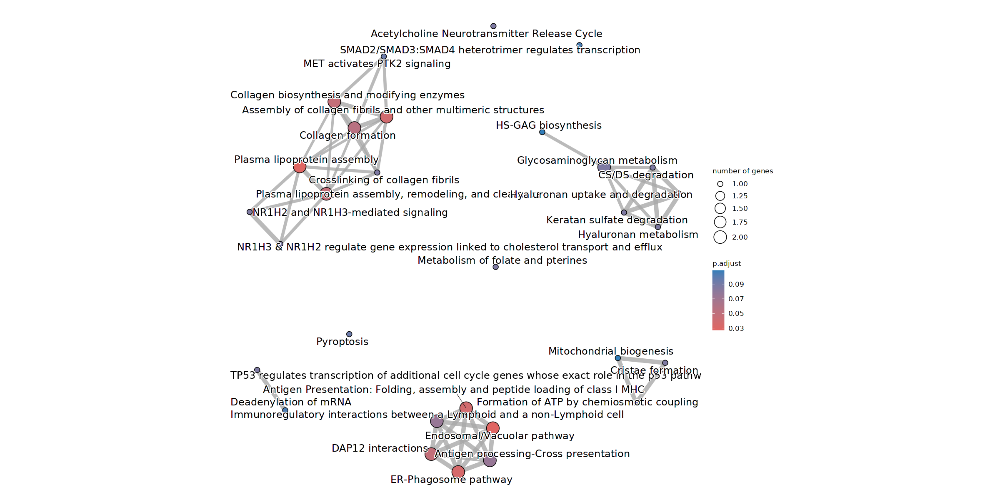

In [1062]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 10

In [1063]:
highest_cat <- "Late"
second_highest_cat <- "Ctrl"

In [1064]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [1065]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [1066]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [1067]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [1068]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [1069]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [1070]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [1071]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [1072]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [1073]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [1074]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [1075]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:26] "22065" "242425" "72080" "11307" "12561" "232560" "16449" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [1076]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [1077]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:26] "22065" "242425" "72080" "11307" "12561" "232560" "16449" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...63 enriched terms found
'data.frame':	63 obs. of  9 variables:
 $ ID         : chr  "R-MMU-8964058" "R-MMU-264870" "R-MMU-139853" "R-MMU-112314" ...
 $ Description: chr  "HDL remodeling" "Caspase-mediated cleavage of cytoskeletal proteins" "Elevation of cytosolic Ca2+ levels" "Neurotransmitter receptors and postsynaptic signal transmission" ...
 $ GeneRatio  : chr  "1/14" "1/14" "1/14" "2/14" ...
 $ BgRatio    : chr  "10/8582" "11/8582" "12/8582" "138/8582" ...
 $ pvalue     : num  0.0162 0.0178 0.0194 0.0206 0.0226 ...
 $ p.adjust   : num  0.134 0.134 0.134 0.134 0.134 ...
 $ qvalue     : num  0.0897 0.0897 0.0897 0.0897 0.0897 ...
 $ geneID     : chr  "Abcg1" "Gas2" "Trpc3" "Gabbr2/Grip1" ...
 $ Count      : int  1 1 1 2 1 1 1 1 1 1 ...
#...Citatio

In [1078]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

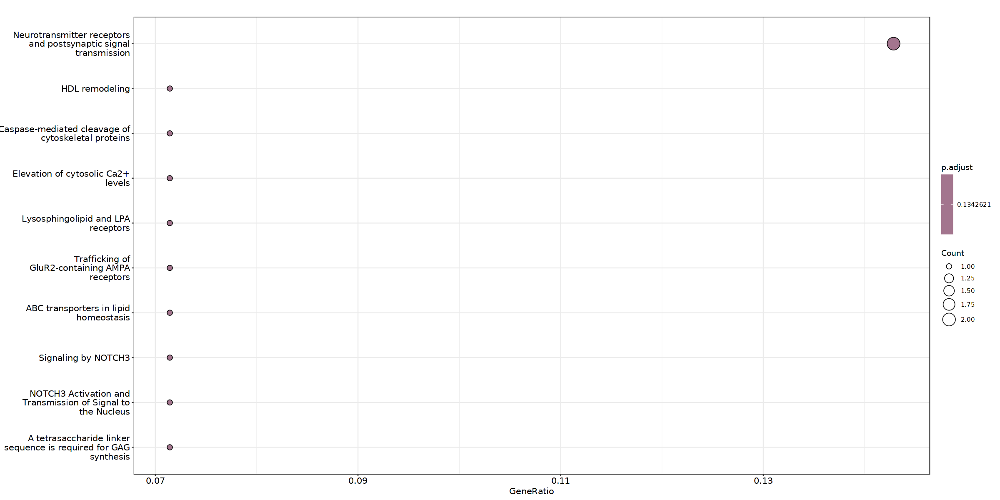

In [1079]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [1080]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

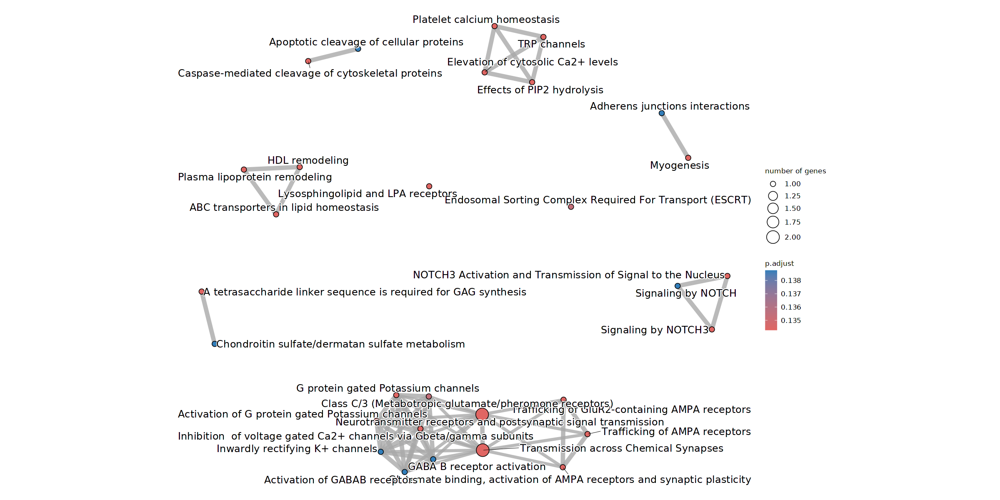

In [1081]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 11

In [1082]:
highest_cat <- "Late"
second_highest_cat <- "Early"

In [1083]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [1084]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [1085]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [1086]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [1087]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [1088]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [1089]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [1090]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [1091]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [1092]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [1093]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [1094]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:9] "117148" "243764" "270049" "320701" "11682" "432530" "243961" ...
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...0 enriched terms found
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [1095]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [1096]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:9] "117148" "243764" "270049" "320701" "11682" "432530" "243961" ...
#...pvalues adjusted by 'fdr' with cutoff <1 
#...39 enriched terms found
'data.frame':	39 obs. of  9 variables:
 $ ID         : chr  "R-MMU-399955" "R-MMU-170670" "R-MMU-399954" "R-MMU-399956" ...
 $ Description: chr  "SEMA3A-Plexin repulsion signaling by inhibiting Integrin adhesion" "Adenylate cyclase inhibitory pathway" "Sema3A PAK dependent Axon repulsion" "CRMPs in Sema3A signaling" ...
 $ GeneRatio  : chr  "1/6" "1/6" "1/6" "1/6" ...
 $ BgRatio    : chr  "10/8582" "13/8582" "14/8582" "15/8582" ...
 $ pvalue     : num  0.00697 0.00906 0.00975 0.01044 0.01114 ...
 $ p.adjust   : num  0.0566 0.0566 0.0566 0.0566 0.0566 ...
 $ qvalue     : num  0.0214 0.0214 0.0214 0.0214 0.0214 ...
 $ geneID     : chr  "Plxna4" "Adcy1" "Plxna4" "Plxna4" ...
 $ Count      : int  1 1 1 1 1 1 1 2 1 1 ...
#...Cit

In [1097]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

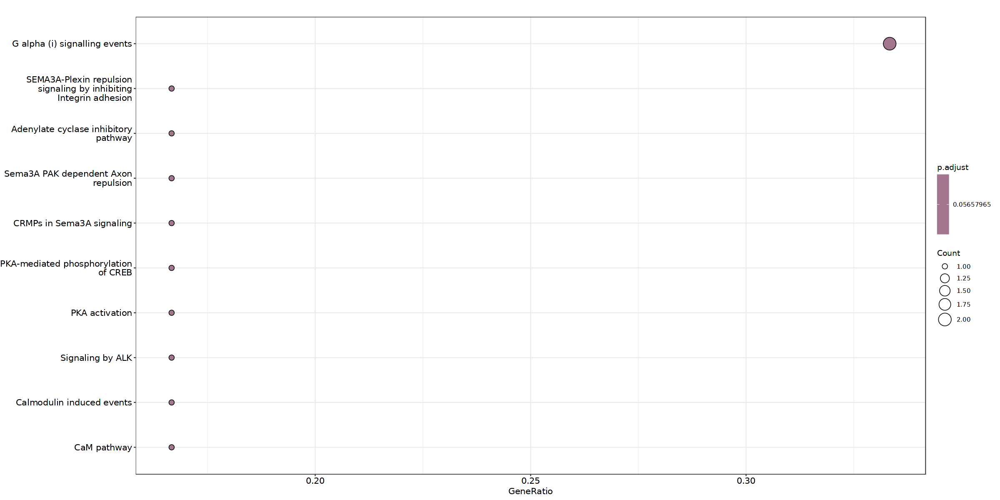

In [1098]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [1099]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

Warning message:
"ggrepel: 5 unlabeled data points (too many overlaps). Consider increasing max.overlaps"


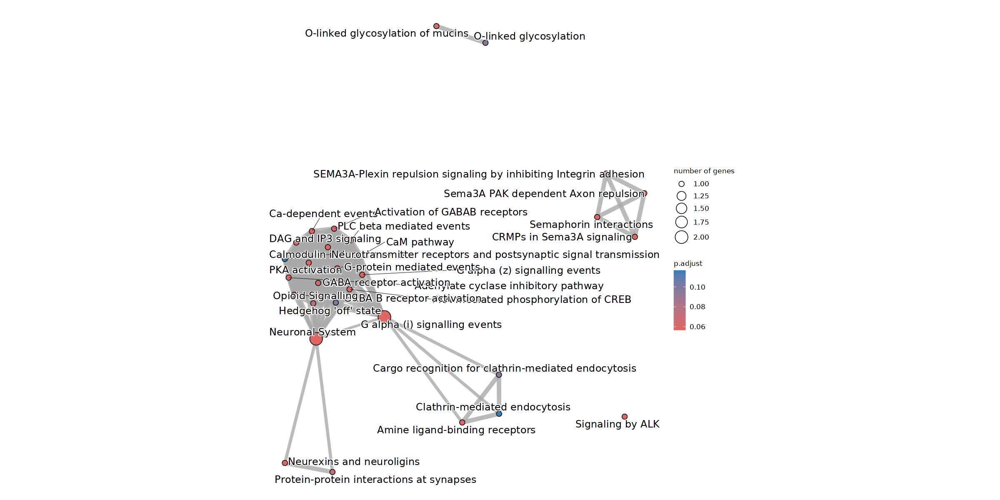

In [1100]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

##### Sub category 12

In [1101]:
highest_cat <- "Late"
second_highest_cat <- "Peak"

In [1102]:
gene_list <- rownames(df_dynamics_scaled[df_dynamics_scaled[,highest_cat, drop=FALSE] == 1,])

In [1103]:
no_highest_cat <- names(orig.ident_merge_colors)[names(orig.ident_merge_colors) != highest_cat]

In [1104]:
index_second_highest_cat <- match(second_highest_cat, no_highest_cat)

In [1105]:
gene_list <- rownames(subset(df_dynamics_scaled[gene_list,no_highest_cat], max.col(df_dynamics_scaled[gene_list,no_highest_cat], 'first') == index_second_highest_cat))

In [1106]:
top_DEG <- apply(df_dynamics_scaled[gene_list,],1,function(x){max(x)-min(x)})

In [1107]:
if(length(top_DEG)>threshold_nb_genes){
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)][1:threshold_nb_genes]
} else{
    top_DEG_filtered <- top_DEG[order(top_DEG, decreasing=TRUE)]
}

In [1108]:
top_DEG_filtered_names <- names(top_DEG_filtered)

In [1109]:
entrezmatched <- entrezID[match(top_DEG_filtered_names,entrezID$mgi_symbol),]

In [1110]:
entrezmatched_filtered <- entrezmatched[! apply(entrezmatched[,c(1,3)], 1,function (y) anyNA(y)),]

In [1111]:
allLLIDs <- entrezmatched_filtered$entrezgene

In [1112]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=0.05, qvalueCutoff = 0.05, pAdjustMethod = "fdr", readable=T)

In [1113]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:7] "68027" "13193" "77065" "50720" "68617" "320174" "13048"
#...pvalues adjusted by 'fdr' with cutoff <0.05 
#...1 enriched terms found
'data.frame':	1 obs. of  9 variables:
 $ ID         : chr "R-MMU-6807505"
 $ Description: chr "RNA polymerase II transcribes snRNA genes"
 $ GeneRatio  : chr "1/1"
 $ BgRatio    : chr "71/8582"
 $ pvalue     : num 0.00827
 $ p.adjust   : num 0.00827
 $ qvalue     : logi NA
 $ geneID     : chr "Ints7"
 $ Count      : int 1
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


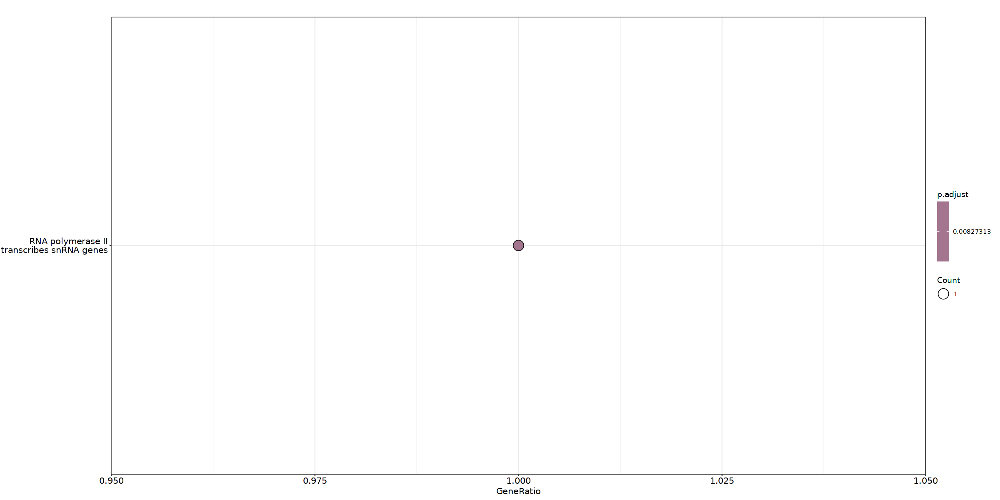

In [1114]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [1115]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

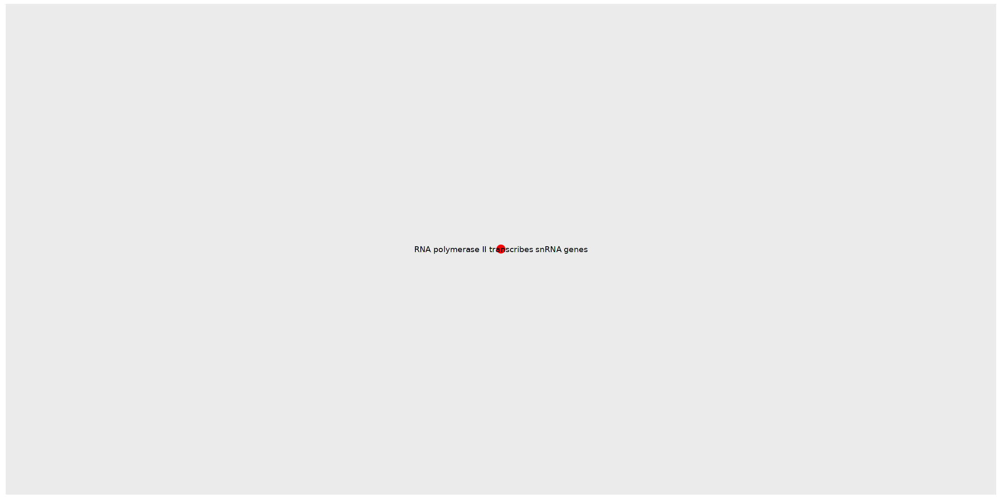

In [1116]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)

In [1117]:
modulesReactome <- enrichPathway(allLLIDs,organism="mouse", pvalueCutoff=1, qvalueCutoff = 1, pAdjustMethod = "fdr", readable=T)

In [1118]:
modulesReactome

#
# over-representation test
#
#...@organism 	 mouse 
#...@ontology 	 Reactome 
#...@keytype 	 ENTREZID 
#...@gene 	 chr [1:7] "68027" "13193" "77065" "50720" "68617" "320174" "13048"
#...pvalues adjusted by 'fdr' with cutoff <1 
#...1 enriched terms found
'data.frame':	1 obs. of  9 variables:
 $ ID         : chr "R-MMU-6807505"
 $ Description: chr "RNA polymerase II transcribes snRNA genes"
 $ GeneRatio  : chr "1/1"
 $ BgRatio    : chr "71/8582"
 $ pvalue     : num 0.00827
 $ p.adjust   : num 0.00827
 $ qvalue     : logi NA
 $ geneID     : chr "Ints7"
 $ Count      : int 1
#...Citation
  Guangchuang Yu, Qing-Yu He. ReactomePA: an R/Bioconductor package for
  reactome pathway analysis and visualization. Molecular BioSystems
  2016, 12(2):477-479 


In [1119]:
write.csv(as.data.frame(modulesReactome), paste0(OS_path_outputs, "GO_DGE_RNA_OPC_",highest_cat,"_",second_highest_cat,".csv"), row.names=FALSE)

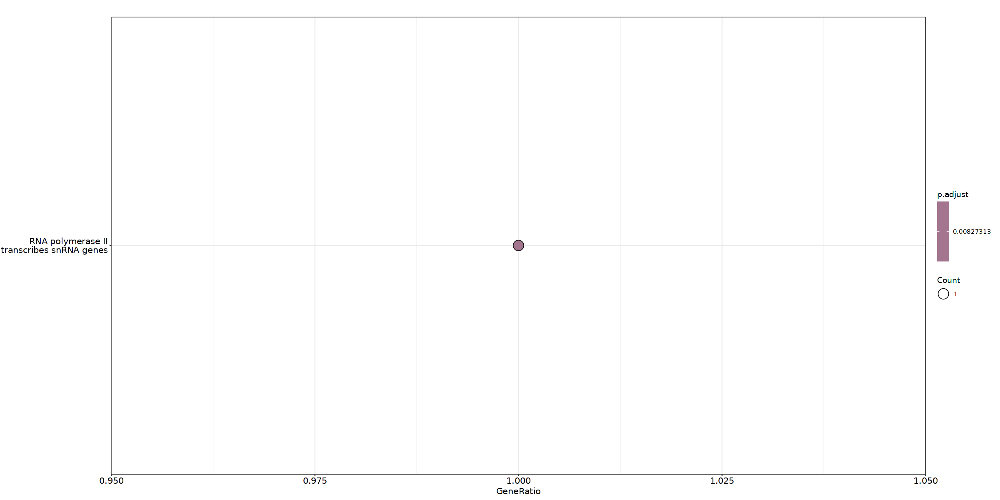

In [1120]:
options(repr.plot.width=20, repr.plot.height=10)
dotplot(modulesReactome, showCategory=10, orderBy="GeneRatio")

In [1121]:
modulesReactome <- pairwise_termsim(modulesReactome, method = "JC", semData = NULL, showCategory = 50)

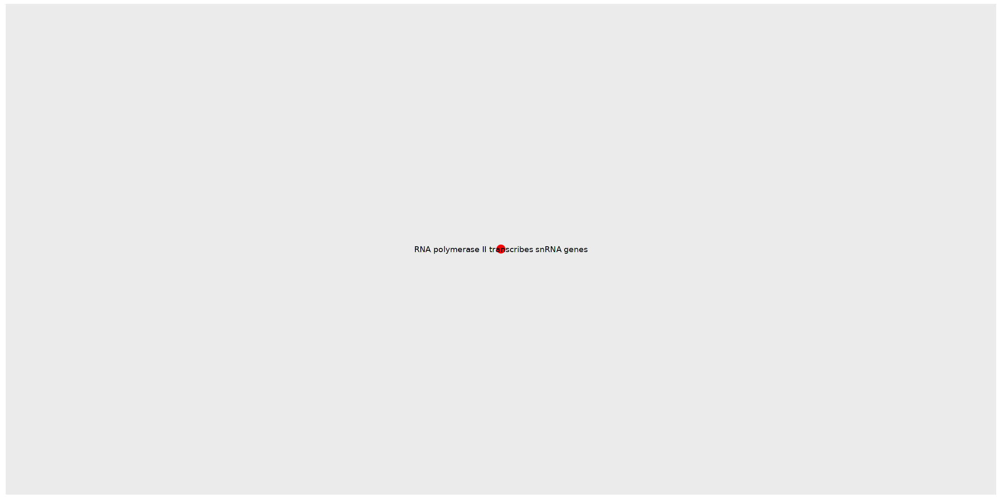

In [1122]:
options(repr.plot.width=20, repr.plot.height=10)
emapplot(modulesReactome)